## Pasos del proyecto

1. Elegir temática
    1. **Elegir una temática y buscar datos en función de la misma**. Es algo más complejo que la segunda opción ya que puede ocurrir que no encuentres datos que te sirvan para tu propósito, o que tengas que conseguirlos mediante APIs, scrapping, descarga de BBDD.... No obstante, esta opción es la que más se asemejaría a un caso real, ya que una gran problemática en este tipo de proyectos es encontrar datos.

    2. **Directamente ir a páginas de datos abiertos y escoger un dataset de tu interés**. Si no tienes clara la temática puedes buscar en alguno de los enlaces de datos (recomendable Kaggle) y escoger un tema que te motive.


La tematica será relacionada con las platas solares fotovoltaicas.

Me gustaría conocer si los paises europeos que apuestan por está energía renovable es unicamente por la irradiancia solar que reciben o si hay algún parámetro más que afecte.

He buscando en las siguientes plataformas que datos hay disponibles para europa:

- https://datacommons.org/
    - Poblacion total
    - Esperanza de vida
    - Personas desempleadas
    - Nivel de educación
    - Generación anual de energía solar
    - Capacidad instalada de energía solar
    - Flujo financiero de apoyo a la energía solar
    - Precipitación media
    - Superficie país
- https://datacatalog.worldbank.org
    - Irradiancia solar



2. Obtención de datos. ¿Puedes llevar a cabo el proyecto con estos datos?

De momento espero que los datos sean suficientes. En caso de necesidad, volvería a buscar más información.

3. Define tu hipótesis. ¿Qué piensas que puedes obtener de estos datos? ¿Qué vas a poder resolver? ¿Cómo lo vas a llevar a cabo?

- ¿Qué características tiene un país europeo que apuesta por la energía solar fotovoltaica?
- ¿Dependerá del tipo de población?
    - Habitantes / km2
    - Nivel de educación
    - Esperanza de vida
    - Actividad profesional 
- ¿Dependerá del clima?
    - Precipitaciones medias
- ¿Dependerá de la superficie del país?
    - Superficie km2
    - Superficie verde
- ¿Dependen exclusivamente de la irradiación horizontal global (GHI)? – información de contraste para los 10 países con mayor capacidad de producción


4. Preprocesado: obtén todos los datos de las diferentes fuentes que hayas utilizado, juntalos y ponlos en un formato entendible.

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


#### Hipótesis de comprobación

Los primeros datos que voy a tratar son los más relevantes para la obtención de las preguntas generadas.
Esta información debe estar alineadada con la capacidad productiva y generada del país. 



In [3]:

# Ruta corregida
file_path = "./data/solargis_pvpotential_countryranking_2020_data.xlsx"
# Cargar el archivo Excel
df_ = pd.read_excel(file_path, header=1)



In [4]:
#Quito las columnas que creo que no interesan:
df_.drop(columns=["ISO_A3", "Note", "World Bank \nRegion", "Evaluated area"], inplace=True)
df_.head(3)


,Country or region,"Total population, 2018","Total area, 2018",Level 1 area \n(% of evaluated area),"Human development \nIndex, 2017","Gross domestic product (USD per capita), 2018","Average theoretical potential (GHI, kWh/m2/day), \nlong-term","Average practical potential \n(PVOUT Level 1, \nkWh/kWp/day), long-term","Average economic potential (LCOE, USD/kWh), 2018","Average PV \nseasonality index, long-term","PV equivalent area (% of total area), long-term","Cummulative installed PV capacity (MWp), 2018","Cummulative installed PV capacity (Wp per capita), 2018","Access to electricity\n(% of rural population), 2016","Electric power consumption (kWh per capita), 2014","Reliability of supply and transparency of tariff index, 2019","Approximate electricity \nTariffs for SMEs \n(US cent/kWh), 2019"
0,Aruba (Neth.),105845,180.0,0.847926,NaN,25630.266492,6.1098,4.9646,0.0853,1.1803,NaN,6.1,57.631442,92.452844,NaN,NaN,NaN
1,Afghanistan,37172386,652860.0,0.587350,0.497695,520.896603,5.4904,5.0159,0.0851,1.6665,NaN,22.0,0.591837,78.961074,NaN,0.0,17.6
2,Angola,30809762,1246700.0,0.751833,0.581179,3432.385736,5.7467,4.6586,0.0919,1.3211,0.003,13.4,0.434927,15.984209,312.228825,3.0,4.6


In [5]:
#Como la tabla es muy grande voy a separar por partes los indicadores
titulo =list(df_.columns)
titulo

['Country or region',
 'Total population, 2018',
 'Total area, 2018',
 'Level 1 area \n(% of evaluated area)',
 'Human development \nIndex, 2017',
 'Gross domestic product (USD per capita), 2018',
 'Average theoretical potential (GHI, kWh/m2/day), \nlong-term',
 'Average practical potential \n(PVOUT Level 1, \nkWh/kWp/day), long-term',
 'Average economic potential (LCOE, USD/kWh), 2018',
 'Average PV \nseasonality index, long-term',
 'PV equivalent area (% of total area), long-term',
 'Cummulative installed PV capacity (MWp), 2018',
 'Cummulative installed PV capacity (Wp per capita), 2018',
 'Access to electricity\n(% of rural population), 2016',
 'Electric power consumption (kWh per capita), 2014',
 'Reliability of supply and transparency of tariff index, 2019',
 'Approximate electricity \nTariffs for SMEs \n(US cent/kWh), 2019']

In [6]:
#Un slicing para facilitar el trabajo
#Parametros básicos
df_basic= df_.copy()
df_basic = df_basic.loc[:, titulo[0:6]]
df_basic
#Parametros de plantas
df_pv= df_.copy()
titulo_seleccionado = [titulo[0]] + (titulo[6:11])  #Dos listas sumadas
titulo_seleccionado
df_pv = df_pv.loc[:,titulo_seleccionado]
df_pv
#Parametros del sector
df_sector= df_.copy()
titulo_seleccionado = [titulo[0]] + (titulo[12:17])  #Dos listas sumadas
titulo_seleccionado
df_sector = df_sector.loc[:,titulo_seleccionado]
df_sector

,Country or region,"Cummulative installed PV capacity (Wp per capita), 2018","Access to electricity\n(% of rural population), 2016","Electric power consumption (kWh per capita), 2014","Reliability of supply and transparency of tariff index, 2019","Approximate electricity \nTariffs for SMEs \n(US cent/kWh), 2019"
0,Aruba (Neth.),57.631442,92.452844,NaN,NaN,NaN
1,Afghanistan,0.591837,78.961074,NaN,0.0,17.6
2,Angola,0.434927,15.984209,312.228825,3.0,4.6
3,Albania,0.348873,100.000000,2309.366503,3.0,8.7
4,Andorra,0.000000,100.000000,NaN,NaN,NaN
...,...,...,...,...,...,...
204,Kosovo,NaN,NaN,NaN,2.0,NaN
205,Republic of Yemen,5.263400,57.691162,219.799922,NaN,NaN
206,South Africa,44.285510,67.921435,4197.907047,4.0,14.8
207,Zambia,0.288154,2.657746,717.349168,4.0,4.7


In [7]:
#Estudiamos como esta la info del primer slicing, indicadores básicos
df_basic.info()
#Vamos a renombrar las columnas porque dan problemas, los caracteres raros e intros
df_basic.columns= ["Pais", "Poblacion_2018", "Area_2018", "Area_Evaluada_Porcentaje", "Desarrollo_humano_2017", "PIB_USD_2018"]
df_basic.head(2)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209 entries, 0 to 208
Data columns (total 6 columns):
 #   Column                                         Non-Null Count  Dtype  
---  ------                                         --------------  -----  
 0   Country or region                              209 non-null    object 
 1   Total population, 2018                         209 non-null    int64  
 2   Total area, 2018                               207 non-null    float64
 3   Level 1 area 
(% of evaluated area)            209 non-null    float64
 4   Human development 
Index, 2017                 185 non-null    float64
 5   Gross domestic product (USD per capita), 2018  200 non-null    float64
dtypes: float64(4), int64(1), object(1)
memory usage: 9.9+ KB


,Pais,Poblacion_2018,Area_2018,Area_Evaluada_Porcentaje,Desarrollo_humano_2017,PIB_USD_2018
0,Aruba (Neth.),105845,180.0,0.847926,NaN,25630.266492
1,Afghanistan,37172386,652860.0,0.587350,0.497695,520.896603


In [8]:
#Estudiamos como esta la info del segundo slicing, parametros de plantas
df_pv.info()
#Vamos a renombrar las columnas porque dan problemas, los caracteres raros e intros
df_pv.columns= ["Pais", "Irradiancia_Global_Horizontal", "Potencial_kWh/kWp/day", "Coste_Economico_USD/kWh_2018", "BORRAR", "Area_equivalente_PV"]
df_pv.drop(columns=["BORRAR"], inplace=True)
df_pv.head(2)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209 entries, 0 to 208
Data columns (total 6 columns):
 #   Column                                                                 Non-Null Count  Dtype  
---  ------                                                                 --------------  -----  
 0   Country or region                                                      209 non-null    object 
 1   Average theoretical potential (GHI, kWh/m2/day), 
long-term            209 non-null    float64
 2   Average practical potential 
(PVOUT Level 1, 
kWh/kWp/day), long-term  209 non-null    float64
 3   Average economic potential (LCOE, USD/kWh), 2018                       209 non-null    float64
 4   Average PV 
seasonality index, long-term                               209 non-null    float64
 5   PV equivalent area (% of total area), long-term                        135 non-null    float64
dtypes: float64(5), object(1)
memory usage: 9.9+ KB


,Pais,Irradiancia_Global_Horizontal,Potencial_kWh/kWp/day,Coste_Economico_USD/kWh_2018,Area_equivalente_PV
0,Aruba (Neth.),6.1098,4.9646,0.0853,NaN
1,Afghanistan,5.4904,5.0159,0.0851,NaN


In [9]:
#Estudiamos como esta la info del tercer slicing, Parametros del sector
df_sector.info()
#Vamos a renombrar las columnas porque dan problemas, los caracteres raros e intros
df_sector.columns= ["Pais", "Capacidad_instalada_2018", "Acceso_electricidad_rural_2016", "Consumo_kWh_per_capita_2014","borrar" ,"Tarifa_luz_USD/kWh"]
df_sector.drop(columns=["borrar"], inplace=True)
df_sector.head(2)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209 entries, 0 to 208
Data columns (total 6 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Country or region                                               209 non-null    object 
 1   Cummulative installed PV capacity (Wp per capita), 2018         203 non-null    float64
 2   Access to electricity
(% of rural population), 2016             198 non-null    float64
 3   Electric power consumption (kWh per capita), 2014               137 non-null    float64
 4   Reliability of supply and transparency of tariff index, 2019    183 non-null    float64
 5   Approximate electricity 
Tariffs for SMEs 
(US cent/kWh), 2019  182 non-null    float64
dtypes: float64(5), object(1)
memory usage: 9.9+ KB


,Pais,Capacidad_instalada_2018,Acceso_electricidad_rural_2016,Consumo_kWh_per_capita_2014,Tarifa_luz_USD/kWh
0,Aruba (Neth.),57.631442,92.452844,NaN,NaN
1,Afghanistan,0.591837,78.961074,NaN,17.6


5. Limpia los datos: duplicados, missings, columnas inútiles...

In [10]:
#El estudio le vamos a hacer sobre europa, asique voy a filtrar por paises europeos
#Compruebo un pais al azar en inglés para comprobar que machean
cond = df_sector["Pais"] == "Ukraine"
df_sector.loc[cond]


,Pais,Capacidad_instalada_2018,Acceso_electricidad_rural_2016,Consumo_kWh_per_capita_2014,Tarifa_luz_USD/kWh
193,Ukraine,44.88093,100.0,3418.585024,7.1


In [11]:
#Voy a añadir otro dataset población por pais europeo, para cruzar los paises del data set anterior que es mundial para reducir a europa
df_poblacion = pd.read_csv("./data/Europe_Country (4) - poblacion total.csv")
df_poblacion.head(5)
#Renombro los titulos
df_poblacion.columns= ["Diminutivo", "Pais", "Año","Poblacion", "Web"]
# Elimino todas las columnas excepto las de los paises
df_poblacion.drop(columns=["Diminutivo","Año","Poblacion","Web"], inplace=True)

#Tengo info duplicada de varios años, por tanto hay paises repetidos
# Elimino paises duplicados
df_paises = df_poblacion.drop_duplicates()
df_paises.head(3)



,Pais
0,Albania
5,Andorra
6,Armenia


In [12]:
#Voy a cruzar los 3 dataset sol con paises para quedarme solo con europa
df_basic_eu = pd.merge(df_paises,df_basic, on = ["Pais"])
df_basic_eu.sort_values(by = "Pais", inplace=True)
df_basic_eu.head(3)

,Pais,Poblacion_2018,Area_2018,Area_Evaluada_Porcentaje,Desarrollo_humano_2017,PIB_USD_2018
0,Albania,2866376,27400.0,0.614858,0.784911,5253.630064
1,Andorra,77006,470.0,0.110961,0.857684,42029.762737
2,Armenia,2951776,28470.0,0.694657,0.755113,4212.070943


In [13]:
df_pv_eu = pd.merge(df_paises,df_pv, on = ["Pais"])
df_pv_eu.sort_values(by = "Pais", inplace=True)
df_pv_eu.head(3)

,Pais,Irradiancia_Global_Horizontal,Potencial_kWh/kWp/day,Coste_Economico_USD/kWh_2018,Area_equivalente_PV
0,Albania,4.1954,4.0426,0.1051,0.210
1,Andorra,4.0490,4.1990,0.0986,NaN
2,Armenia,4.2241,4.1063,0.1038,0.169


In [14]:
df_sector_eu = pd.merge(df_paises,df_sector, on = ["Pais"])
#Vemos que todos tienen 100% de acceso a electricidad rural, eliminamos la columna 
df_sector_eu.drop(columns=["Acceso_electricidad_rural_2016"], inplace=True)
df_sector_eu.sort_values(by = "Pais", inplace=True)
df_sector_eu.head(3)

,Pais,Capacidad_instalada_2018,Consumo_kWh_per_capita_2014,Tarifa_luz_USD/kWh
0,Albania,0.348873,2309.366503,8.7
1,Andorra,0.000000,NaN,NaN
2,Armenia,5.860878,1961.610395,7.6


In [15]:
#Considero que estos tres dataframe están limpios.


#A los parametros basicos del pais me gustaría añadir la precipitacion media por pais
df_precipitacion_test = pd.read_csv("./data/Europe_Country (4) - precipitacion media.csv")
df_precipitacion_test
#Eliminamos las columnas que no interesan
df_precipitacion_test.drop(columns=["placeDcid","Source:Mean_Rainfall"], inplace=True)
df_precipitacion_test.columns = ["Pais","Fecha","Pp media"]
df_precipitacion_test.head(3)


,Pais,Fecha,Pp media
0,Albania,2024-06-13,0.379518
1,Albania,2024-06-14,1.065580
2,Albania,2024-06-15,0.124470


In [16]:
#Quiero quedarme con los paises europeos
df_precipitacion_eu_test = pd.merge(df_paises, df_precipitacion_test, on= ["Pais"])
df_precipitacion_eu_test.loc[df_precipitacion_eu_test["Pais"] == "Ukraine"]
#Esta información no me vale, necesito la precipitación media anual.
#Hay que buscar otra fuente.   https://data.worldbank.org/indicator/AG.LND.PRCP.MM?skipRedirection=true&view=map

,Pais,Fecha,Pp media
928,Ukraine,2024-06-13,0.632530
929,Ukraine,2024-06-14,0.945423
930,Ukraine,2024-06-15,0.784428
931,Ukraine,2024-06-16,0.450133
932,Ukraine,2024-06-17,0.110714
933,Ukraine,2024-06-18,0.222500
934,Ukraine,2024-06-19,0.232143
935,Ukraine,2024-06-20,0.170956
936,Ukraine,2024-06-21,0.250000
937,Ukraine,2024-06-22,0.312500


In [17]:
#Reintentamos con info nueva
df_precipitacion = pd.read_excel("./data/API_AG.LND.PRCP.MM_DS2_en_excel_v2_1591364.xls", sheet_name="Data", engine="xlrd", header=3)
df_precipitacion
# Nos quedamos con las columnas que nos interesan, Country y pp media de 2018
df_precipitacion = df_precipitacion.loc[:,["Country Name","2018"]]
df_precipitacion.columns = ["Pais", "Precipitacion_media_2018"]
df_precipitacion
#Cruzo con los paises de europa
df_precipitacion_eu = pd.merge(df_paises, df_precipitacion, on= ["Pais"])
df_precipitacion_eu.head(3)
# Ahora que ya tengo toda la info por pais, quiero añadir la precipitación media a los parametros basicos


,Pais,Precipitacion_media_2018
0,Albania,1485.0
1,Andorra,NaN
2,Armenia,562.0


In [18]:
#Vamos a crear un unico dataframe ya que los datos están más o menos tratados
df_eu = pd.merge(df_basic_eu, df_precipitacion_eu, on= "Pais", how = "left")
df_eu = pd.merge(df_eu, df_pv_eu, on= "Pais", how ="left")
df_eu = pd.merge(df_eu, df_sector_eu, on= "Pais", how ="left")
df_eu.head(3)

,Pais,Poblacion_2018,Area_2018,Area_Evaluada_Porcentaje,Desarrollo_humano_2017,PIB_USD_2018,Precipitacion_media_2018,Irradiancia_Global_Horizontal,Potencial_kWh/kWp/day,Coste_Economico_USD/kWh_2018,Area_equivalente_PV,Capacidad_instalada_2018,Consumo_kWh_per_capita_2014,Tarifa_luz_USD/kWh
0,Albania,2866376,27400.0,0.614858,0.784911,5253.630064,1485.0,4.1954,4.0426,0.1051,0.210,0.348873,2309.366503,8.7
1,Andorra,77006,470.0,0.110961,0.857684,42029.762737,NaN,4.0490,4.1990,0.0986,NaN,0.000000,NaN,NaN
2,Armenia,2951776,28470.0,0.694657,0.755113,4212.070943,562.0,4.2241,4.1063,0.1038,0.169,5.860878,1961.610395,7.6


In [19]:
#Sustituimos nulos por 0
df_eu.fillna(0, inplace= True) 
df_eu.head(3)

,Pais,Poblacion_2018,Area_2018,Area_Evaluada_Porcentaje,Desarrollo_humano_2017,PIB_USD_2018,Precipitacion_media_2018,Irradiancia_Global_Horizontal,Potencial_kWh/kWp/day,Coste_Economico_USD/kWh_2018,Area_equivalente_PV,Capacidad_instalada_2018,Consumo_kWh_per_capita_2014,Tarifa_luz_USD/kWh
0,Albania,2866376,27400.0,0.614858,0.784911,5253.630064,1485.0,4.1954,4.0426,0.1051,0.210,0.348873,2309.366503,8.7
1,Andorra,77006,470.0,0.110961,0.857684,42029.762737,0.0,4.0490,4.1990,0.0986,0.000,0.000000,0.000000,0.0
2,Armenia,2951776,28470.0,0.694657,0.755113,4212.070943,562.0,4.2241,4.1063,0.1038,0.169,5.860878,1961.610395,7.6


In [20]:

#Borramos los que tienen capacidad instalada = 0 porque no nos interesan
df_eu_final = df_eu.loc[df_eu["Capacidad_instalada_2018"] != 0]
df_eu_final.drop(columns=["Area_Evaluada_Porcentaje","Potencial_kWh/kWp/day", "Area_equivalente_PV"], inplace=True)
df_eu_final

#Renombro las columnas para que aparezcan en las gráficas igual que en la presentación

df_eu_final.columns = ["País",
                       "Población (hab)",
                       "Área país (km²)",
                       "Desarrollo humano (%)",
                       "PIB (USD)",
                       "Precipitación media (mm)",
                       "Irradiancia global horizontal (kWh/m²/día)",
                       "Coste construcción (USD/kWh)",
                       "Capacidad instalada (Wp per cápita)",
                       "Consumo energía (kWh per cápita)",
                       "Precio tarifa luz (USD/kWh)"]
df_eu_final

C:\Users\gema.sanz\AppData\Local\Temp\ipykernel_17688\3835021941.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_eu_final.drop(columns=["Area_Evaluada_Porcentaje","Potencial_kWh/kWp/day", "Area_equivalente_PV"], inplace=True)


,País,Población (hab),Área país (km²),Desarrollo humano (%),PIB (USD),Precipitación media (mm),Irradiancia global horizontal (kWh/m²/día),Coste construcción (USD/kWh),Capacidad instalada (Wp per cápita),Consumo energía (kWh per cápita),Precio tarifa luz (USD/kWh)
0,Albania,2866376,27400.0,0.784911,5253.630064,1485.0,4.1954,0.1051,0.348873,2309.366503,8.7
2,Armenia,2951776,28470.0,0.755113,4212.070943,562.0,4.2241,0.1038,5.860878,1961.610395,7.6
3,Austria,8847037,82523.0,0.907755,51512.905475,1110.0,3.2138,0.1094,161.749069,8355.841952,9.8
4,Azerbaijan,9942334,82670.0,0.756965,4721.178087,447.0,4.0422,0.1116,3.661112,2202.393918,5.4
5,Belarus,9485386,202988.0,0.807530,6289.938553,618.0,2.9377,0.1446,16.267129,3679.978840,11.7
6,Belgium,11422068,30280.0,0.916066,46556.099567,847.0,2.9436,0.1219,352.440556,7709.123078,15.8
7,Bulgaria,7024216,108560.0,0.813006,9272.629304,608.0,3.8729,0.1147,147.432824,4708.927458,12.4
8,Croatia,4089400,55960.0,0.831102,14869.090682,1113.0,3.7370,0.1176,14.916614,3714.382988,17.6
9,Cyprus,1189265,9240.0,0.868784,28159.301700,498.0,5.2104,0.0905,95.016670,3624.971253,14.9
10,Czech Republic,10625695,77220.0,0.887561,23078.573487,0.0,3.0809,0.1167,195.516623,6258.891037,12.1


In [21]:
#Guardo el df_eu ya depurado como archivo
df_eu_final.to_csv("./data/df_eu_final.csv")
#Guardo el df_eu ya depurado como archivo
df_eu.to_csv("./data/df_eu.csv")

6. Exploratorio: obtén todos los estadísticos y gráficos que necesites para entender bien tu dataset.

In [22]:
#Primeros pasos de un EDA: Hipotesis a contrastar
'''
- ¿Qué características tiene un país europeo que apuesta por la energía solar fotovoltaica?
- ¿Dependerá del tipo de población?
    - Habitantes / km2
    - Nivel de educación
    - Esperanza de vida
    - Actividad profesional 
- ¿Dependerá del clima?
    - Precipitaciones medias
- ¿Dependerá de la superficie del país?
    - Superficie km2
    - Superficie verde
- ¿Dependen exclusivamente de la irradiación horizontal global (GHI)? – información de contraste para los 10 países con mayor capacidad de producción'''

'\n- ¿Qué características tiene un país europeo que apuesta por la energía solar fotovoltaica?\n- ¿Dependerá del tipo de población?\n    - Habitantes / km2\n    - Nivel de educación\n    - Esperanza de vida\n    - Actividad profesional \n- ¿Dependerá del clima?\n    - Precipitaciones medias\n- ¿Dependerá de la superficie del país?\n    - Superficie km2\n    - Superficie verde\n- ¿Dependen exclusivamente de la irradiación horizontal global (GHI)? – información de contraste para los 10 países con mayor capacidad de producción'

In [23]:
df_eu_final.info()

<class 'pandas.core.frame.DataFrame'>
Index: 39 entries, 0 to 43
Data columns (total 11 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   País                                        39 non-null     object 
 1   Población (hab)                             39 non-null     int64  
 2   Área país (km²)                             39 non-null     float64
 3   Desarrollo humano (%)                       39 non-null     float64
 4   PIB (USD)                                   39 non-null     float64
 5   Precipitación media (mm)                    39 non-null     float64
 6   Irradiancia global horizontal (kWh/m²/día)  39 non-null     float64
 7   Coste construcción (USD/kWh)                39 non-null     float64
 8   Capacidad instalada (Wp per cápita)         39 non-null     float64
 9   Consumo energía (kWh per cápita)            39 non-null     float64
 10  Precio tarifa luz (US

In [24]:
df_eu_final.describe()

,Población (hab),Área país (km²),Desarrollo humano (%),PIB (USD),Precipitación media (mm),Irradiancia global horizontal (kWh/m²/día),Coste construcción (USD/kWh),Capacidad instalada (Wp per cápita),Consumo energía (kWh per cápita),Precio tarifa luz (USD/kWh)
count,3.900000e+01,3.900000e+01,39.000000,39.000000,39.000000,39.000000,39.000000,39.000000,39.000000,39.000000
mean,1.802926e+07,2.272659e+05,0.858174,30271.577083,690.230769,3.511308,0.112636,112.571405,5727.721353,13.310256
std,2.375618e+07,4.474004e+05,0.062661,26234.056586,394.382560,0.711955,0.018146,125.280171,3845.878574,5.921006
min,4.835300e+05,3.200000e+02,0.699753,3095.173581,0.000000,2.533000,0.067300,0.348873,1386.234439,5.000000
25%,3.248830e+06,3.660300e+04,0.812099,9321.206534,561.000000,2.940650,0.103900,12.122657,3697.180914,9.300000
50%,8.847037e+06,8.252300e+04,0.868784,22927.744417,637.000000,3.452200,0.116300,68.073972,5002.406680,12.100000
75%,1.775376e+07,2.680350e+05,0.905847,44523.732001,860.500000,3.957550,0.124100,183.830696,6720.387030,17.100000
max,8.292792e+07,2.699700e+06,0.952522,114340.498742,1537.000000,5.210400,0.152100,553.854467,22999.934595,32.200000


In [25]:
#Cardinalidad funcion
def cardinalidad(df,categoria = 10, continua = 30):
    # Nuevo df con columnas, cardinalidades, % variación cardinalidad, tipo de dato y variables
    df_cardi = pd.DataFrame([df.columns, df.nunique(), df.nunique()/len(df) * 100, df.dtypes])
    df_cardi = df_cardi.T 
    df_cardi = df_cardi.rename(columns = {0:"Columnas" , 1:"Cardinalidad", 2: "Porcentaje_Cardi", 3: "Tipo_dato"}) 

    # Corrección para cuando solo tengo un valor
    df_cardi.loc[df_cardi["Cardinalidad"] == 1, "Porcentaje_Cardi"] = 0.00

    # Tipo de variables
    df_cardi["Variable"] = "Categorica"
    df_cardi.loc[df_cardi["Cardinalidad"] == 2, "Variable"] = "Binaria"
    df_cardi.loc[df_cardi["Cardinalidad"] >= categoria, "Variable"] = "Numerica discreta"
    df_cardi.loc[df_cardi["Porcentaje_Cardi"] >= continua, "Variable"] = "Numerica continua"

    return df_cardi

In [26]:
df_eu_cardi = cardinalidad(df_eu_final)
df_eu_cardi

,Columnas,Cardinalidad,Porcentaje_Cardi,Tipo_dato,Variable
0,País,39,100.0,object,Numerica continua
1,Población (hab),39,100.0,int64,Numerica continua
2,Área país (km²),39,100.0,float64,Numerica continua
3,Desarrollo humano (%),39,100.0,float64,Numerica continua
4,PIB (USD),39,100.0,float64,Numerica continua
5,Precipitación media (mm),35,89.74359,float64,Numerica continua
6,Irradiancia global horizontal (kWh/m²/día),39,100.0,float64,Numerica continua
7,Coste construcción (USD/kWh),35,89.74359,float64,Numerica continua
8,Capacidad instalada (Wp per cápita),39,100.0,float64,Numerica continua
9,Consumo energía (kWh per cápita),39,100.0,float64,Numerica continua


In [27]:
#Vemos que Pais deberia ser categorica
cond2 = df_eu_cardi["Columnas"] == "Pais"
df_eu_cardi.loc[cond2, "Variable"] = "Categorica"
df_eu_cardi


,Columnas,Cardinalidad,Porcentaje_Cardi,Tipo_dato,Variable
0,País,39,100.0,object,Numerica continua
1,Población (hab),39,100.0,int64,Numerica continua
2,Área país (km²),39,100.0,float64,Numerica continua
3,Desarrollo humano (%),39,100.0,float64,Numerica continua
4,PIB (USD),39,100.0,float64,Numerica continua
5,Precipitación media (mm),35,89.74359,float64,Numerica continua
6,Irradiancia global horizontal (kWh/m²/día),39,100.0,float64,Numerica continua
7,Coste construcción (USD/kWh),35,89.74359,float64,Numerica continua
8,Capacidad instalada (Wp per cápita),39,100.0,float64,Numerica continua
9,Consumo energía (kWh per cápita),39,100.0,float64,Numerica continua


In [28]:
#Añadimos al dataframe, Descripcion, Importancia
descripcion = ["Pais en ingles",
                "Habitantes",
                "Superficie",
                "Indicador donde 100 es el máximo desarrollo",
                "Producto Interior Bruto del pais en dolares", 
                "Precipitacion media",
                "Irraciandia global horizonal",
                "Coste de implantación (kWh), a menor coste más rentabilidad",
                "(Wp per capita) Capacidad ya instalada en el pais",
                "Consumo energía de la población",
                "Precio de tarifa de la luz"]
importancia =  ["0",
                "2",
                "1", 
                "2",
                "2",
                "1", 
                "1",
                "0",
                "0",
                "2",
                "2"]
df_eu_cardi.insert(1,"Descripción", descripcion )
df_eu_cardi.insert(2,"Importancia", importancia )
df_eu_cardi


,Columnas,Descripción,Importancia,Cardinalidad,Porcentaje_Cardi,Tipo_dato,Variable
0,País,Pais en ingles,0,39,100.0,object,Numerica continua
1,Población (hab),Habitantes,2,39,100.0,int64,Numerica continua
2,Área país (km²),Superficie,1,39,100.0,float64,Numerica continua
3,Desarrollo humano (%),Indicador donde 100 es el máximo desarrollo,2,39,100.0,float64,Numerica continua
4,PIB (USD),Producto Interior Bruto del pais en dolares,2,39,100.0,float64,Numerica continua
5,Precipitación media (mm),Precipitacion media,1,35,89.74359,float64,Numerica continua
6,Irradiancia global horizontal (kWh/m²/día),Irraciandia global horizonal,1,39,100.0,float64,Numerica continua
7,Coste construcción (USD/kWh),"Coste de implantación (kWh), a menor coste más...",0,35,89.74359,float64,Numerica continua
8,Capacidad instalada (Wp per cápita),(Wp per capita) Capacidad ya instalada en el pais,0,39,100.0,float64,Numerica continua
9,Consumo energía (kWh per cápita),Consumo energía de la población,2,39,100.0,float64,Numerica continua


In [29]:
#INDICE
df_eu_final.set_index("País", inplace= True)

In [30]:
#Haremos un analisis univariante de las columnas con importancia 0
df_eu_cardi.loc[df_eu_cardi["Importancia"] == "0"]

,Columnas,Descripción,Importancia,Cardinalidad,Porcentaje_Cardi,Tipo_dato,Variable
0,País,Pais en ingles,0,39,100.0,object,Numerica continua
7,Coste construcción (USD/kWh),"Coste de implantación (kWh), a menor coste más...",0,35,89.74359,float64,Numerica continua
8,Capacidad instalada (Wp per cápita),(Wp per capita) Capacidad ya instalada en el pais,0,39,100.0,float64,Numerica continua


In [31]:
def plot_histo_dens(df, columns, bins=None):
    num_cols = len(columns)
    num_rows = num_cols // 2 + num_cols % 2
    fig, axes = plt.subplots(num_rows, 2, figsize=(12, 6 * num_rows))
    axes = axes.flatten()

    for i, column in enumerate(columns):
        if df[column].dtype in ['int64', 'float64']:
            if bins:
                sns.histplot(df[column], kde=True, ax=axes[i], bins=bins)
            else:
                sns.histplot(df[column], kde=True, ax=axes[i])
            axes[i].set_title(f'Histograma y KDE de {column}')

    # Ocultar ejes vacíos
    for j in range(i + 1, num_rows * 2):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

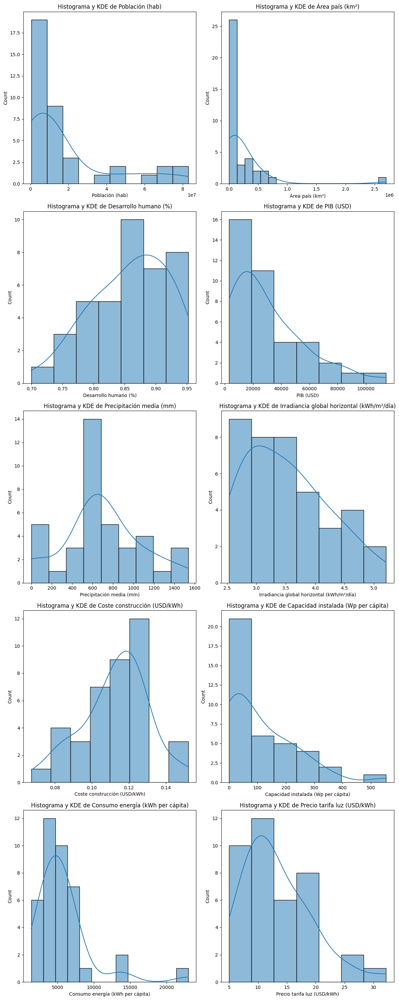

In [32]:
#Vemos todos los histogramas
plot_histo_dens(df_eu_final, df_eu_final.columns)

In [33]:
#De los histogramas me surgen preguntas
'''
1. Graficas relevantes: precipitación, potencial, potencial económico,consumo percapita, tarifa de la luz
2. Potencial y potencial económico son los mismos paises y estamos repitiendo datos?
3. Area equivalete y capacidad instalada son equivalentes

'''

'\n1. Graficas relevantes: precipitación, potencial, potencial económico,consumo percapita, tarifa de la luz\n2. Potencial y potencial económico son los mismos paises y estamos repitiendo datos?\n3. Area equivalete y capacidad instalada son equivalentes\n\n'

In [34]:
def pinta_distribucion_categoricas(df, columnas_categoricas, relativa=False, mostrar_valores=False):
    num_columnas = len(columnas_categoricas)
    num_filas = (num_columnas // 2) + (num_columnas % 2)

    fig, axes = plt.subplots(num_filas, 2, figsize=(15, 5 * num_filas))
    axes = axes.flatten() 

    for i, col in enumerate(columnas_categoricas):
        ax = axes[i]
        if relativa:
            total = df[col].value_counts().sum()
            serie = df[col].value_counts().apply(lambda x: x / total)
            sns.barplot(x=serie.index, y=serie, ax=ax, palette='viridis', hue = serie.index, legend = False)
            ax.set_ylabel('Frecuencia Relativa')
        else:
            serie = df[col].value_counts()
            sns.barplot(x=serie.index, y=serie, ax=ax, palette='viridis', hue = serie.index, legend = False)
            ax.set_ylabel('Frecuencia')

        ax.set_title(f'Distribución de {col}')
        ax.set_xlabel('')
        ax.tick_params(axis='x', rotation=45)

        if mostrar_valores:
            for p in ax.patches:
                height = p.get_height()
                ax.annotate(f'{height:.2f}', (p.get_x() + p.get_width() / 2., height), 
                            ha='center', va='center', xytext=(0, 9), textcoords='offset points')

    for j in range(i + 1, num_filas * 2):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()


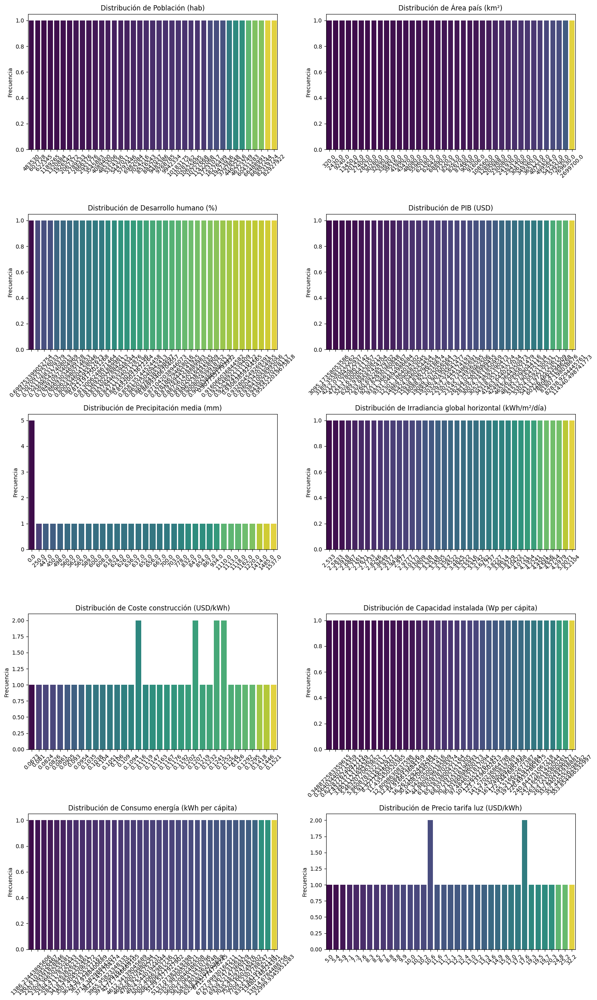

In [35]:
pinta_distribucion_categoricas(df_eu_final, df_eu_final.columns, relativa=False, mostrar_valores=False)
#Estas graficas apenas nos reportan info, tiene más importancia analizar bivariante

In [36]:
def plot_multiple_boxplots(df, columns, dim_matriz_visual = 2):
    num_cols = len(columns)
    num_rows = num_cols // dim_matriz_visual + num_cols % dim_matriz_visual
    fig, axes = plt.subplots(num_rows, dim_matriz_visual, figsize=(12, 6 * num_rows))
    axes = axes.flatten()

    for i, column in enumerate(columns):
        if df[column].dtype in ['int64', 'float64']:
            sns.boxplot(data=df, x=column, ax=axes[i])
            axes[i].set_title(column)

    # Ocultar ejes vacíos
    for j in range(i+1, num_rows * 2):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

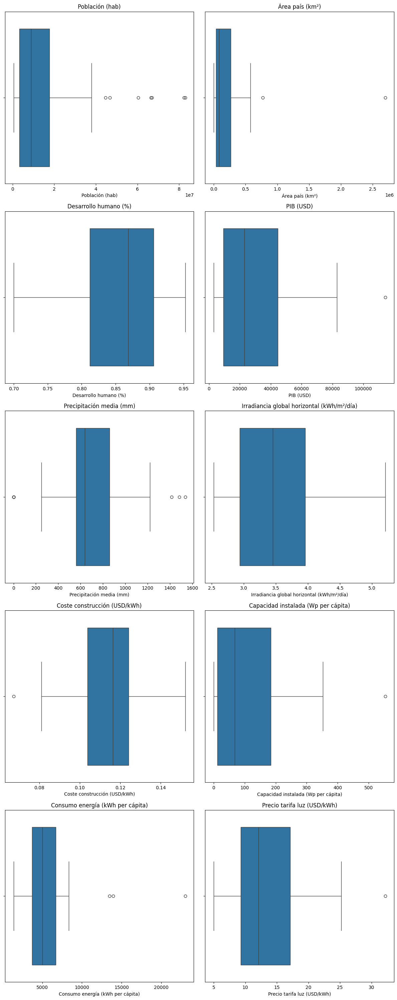

In [37]:
plot_multiple_boxplots(df_eu_final, df_eu_final.columns, dim_matriz_visual = 2)

In [38]:
df_eu_final.columns

Index(['Población (hab)', 'Área país (km²)', 'Desarrollo humano (%)',
       'PIB (USD)', 'Precipitación media (mm)',
       'Irradiancia global horizontal (kWh/m²/día)',
       'Coste construcción (USD/kWh)', 'Capacidad instalada (Wp per cápita)',
       'Consumo energía (kWh per cápita)', 'Precio tarifa luz (USD/kWh)'],
      dtype='object')

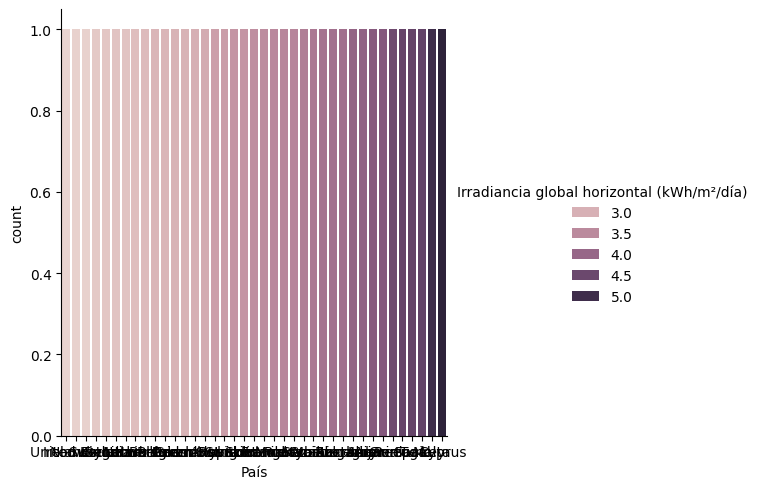

In [39]:
#Grafico barras
sns.catplot(x = "País",
            hue = "Irradiancia global horizontal (kWh/m²/día)",
            kind = "count",
            data = df_eu_final.sort_values("Irradiancia global horizontal (kWh/m²/día)"))
#Como la grafica es inentendible, voy a quedarme con los 10 paises con mayor potencia de energia y economica
#Y con eso ya repetimos los gráficos.


In [40]:
df_eu_gih = df_eu_final.sort_values(by = "Irradiancia global horizontal (kWh/m²/día)",ascending= False )
df_eu_gih_slicing = df_eu_gih.head(10)
df_eu_gih_slicing

,Población (hab),Área país (km²),Desarrollo humano (%),PIB (USD),Precipitación media (mm),Irradiancia global horizontal (kWh/m²/día),Coste construcción (USD/kWh),Capacidad instalada (Wp per cápita),Consumo energía (kWh per cápita),Precio tarifa luz (USD/kWh)
País,,,,,,,,,,
Cyprus,1189265,9240.0,0.868784,28159.301700,498.0,5.2104,0.0905,95.016670,3624.971253,14.9
Malta,483530,320.0,0.878187,30074.741185,560.0,5.0071,0.0930,263.272186,4924.544019,17.0
Turkey,82319724,769630.0,0.790634,9311.366117,0.0,4.5979,0.0824,61.502879,2847.126383,10.1
Spain,46723749,499564.0,0.891020,30523.859239,636.0,4.5754,0.0810,101.526528,5355.987006,24.8
Portugal,10281762,91606.0,0.847113,23145.734956,854.0,4.5656,0.0826,65.183380,4662.600800,25.2
Greece,10727668,128900.0,0.869934,20324.253564,652.0,4.4501,0.0861,247.164621,5062.606422,19.5
Armenia,2951776,28470.0,0.755113,4212.070943,562.0,4.2241,0.1038,5.860878,1961.610395,7.6
Albania,2866376,27400.0,0.784911,5253.630064,1485.0,4.1954,0.1051,0.348873,2309.366503,8.7
Italy,60431283,294140.0,0.879769,34318.351124,832.0,4.0721,0.0673,332.940143,5002.406680,19.3


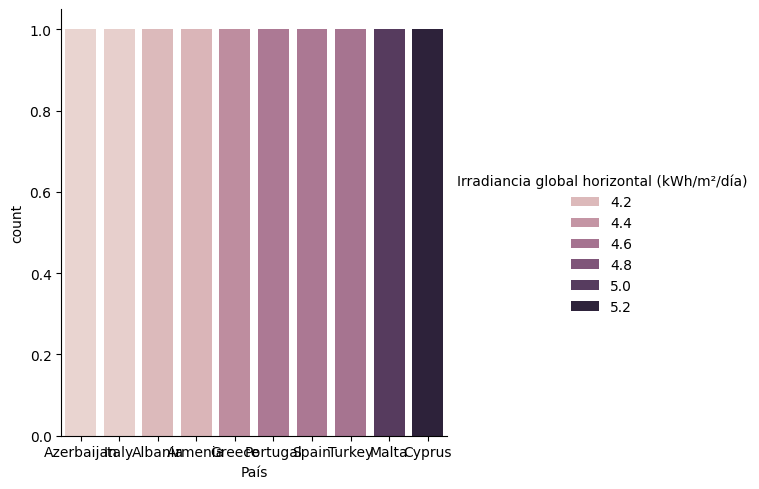

In [41]:
#Grafico barras 
sns.catplot(x = "País",
            hue = "Irradiancia global horizontal (kWh/m²/día)",
            kind = "count",
            data = df_eu_gih_slicing.sort_values("Irradiancia global horizontal (kWh/m²/día)"))
#No funciona bien, buscar otro

<Axes: xlabel='País', ylabel='Irradiancia global horizontal (kWh/m²/día)'>

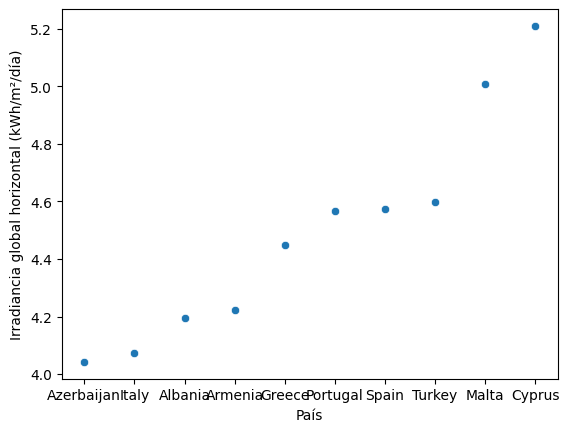

In [42]:
#Grafico dispersion
sns.scatterplot(x = "País",
                y= "Irradiancia global horizontal (kWh/m²/día)",
                data = df_eu_gih_slicing.sort_values("Irradiancia global horizontal (kWh/m²/día)"))

<Axes: xlabel='Capacidad instalada (Wp per cápita)', ylabel='Irradiancia global horizontal (kWh/m²/día)'>

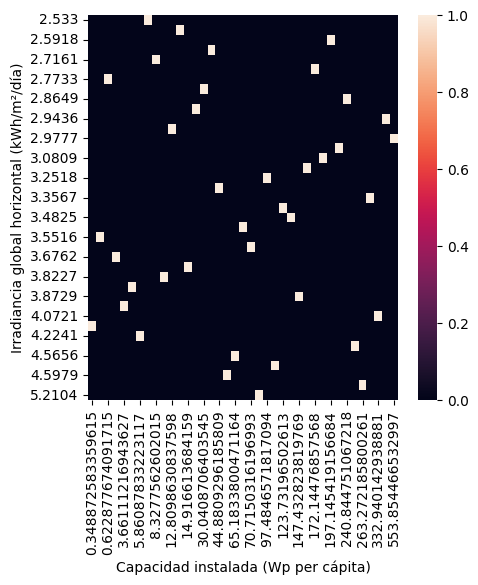

In [43]:
#Tabla de contingencias potencial - capacidad instalada
tabla_contigencia = pd.crosstab(df_eu_final["Irradiancia global horizontal (kWh/m²/día)"], 
                                df_eu_final["Capacidad instalada (Wp per cápita)"])

tabla_contigencia
#Mapa calor
plt.figure(figsize=(5,5))
sns.heatmap(tabla_contigencia)

<Axes: xlabel='Capacidad instalada (Wp per cápita)', ylabel='Coste construcción (USD/kWh)'>

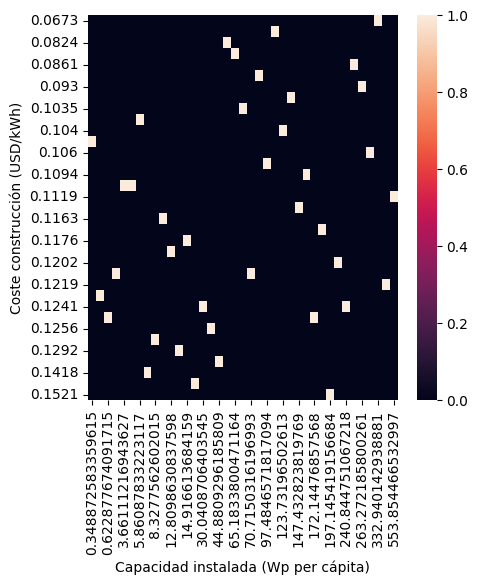

In [44]:
#Tabla de contingencias coste - capacidad instalada
tabla_contigencia = pd.crosstab(df_eu_final["Coste construcción (USD/kWh)"], 
                                df_eu_final["Capacidad instalada (Wp per cápita)"])

tabla_contigencia
#Mapa calor
plt.figure(figsize=(5,5))
sns.heatmap(tabla_contigencia)

<Axes: xlabel='Capacidad instalada (Wp per cápita)', ylabel='Precio tarifa luz (USD/kWh)'>

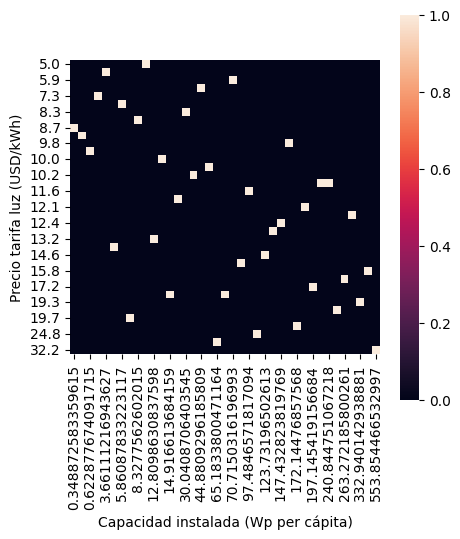

In [45]:
#Tabla de contingencias coste - capacidad instalada
tabla_contigencia = pd.crosstab(df_eu_final["Precio tarifa luz (USD/kWh)"].sort_values(ascending=False), 
                                df_eu_final["Capacidad instalada (Wp per cápita)"])

tabla_contigencia
#Mapa calor
plt.figure(figsize=(5,5))
sns.heatmap(tabla_contigencia,
            square=True)

<Axes: >

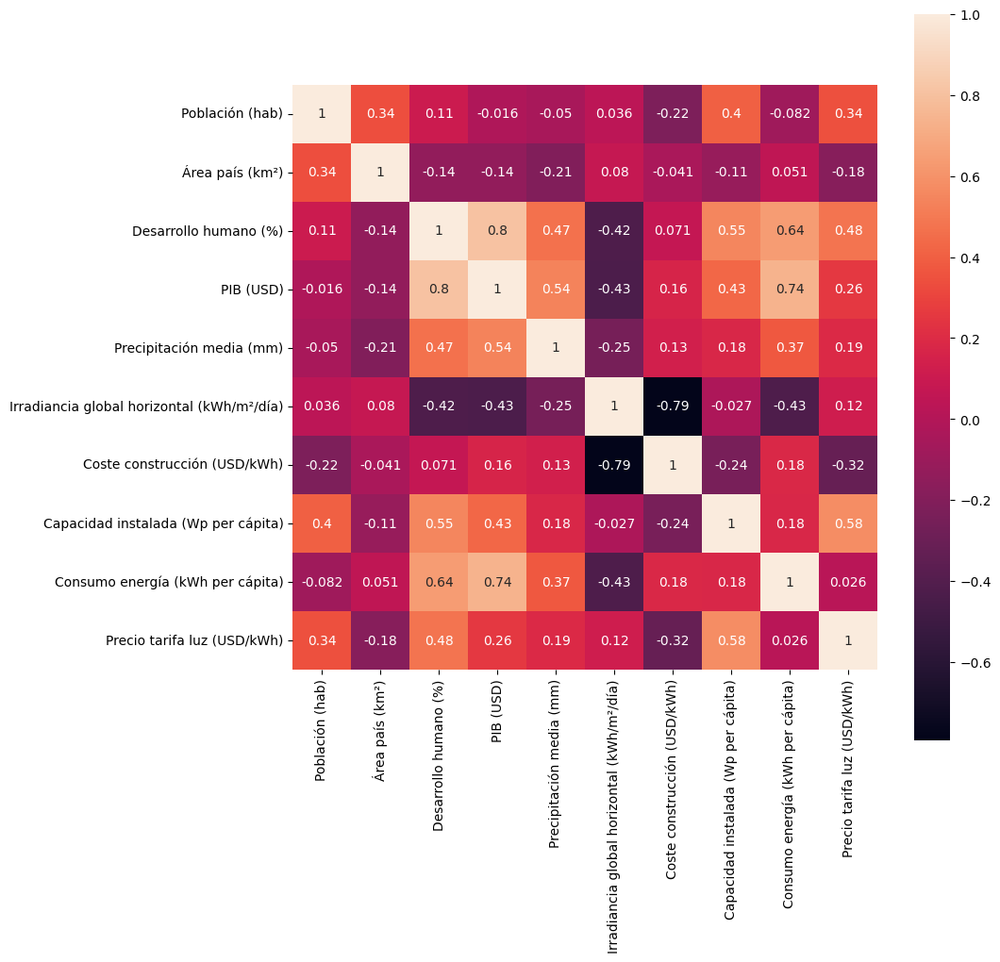

In [46]:
#Tabla de contingencias coste - capacidad instalada
matriz_correlacion = df_eu_final.corr()

matriz_correlacion
#Mapa calor
plt.figure(figsize=(10,10))
sns.heatmap(matriz_correlacion,
            square=True, 
            annot=True)

C:\Users\gema.sanz\AppData\Local\Temp\ipykernel_17688\2789358968.py:12: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  filtro_correlacion = matriz_correlacion.applymap(lambda x: x if abs(x) > porcentaje else np.nan)


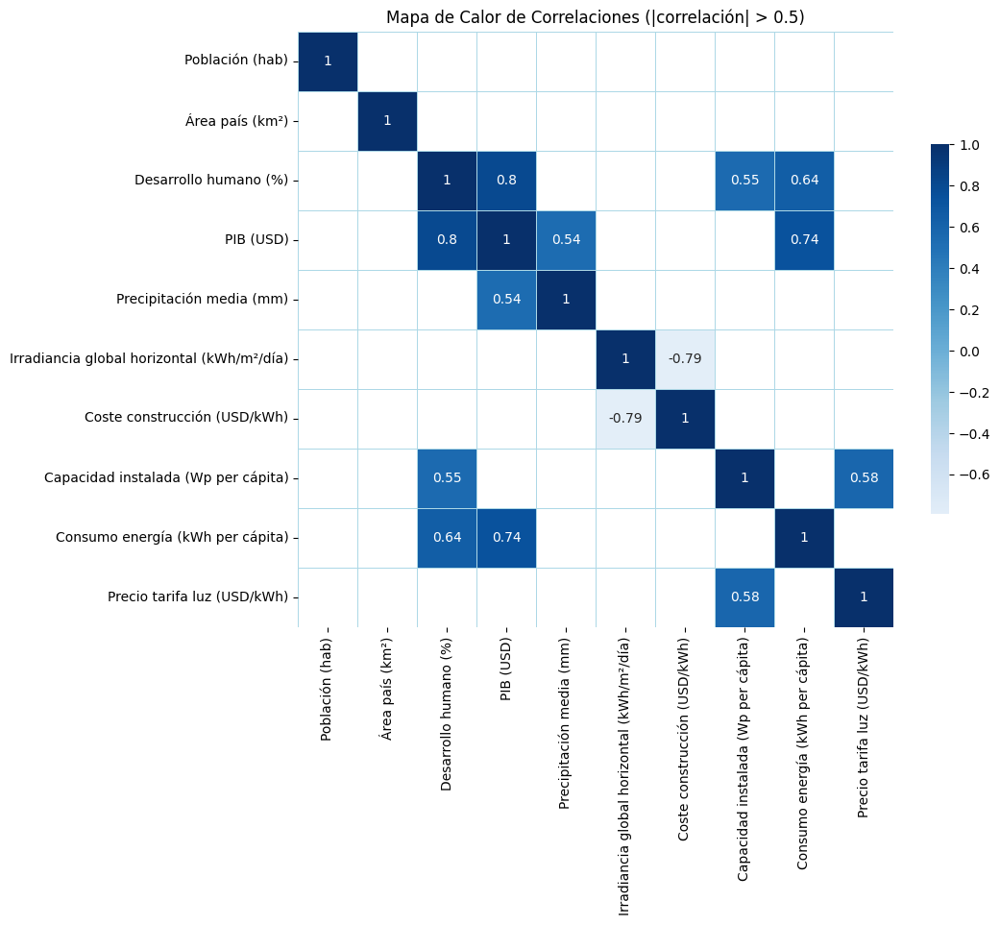

In [47]:
#Ver matriz de correlaciones solo valores más representativos

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
def mapa_calor_correlacion( df,porcentaje):
    # Supongamos que df_eu es tu DataFrame y ya has calculado la matriz de correlación
    matriz_correlacion = df.corr()

    # Filtrar la matriz de correlación para dejar solo valores superiores a 0.5 o inferiores a -0.5
    filtro_correlacion = matriz_correlacion.applymap(lambda x: x if abs(x) > porcentaje else np.nan)

    # Crear el mapa de calor
    plt.figure(figsize=(10, 10))
    sns.heatmap(filtro_correlacion,
                square=True, 
                annot=True, 
                cmap='Blues', 
                center=0,
                cbar_kws={'shrink': .5},
                linewidths=.5,
                linecolor='lightblue')

    plt.title(f'Mapa de Calor de Correlaciones (|correlación| > {porcentaje})')
    return plt.show()


mapa_calor_correlacion(df_eu_final, 0.5)

# Conclusion
1. Si la irraciancia es casi igual que la energia potencial, significa que las plantas obtienen los mismos niveles de producción independientemente del pais
2. El coste economico de construir la planta y mantenerla es lo que determina junto con la potencia en qué paises se construira
3. El area del pais no tiene que ver, para colocar plantas fotovoltaicas
4. El PIB si que tiene una relación con las areas con instalaciones fotovoltaicas, 
5. Ver el consumo per capita
6. El aumento de precipitacion solo indica que hacen más consumo de luz


In [48]:
df_eu_final.columns


Index(['Población (hab)', 'Área país (km²)', 'Desarrollo humano (%)',
       'PIB (USD)', 'Precipitación media (mm)',
       'Irradiancia global horizontal (kWh/m²/día)',
       'Coste construcción (USD/kWh)', 'Capacidad instalada (Wp per cápita)',
       'Consumo energía (kWh per cápita)', 'Precio tarifa luz (USD/kWh)'],
      dtype='object')

In [49]:
df_eu_final["Irradiancia global horizontal (kWh/m²/día)" ].sort_values(ascending=False)

País
Cyprus            5.2104
Malta             5.0071
Turkey            4.5979
Spain             4.5754
Portugal          4.5656
Greece            4.4501
Armenia           4.2241
Albania           4.1954
Italy             4.0721
Azerbaijan        4.0422
Bulgaria          3.8729
Montenegro        3.8614
Kazakhstan        3.8227
Croatia           3.7370
Serbia            3.6762
Romania           3.5742
Moldova           3.5516
Hungary           3.5222
France            3.4825
Slovenia          3.4522
Switzerland       3.3567
Ukraine           3.3505
Slovakia          3.2518
Austria           3.2138
Czech Republic    3.0809
Luxembourg        3.0173
Germany           2.9777
Poland            2.9770
Belgium           2.9436
Belarus           2.9377
Netherlands       2.8649
Lithuania         2.8246
Latvia            2.7733
Denmark           2.7671
Estonia           2.7161
Sweden            2.6867
United Kingdom    2.5918
Norway            2.5833
Ireland           2.5330
Name: Irradiancia gl

In [50]:
df_eu_final["Coste construcción (USD/kWh)" ].sort_values(ascending=False)

País
United Kingdom    0.1521
Belarus           0.1446
Ireland           0.1418
Ukraine           0.1295
Norway            0.1292
Estonia           0.1260
Sweden            0.1256
Latvia            0.1252
Denmark           0.1252
Lithuania         0.1241
Netherlands       0.1241
Moldova           0.1232
Belgium           0.1219
Serbia            0.1207
Romania           0.1207
Luxembourg        0.1202
Poland            0.1192
Croatia           0.1176
Czech Republic    0.1167
Kazakhstan        0.1163
Bulgaria          0.1147
Germany           0.1119
Azerbaijan        0.1116
Montenegro        0.1116
Austria           0.1094
Slovakia          0.1090
Switzerland       0.1060
Albania           0.1051
Slovenia          0.1040
Armenia           0.1038
Hungary           0.1035
France            0.0954
Malta             0.0930
Cyprus            0.0905
Greece            0.0861
Portugal          0.0826
Turkey            0.0824
Spain             0.0810
Italy             0.0673
Name: Coste construc

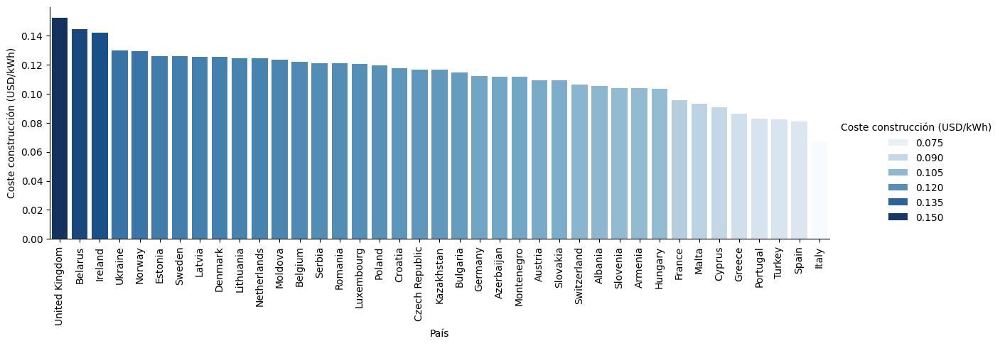

In [51]:
sns.catplot(
    data=df_eu_final.sort_values("Coste construcción (USD/kWh)" , ascending=False),
    hue='Coste construcción (USD/kWh)',
    kind = 'bar',
    palette = "Blues",
    x='País',
    y='Coste construcción (USD/kWh)',
    height=4,      # Ajusta la altura
    aspect=3)       # Ajusta el aspecto para que el ancho sea el doble de la altura


# Rotar las etiquetas del eje x
plt.xticks(rotation=90)

# Mostrar la gráfica
plt.show()

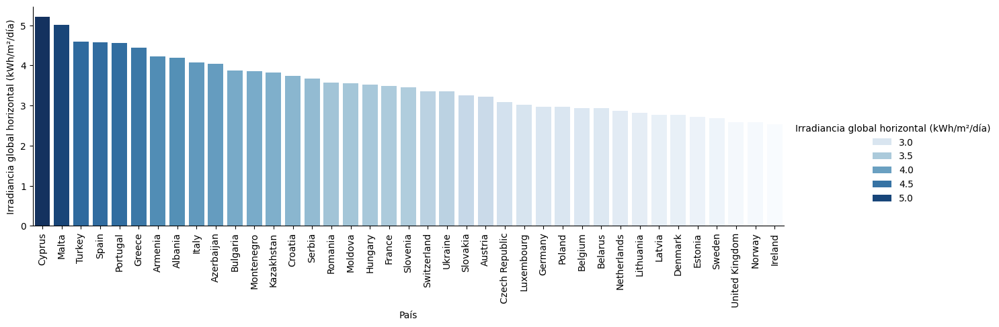

In [52]:
sns.catplot(
    data=df_eu_final.sort_values("Irradiancia global horizontal (kWh/m²/día)" , ascending=False),
    hue='Irradiancia global horizontal (kWh/m²/día)',
    kind = 'bar',
    palette = "Blues",
    x='País',
    y='Irradiancia global horizontal (kWh/m²/día)',
    height=4,      # Ajusta la altura
    aspect=3)       # Ajusta el aspecto para que el ancho sea el doble de la altura


# Rotar las etiquetas del eje x
plt.xticks(rotation=90)

# Mostrar la gráfica
plt.show()

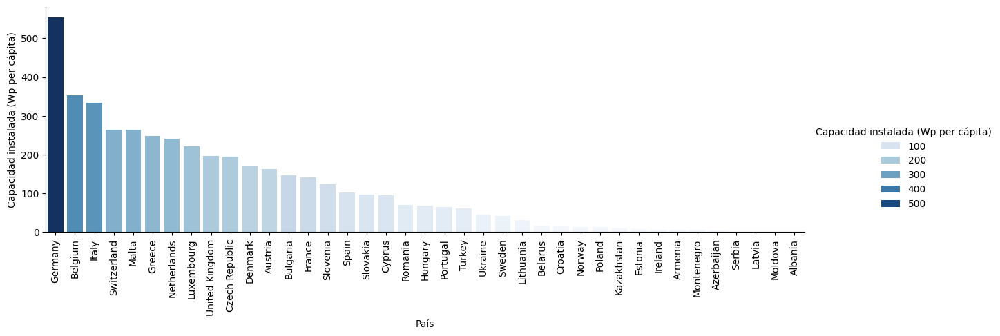

In [53]:
sns.catplot(
    data=df_eu_final.sort_values("Capacidad instalada (Wp per cápita)" , ascending=False),
    hue='Capacidad instalada (Wp per cápita)',
    kind = 'bar',
    palette = "Blues",
    x='País',
    y='Capacidad instalada (Wp per cápita)',
    height=4,      # Ajusta la altura
    aspect=3)       # Ajusta el aspecto para que el ancho sea el doble de la altura


# Rotar las etiquetas del eje x
plt.xticks(rotation=90)

# Mostrar la gráfica
plt.show()

In [54]:
df_eu.columns

Index(['Pais', 'Poblacion_2018', 'Area_2018', 'Area_Evaluada_Porcentaje',
       'Desarrollo_humano_2017', 'PIB_USD_2018', 'Precipitacion_media_2018',
       'Irradiancia_Global_Horizontal', 'Potencial_kWh/kWp/day',
       'Coste_Economico_USD/kWh_2018', 'Area_equivalente_PV',
       'Capacidad_instalada_2018', 'Consumo_kWh_per_capita_2014',
       'Tarifa_luz_USD/kWh'],
      dtype='object')

              Pais                  Variable         Valor  Porcentaje
59         Germany            Poblacion_2018  8.292792e+07   11.698672
85          Turkey            Poblacion_2018  8.231972e+07   11.612873
57          France            Poblacion_2018  6.698724e+07    9.449915
87  United Kingdom            Poblacion_2018  6.648899e+07    9.379626
63           Italy            Poblacion_2018  6.043128e+07    8.525063
..             ...                       ...           ...         ...
39          Sweden  Capacidad_instalada_2018  4.134271e+01    0.941686
40     Switzerland  Capacidad_instalada_2018  2.637220e+02    6.006946
41          Turkey  Capacidad_instalada_2018  6.150288e+01    1.400886
42         Ukraine  Capacidad_instalada_2018  4.488093e+01    1.022278
43  United Kingdom  Capacidad_instalada_2018  1.971454e+02    4.490493

[88 rows x 4 columns]


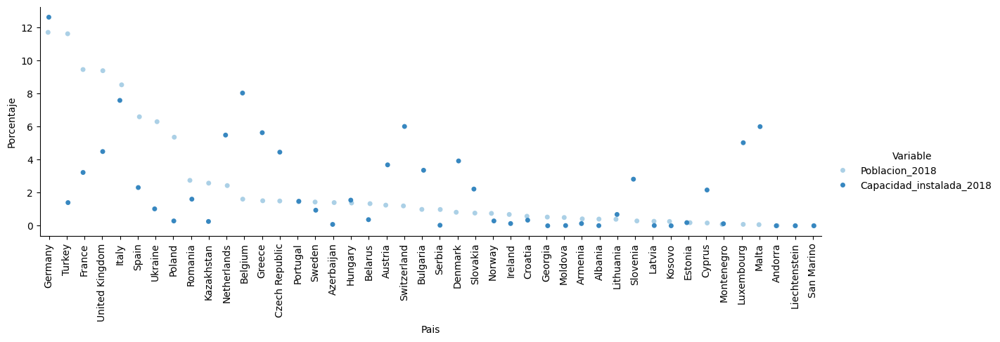

              Pais                  Variable         Valor  Porcentaje
64      Kazakhstan                 Area_2018  2.699700e+06   30.183003
85          Turkey                 Area_2018  7.696300e+05    8.604565
86         Ukraine                 Area_2018  5.792900e+05    6.476539
57          France                 Area_2018  5.475570e+05    6.121760
82           Spain                 Area_2018  4.995640e+05    5.585192
..             ...                       ...           ...         ...
39          Sweden  Capacidad_instalada_2018  4.134271e+01    0.941686
40     Switzerland  Capacidad_instalada_2018  2.637220e+02    6.006946
41          Turkey  Capacidad_instalada_2018  6.150288e+01    1.400886
42         Ukraine  Capacidad_instalada_2018  4.488093e+01    1.022278
43  United Kingdom  Capacidad_instalada_2018  1.971454e+02    4.490493

[88 rows x 4 columns]


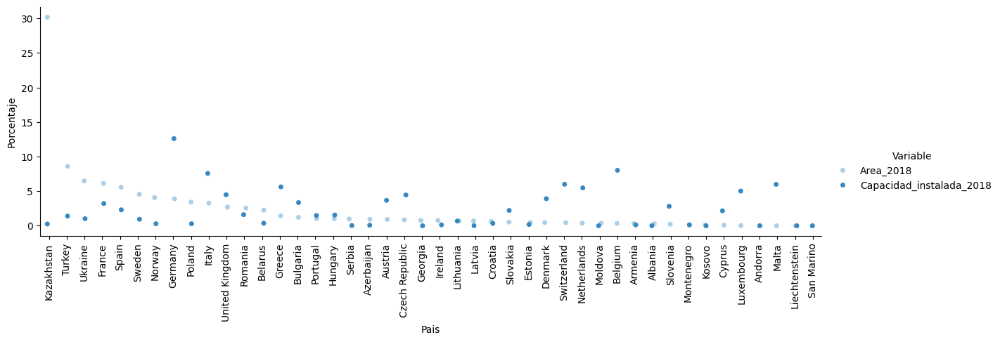

              Pais                  Variable       Valor  Porcentaje
71         Moldova  Area_Evaluada_Porcentaje    0.958701    3.074886
76        Portugal  Area_Evaluada_Porcentaje    0.916908    2.940841
55         Denmark  Area_Evaluada_Porcentaje    0.902991    2.896205
86         Ukraine  Area_Evaluada_Porcentaje    0.894402    2.868656
53          Cyprus  Area_Evaluada_Porcentaje    0.883055    2.832261
..             ...                       ...         ...         ...
39          Sweden  Capacidad_instalada_2018   41.342705    0.941686
40     Switzerland  Capacidad_instalada_2018  263.722029    6.006946
41          Turkey  Capacidad_instalada_2018   61.502879    1.400886
42         Ukraine  Capacidad_instalada_2018   44.880930    1.022278
43  United Kingdom  Capacidad_instalada_2018  197.145419    4.490493

[88 rows x 4 columns]


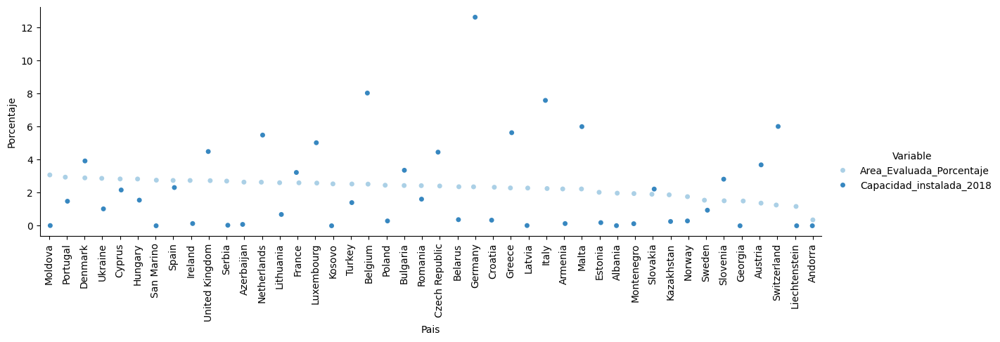

              Pais                  Variable       Valor  Porcentaje
74          Norway    Desarrollo_humano_2017    0.952522    2.644252
84     Switzerland    Desarrollo_humano_2017    0.943998    2.620588
62         Ireland    Desarrollo_humano_2017    0.938410    2.605077
59         Germany    Desarrollo_humano_2017    0.936043    2.598507
83          Sweden    Desarrollo_humano_2017    0.932805    2.589515
..             ...                       ...         ...         ...
39          Sweden  Capacidad_instalada_2018   41.342705    0.941686
40     Switzerland  Capacidad_instalada_2018  263.722029    6.006946
41          Turkey  Capacidad_instalada_2018   61.502879    1.400886
42         Ukraine  Capacidad_instalada_2018   44.880930    1.022278
43  United Kingdom  Capacidad_instalada_2018  197.145419    4.490493

[88 rows x 4 columns]


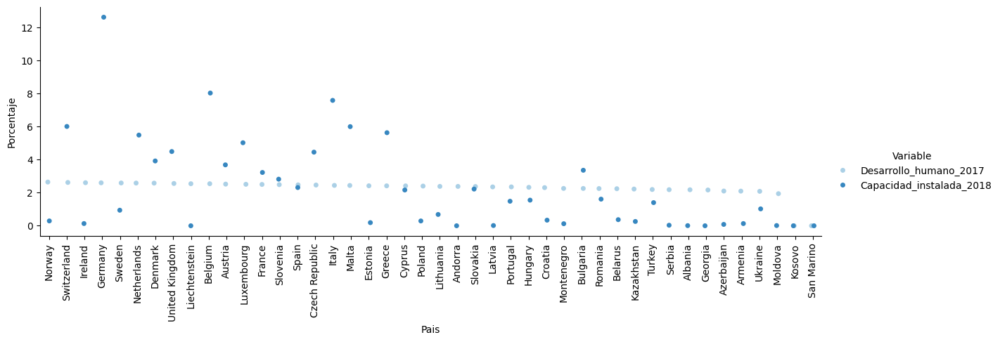

              Pais                  Variable          Valor  Porcentaje
67   Liechtenstein              PIB_USD_2018  165028.245029   11.422458
69      Luxembourg              PIB_USD_2018  114340.498742    7.914097
84     Switzerland              PIB_USD_2018   82838.929445    5.733711
74          Norway              PIB_USD_2018   81807.198039    5.662299
62         Ireland              PIB_USD_2018   78806.431996    5.454601
..             ...                       ...            ...         ...
39          Sweden  Capacidad_instalada_2018      41.342705    0.941686
40     Switzerland  Capacidad_instalada_2018     263.722029    6.006946
41          Turkey  Capacidad_instalada_2018      61.502879    1.400886
42         Ukraine  Capacidad_instalada_2018      44.880930    1.022278
43  United Kingdom  Capacidad_instalada_2018     197.145419    4.490493

[88 rows x 4 columns]


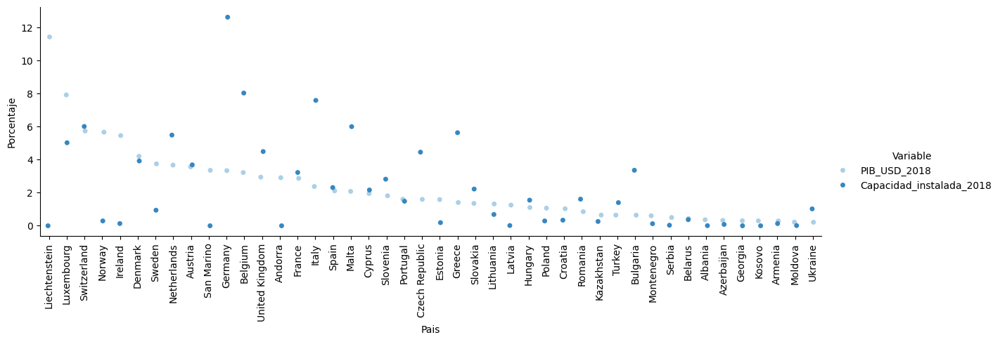

              Pais                  Variable        Valor  Porcentaje
84     Switzerland  Precipitacion_media_2018  1537.000000    5.500089
44         Albania  Precipitacion_media_2018  1485.000000    5.314010
74          Norway  Precipitacion_media_2018  1414.000000    5.059939
87  United Kingdom  Precipitacion_media_2018  1220.000000    4.365718
81        Slovenia  Precipitacion_media_2018  1162.000000    4.158168
..             ...                       ...          ...         ...
39          Sweden  Capacidad_instalada_2018    41.342705    0.941686
40     Switzerland  Capacidad_instalada_2018   263.722029    6.006946
41          Turkey  Capacidad_instalada_2018    61.502879    1.400886
42         Ukraine  Capacidad_instalada_2018    44.880930    1.022278
43  United Kingdom  Capacidad_instalada_2018   197.145419    4.490493

[88 rows x 4 columns]


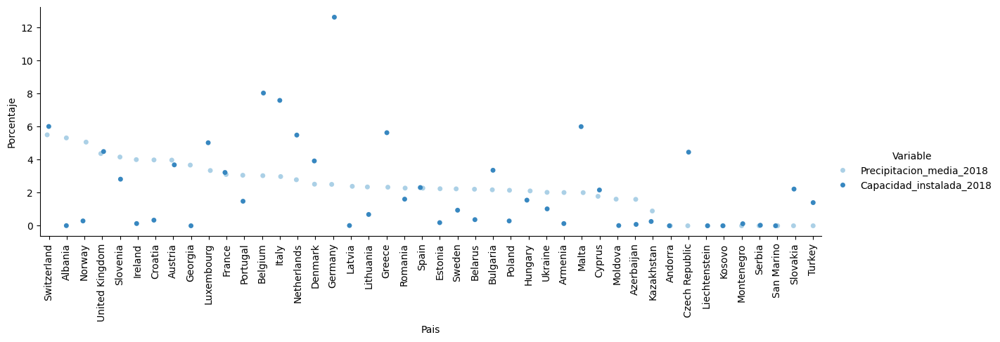

              Pais                       Variable       Valor  Porcentaje
53          Cyprus  Irradiancia_Global_Horizontal    5.210400    3.347050
70           Malta  Irradiancia_Global_Horizontal    5.007100    3.216455
85          Turkey  Irradiancia_Global_Horizontal    4.597900    2.953593
82           Spain  Irradiancia_Global_Horizontal    4.575400    2.939140
76        Portugal  Irradiancia_Global_Horizontal    4.565600    2.932844
..             ...                            ...         ...         ...
39          Sweden       Capacidad_instalada_2018   41.342705    0.941686
40     Switzerland       Capacidad_instalada_2018  263.722029    6.006946
41          Turkey       Capacidad_instalada_2018   61.502879    1.400886
42         Ukraine       Capacidad_instalada_2018   44.880930    1.022278
43  United Kingdom       Capacidad_instalada_2018  197.145419    4.490493

[88 rows x 4 columns]


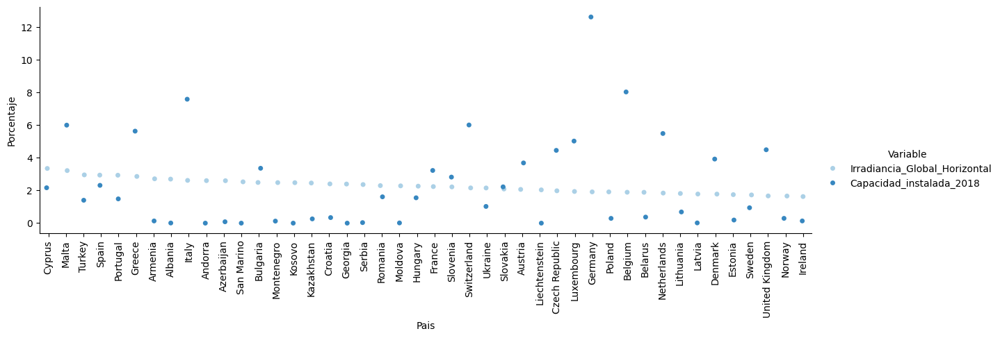

              Pais                  Variable       Valor  Porcentaje
53          Cyprus     Potencial_kWh/kWp/day    4.698300    3.078967
70           Malta     Potencial_kWh/kWp/day    4.561800    2.989513
82           Spain     Potencial_kWh/kWp/day    4.412700    2.891803
85          Turkey     Potencial_kWh/kWp/day    4.323200    2.833150
76        Portugal     Potencial_kWh/kWp/day    4.315500    2.828104
..             ...                       ...         ...         ...
39          Sweden  Capacidad_instalada_2018   41.342705    0.941686
40     Switzerland  Capacidad_instalada_2018  263.722029    6.006946
41          Turkey  Capacidad_instalada_2018   61.502879    1.400886
42         Ukraine  Capacidad_instalada_2018   44.880930    1.022278
43  United Kingdom  Capacidad_instalada_2018  197.145419    4.490493

[88 rows x 4 columns]


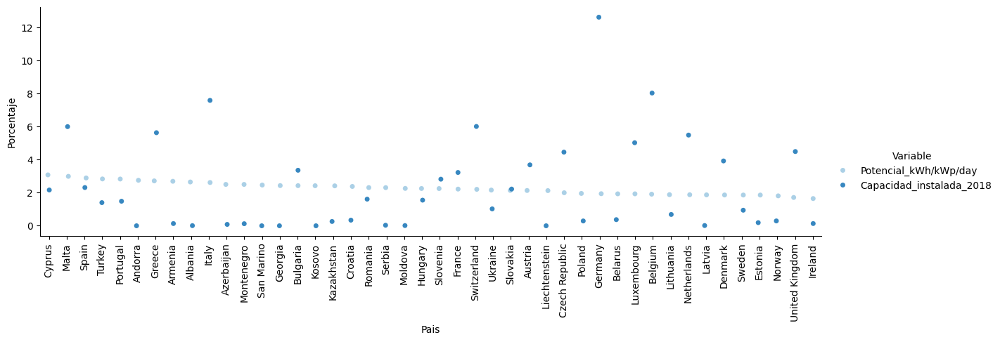

              Pais                      Variable       Valor  Porcentaje
87  United Kingdom  Coste_Economico_USD/kWh_2018    0.152100    3.072169
49         Belarus  Coste_Economico_USD/kWh_2018    0.144600    2.920681
62         Ireland  Coste_Economico_USD/kWh_2018    0.141800    2.864126
86         Ukraine  Coste_Economico_USD/kWh_2018    0.129500    2.615686
74          Norway  Coste_Economico_USD/kWh_2018    0.129200    2.609627
..             ...                           ...         ...         ...
39          Sweden      Capacidad_instalada_2018   41.342705    0.941686
40     Switzerland      Capacidad_instalada_2018  263.722029    6.006946
41          Turkey      Capacidad_instalada_2018   61.502879    1.400886
42         Ukraine      Capacidad_instalada_2018   44.880930    1.022278
43  United Kingdom      Capacidad_instalada_2018  197.145419    4.490493

[88 rows x 4 columns]


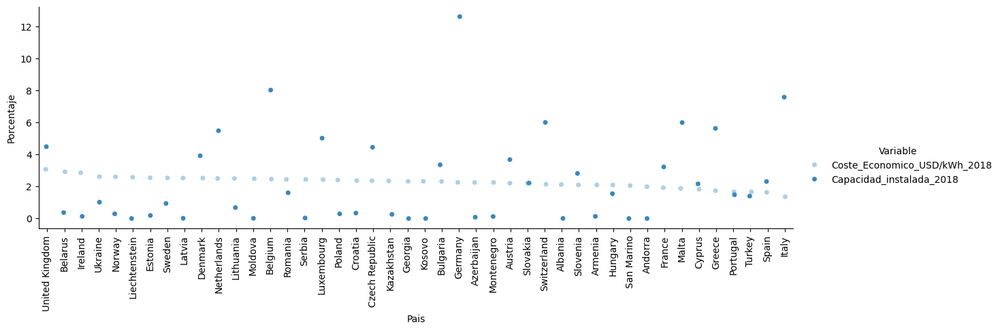

              Pais                  Variable       Valor  Porcentaje
73     Netherlands       Area_equivalente_PV    6.646000   12.574261
69      Luxembourg       Area_equivalente_PV    5.684000   10.754153
50         Belgium       Area_equivalente_PV    5.026000    9.509214
70           Malta       Area_equivalente_PV    4.866000    9.206493
74          Norway       Area_equivalente_PV    4.282000    8.101563
..             ...                       ...         ...         ...
39          Sweden  Capacidad_instalada_2018   41.342705    0.941686
40     Switzerland  Capacidad_instalada_2018  263.722029    6.006946
41          Turkey  Capacidad_instalada_2018   61.502879    1.400886
42         Ukraine  Capacidad_instalada_2018   44.880930    1.022278
43  United Kingdom  Capacidad_instalada_2018  197.145419    4.490493

[88 rows x 4 columns]


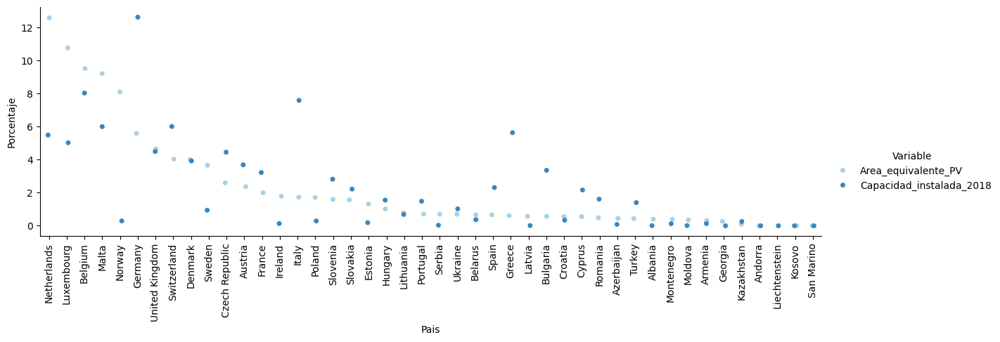

              Pais                  Variable       Valor  Porcentaje
15         Germany  Capacidad_instalada_2018  553.854467   12.615456
6          Belgium  Capacidad_instalada_2018  352.440556    8.027738
19           Italy  Capacidad_instalada_2018  332.940143    7.583566
40     Switzerland  Capacidad_instalada_2018  263.722029    6.006946
26           Malta  Capacidad_instalada_2018  263.272186    5.996699
16          Greece  Capacidad_instalada_2018  247.164621    5.629808
29     Netherlands  Capacidad_instalada_2018  240.844751    5.485857
25      Luxembourg  Capacidad_instalada_2018  220.493379    5.022302
43  United Kingdom  Capacidad_instalada_2018  197.145419    4.490493
10  Czech Republic  Capacidad_instalada_2018  195.516623    4.453393
11         Denmark  Capacidad_instalada_2018  172.144769    3.921039
3          Austria  Capacidad_instalada_2018  161.749069    3.684250
7         Bulgaria  Capacidad_instalada_2018  147.432824    3.358161
13          France  Capacidad_inst

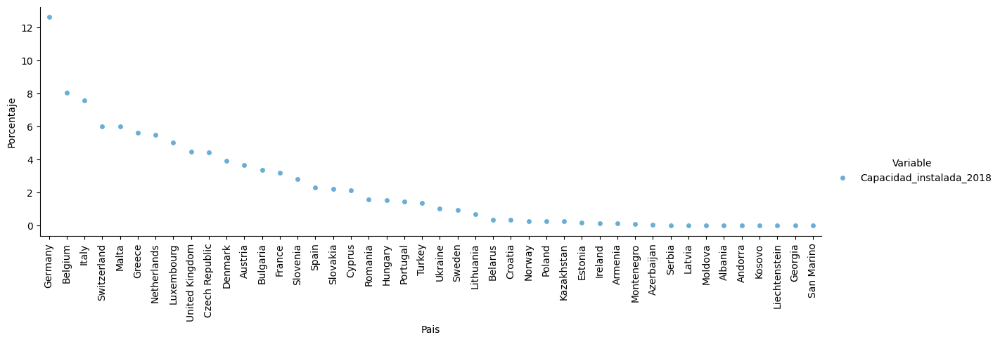

              Pais                     Variable         Valor  Porcentaje
74          Norway  Consumo_kWh_per_capita_2014  22999.934595   10.173581
69      Luxembourg  Consumo_kWh_per_capita_2014  13914.678449    6.154892
83          Sweden  Consumo_kWh_per_capita_2014  13480.148224    5.962686
47         Austria  Consumo_kWh_per_capita_2014   8355.841952    3.696047
50         Belgium  Consumo_kWh_per_capita_2014   7709.123078    3.409983
..             ...                          ...           ...         ...
39          Sweden     Capacidad_instalada_2018     41.342705    0.941686
40     Switzerland     Capacidad_instalada_2018    263.722029    6.006946
41          Turkey     Capacidad_instalada_2018     61.502879    1.400886
42         Ukraine     Capacidad_instalada_2018     44.880930    1.022278
43  United Kingdom     Capacidad_instalada_2018    197.145419    4.490493

[88 rows x 4 columns]


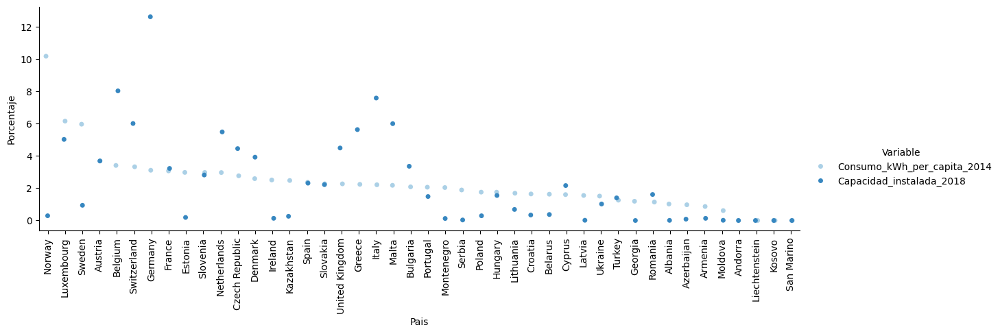

              Pais                  Variable       Valor  Porcentaje
59         Germany        Tarifa_luz_USD/kWh   32.200000    5.868416
76        Portugal        Tarifa_luz_USD/kWh   25.200000    4.592674
82           Spain        Tarifa_luz_USD/kWh   24.800000    4.519774
55         Denmark        Tarifa_luz_USD/kWh   20.300000    3.699654
62         Ireland        Tarifa_luz_USD/kWh   19.700000    3.590304
..             ...                       ...         ...         ...
39          Sweden  Capacidad_instalada_2018   41.342705    0.941686
40     Switzerland  Capacidad_instalada_2018  263.722029    6.006946
41          Turkey  Capacidad_instalada_2018   61.502879    1.400886
42         Ukraine  Capacidad_instalada_2018   44.880930    1.022278
43  United Kingdom  Capacidad_instalada_2018  197.145419    4.490493

[88 rows x 4 columns]


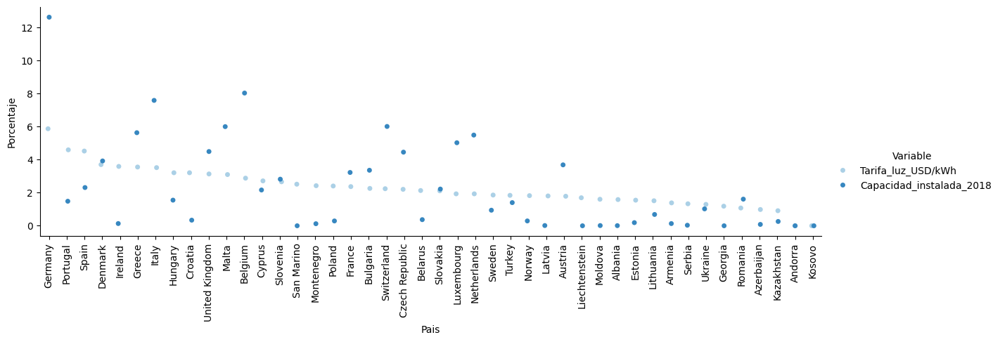

In [55]:



df_eu_melt = df_eu.copy()

for ele in df_eu_melt.columns[1:]:  # Empezar desde la segunda columna para evitar 'Pais'
    # Reorganizar el DataFrame a un formato largo
    df_melted = df_eu_melt.melt(id_vars=['Pais'], 
                                value_vars=['Capacidad_instalada_2018', ele],
                                var_name='Variable', 
                                value_name='Valor')

    # Calcula la suma total de los valores para cada categoría
    suma_cap = df_melted[df_melted['Variable'] == 'Capacidad_instalada_2018']['Valor'].sum()
    suma_ele = df_melted[df_melted['Variable'] == ele]['Valor'].sum()

    # Crear una lista para almacenar los porcentajes
    porcentajes = []

    # Itera a través de cada fila del DataFrame y calcula el porcentaje correspondiente
    for index, row in df_melted.iterrows():
        if row['Variable'] == 'Capacidad_instalada_2018':
            porcentaje = (row['Valor'] / suma_cap) * 100
        else:
            porcentaje = (row['Valor'] / suma_ele) * 100
        porcentajes.append(porcentaje)

    # Añade la lista de porcentajes como una nueva columna al DataFrame
    df_melted['Porcentaje'] = porcentajes

    # Ordenar el DataFrame por Capacidad_instalada_2018 antes de graficar
    df_melted['Orden'] = df_melted.apply(
        lambda row: row['Valor'] if row['Variable'] == ele else None, axis=1
    )
    df_melted = df_melted.sort_values(by='Orden', ascending=False).drop(columns='Orden')

    # Mostrar el DataFrame reorganizado con porcentajes
    print(df_melted)

    # Crear el gráfico
    g = sns.catplot(
        data=df_melted,
        hue='Variable',
        kind='strip',
        palette="Blues",
        x='Pais',
        y='Porcentaje',
        height=4,    # Ajusta la altura
        aspect=3)    # Ajusta el aspecto para que el ancho sea el doble de la altura

    # Rotar las etiquetas del eje x
    plt.xticks(rotation=90)

    # Mostrar la gráfica
    plt.show()

In [56]:
df_eu_final.columns

Index(['Población (hab)', 'Área país (km²)', 'Desarrollo humano (%)',
       'PIB (USD)', 'Precipitación media (mm)',
       'Irradiancia global horizontal (kWh/m²/día)',
       'Coste construcción (USD/kWh)', 'Capacidad instalada (Wp per cápita)',
       'Consumo energía (kWh per cápita)', 'Precio tarifa luz (USD/kWh)'],
      dtype='object')

              País                      Variable         Valor  Porcentaje
7   United Kingdom  Coste construcción (USD/kWh)  1.521000e-01    5.896034
2          Ireland  Coste construcción (USD/kWh)  1.418000e-01    5.496763
0           Norway  Coste construcción (USD/kWh)  1.292000e-01    5.008334
17         Estonia  Coste construcción (USD/kWh)  1.260000e-01    4.884289
4           Sweden  Coste construcción (USD/kWh)  1.256000e-01    4.868783
6          Denmark  Coste construcción (USD/kWh)  1.252000e-01    4.853278
5      Netherlands  Coste construcción (USD/kWh)  1.241000e-01    4.810637
21       Lithuania  Coste construcción (USD/kWh)  1.241000e-01    4.810637
8          Belgium  Coste construcción (USD/kWh)  1.219000e-01    4.725356
10      Luxembourg  Coste construcción (USD/kWh)  1.202000e-01    4.659457
20          Poland  Coste construcción (USD/kWh)  1.192000e-01    4.620692
14  Czech Republic  Coste construcción (USD/kWh)  1.167000e-01    4.523782
3          Germany  Coste

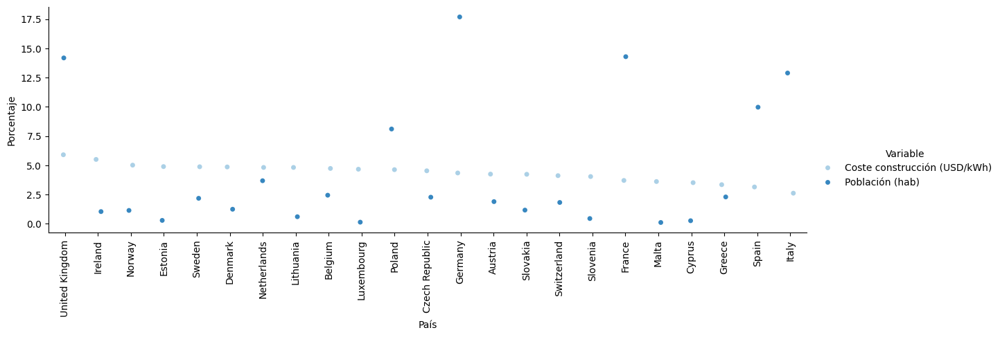

              País                      Variable        Valor  Porcentaje
7   United Kingdom  Coste construcción (USD/kWh)       0.1521    5.896034
2          Ireland  Coste construcción (USD/kWh)       0.1418    5.496763
0           Norway  Coste construcción (USD/kWh)       0.1292    5.008334
17         Estonia  Coste construcción (USD/kWh)       0.1260    4.884289
4           Sweden  Coste construcción (USD/kWh)       0.1256    4.868783
6          Denmark  Coste construcción (USD/kWh)       0.1252    4.853278
5      Netherlands  Coste construcción (USD/kWh)       0.1241    4.810637
21       Lithuania  Coste construcción (USD/kWh)       0.1241    4.810637
8          Belgium  Coste construcción (USD/kWh)       0.1219    4.725356
10      Luxembourg  Coste construcción (USD/kWh)       0.1202    4.659457
20          Poland  Coste construcción (USD/kWh)       0.1192    4.620692
14  Czech Republic  Coste construcción (USD/kWh)       0.1167    4.523782
3          Germany  Coste construcción

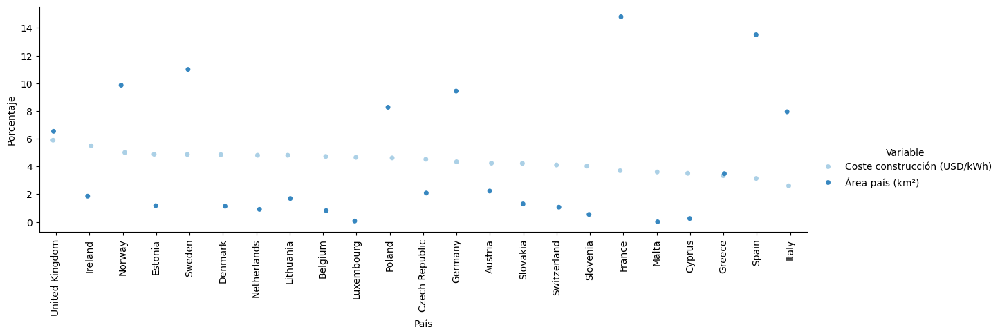

              País                      Variable     Valor  Porcentaje
7   United Kingdom  Coste construcción (USD/kWh)  0.152100    5.896034
2          Ireland  Coste construcción (USD/kWh)  0.141800    5.496763
0           Norway  Coste construcción (USD/kWh)  0.129200    5.008334
17         Estonia  Coste construcción (USD/kWh)  0.126000    4.884289
4           Sweden  Coste construcción (USD/kWh)  0.125600    4.868783
6          Denmark  Coste construcción (USD/kWh)  0.125200    4.853278
5      Netherlands  Coste construcción (USD/kWh)  0.124100    4.810637
21       Lithuania  Coste construcción (USD/kWh)  0.124100    4.810637
8          Belgium  Coste construcción (USD/kWh)  0.121900    4.725356
10      Luxembourg  Coste construcción (USD/kWh)  0.120200    4.659457
20          Poland  Coste construcción (USD/kWh)  0.119200    4.620692
14  Czech Republic  Coste construcción (USD/kWh)  0.116700    4.523782
3          Germany  Coste construcción (USD/kWh)  0.111900    4.337714
9     

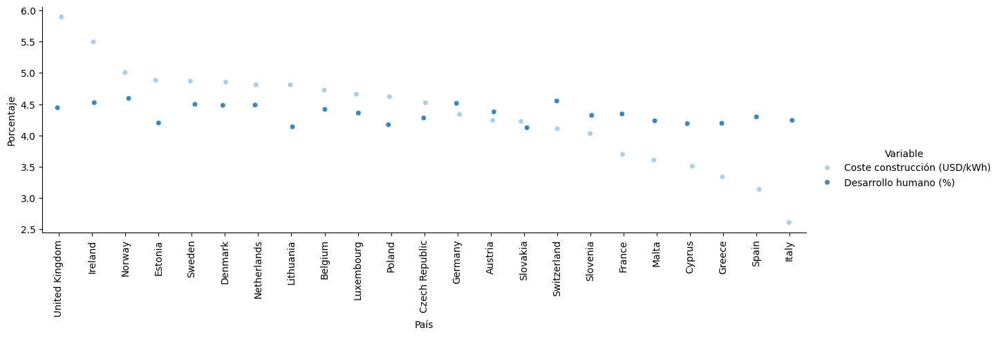

              País                      Variable          Valor  Porcentaje
7   United Kingdom  Coste construcción (USD/kWh)       0.152100    5.896034
2          Ireland  Coste construcción (USD/kWh)       0.141800    5.496763
0           Norway  Coste construcción (USD/kWh)       0.129200    5.008334
17         Estonia  Coste construcción (USD/kWh)       0.126000    4.884289
4           Sweden  Coste construcción (USD/kWh)       0.125600    4.868783
6          Denmark  Coste construcción (USD/kWh)       0.125200    4.853278
5      Netherlands  Coste construcción (USD/kWh)       0.124100    4.810637
21       Lithuania  Coste construcción (USD/kWh)       0.124100    4.810637
8          Belgium  Coste construcción (USD/kWh)       0.121900    4.725356
10      Luxembourg  Coste construcción (USD/kWh)       0.120200    4.659457
20          Poland  Coste construcción (USD/kWh)       0.119200    4.620692
14  Czech Republic  Coste construcción (USD/kWh)       0.116700    4.523782
3          G

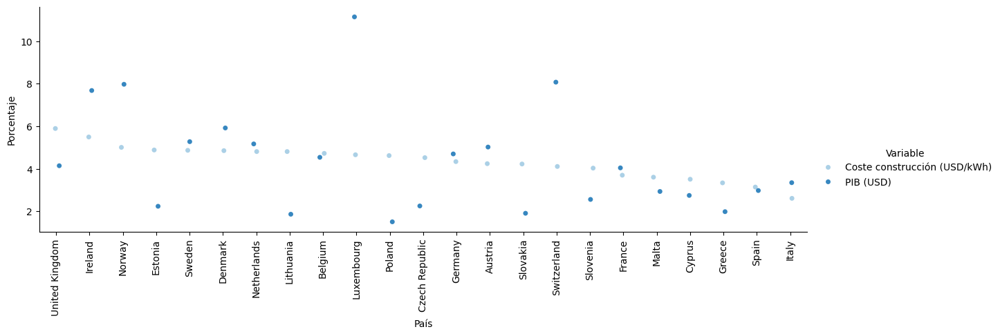

              País                      Variable      Valor  Porcentaje
7   United Kingdom  Coste construcción (USD/kWh)     0.1521    5.896034
2          Ireland  Coste construcción (USD/kWh)     0.1418    5.496763
0           Norway  Coste construcción (USD/kWh)     0.1292    5.008334
17         Estonia  Coste construcción (USD/kWh)     0.1260    4.884289
4           Sweden  Coste construcción (USD/kWh)     0.1256    4.868783
6          Denmark  Coste construcción (USD/kWh)     0.1252    4.853278
5      Netherlands  Coste construcción (USD/kWh)     0.1241    4.810637
21       Lithuania  Coste construcción (USD/kWh)     0.1241    4.810637
8          Belgium  Coste construcción (USD/kWh)     0.1219    4.725356
10      Luxembourg  Coste construcción (USD/kWh)     0.1202    4.659457
20          Poland  Coste construcción (USD/kWh)     0.1192    4.620692
14  Czech Republic  Coste construcción (USD/kWh)     0.1167    4.523782
3          Germany  Coste construcción (USD/kWh)     0.1119    4

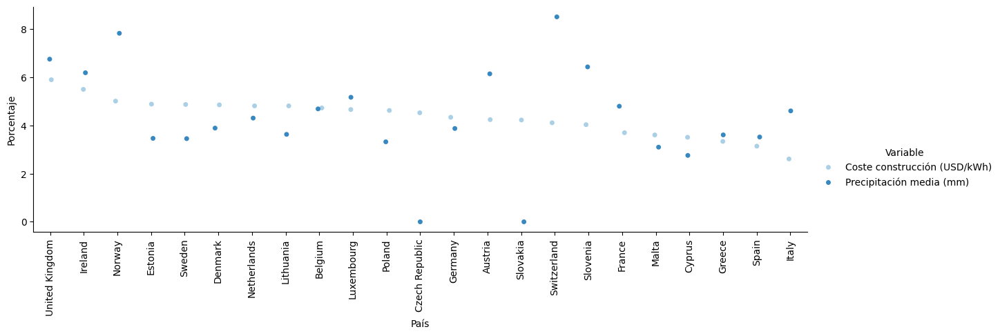

              País                                    Variable   Valor  \
7   United Kingdom                Coste construcción (USD/kWh)  0.1521   
2          Ireland                Coste construcción (USD/kWh)  0.1418   
0           Norway                Coste construcción (USD/kWh)  0.1292   
17         Estonia                Coste construcción (USD/kWh)  0.1260   
4           Sweden                Coste construcción (USD/kWh)  0.1256   
6          Denmark                Coste construcción (USD/kWh)  0.1252   
5      Netherlands                Coste construcción (USD/kWh)  0.1241   
21       Lithuania                Coste construcción (USD/kWh)  0.1241   
8          Belgium                Coste construcción (USD/kWh)  0.1219   
10      Luxembourg                Coste construcción (USD/kWh)  0.1202   
20          Poland                Coste construcción (USD/kWh)  0.1192   
14  Czech Republic                Coste construcción (USD/kWh)  0.1167   
3          Germany                Cost

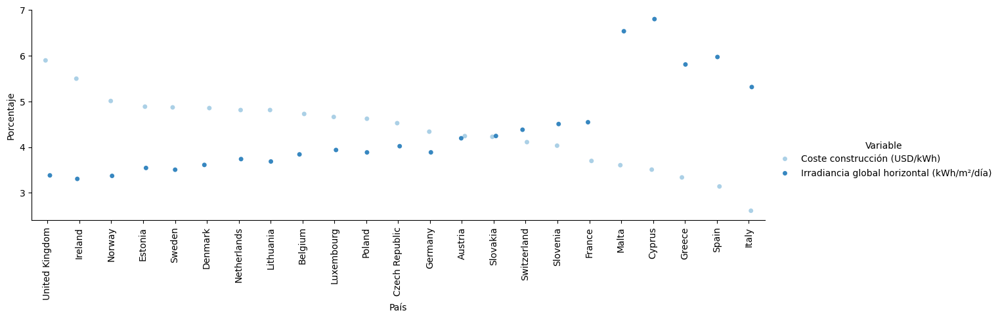

              País                      Variable   Valor  Porcentaje
7   United Kingdom  Coste construcción (USD/kWh)  0.1521    5.896034
2          Ireland  Coste construcción (USD/kWh)  0.1418    5.496763
0           Norway  Coste construcción (USD/kWh)  0.1292    5.008334
17         Estonia  Coste construcción (USD/kWh)  0.1260    4.884289
4           Sweden  Coste construcción (USD/kWh)  0.1256    4.868783
6          Denmark  Coste construcción (USD/kWh)  0.1252    4.853278
5      Netherlands  Coste construcción (USD/kWh)  0.1241    4.810637
21       Lithuania  Coste construcción (USD/kWh)  0.1241    4.810637
8          Belgium  Coste construcción (USD/kWh)  0.1219    4.725356
10      Luxembourg  Coste construcción (USD/kWh)  0.1202    4.659457
20          Poland  Coste construcción (USD/kWh)  0.1192    4.620692
14  Czech Republic  Coste construcción (USD/kWh)  0.1167    4.523782
3          Germany  Coste construcción (USD/kWh)  0.1119    4.337714
9          Austria  Coste construc

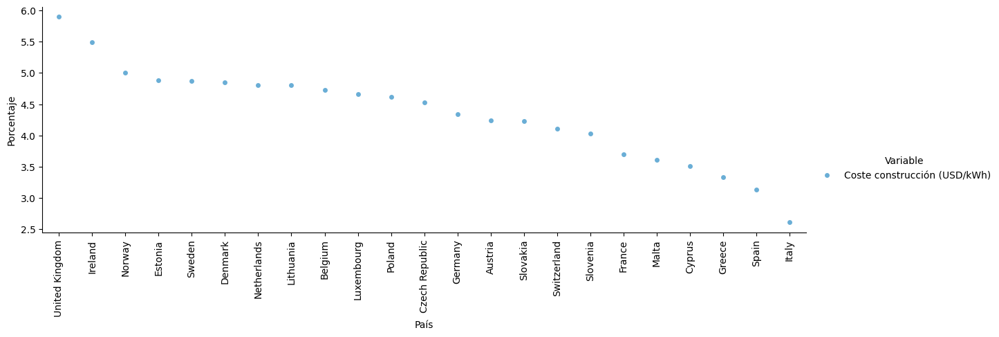

              País                             Variable       Valor  \
7   United Kingdom         Coste construcción (USD/kWh)    0.152100   
2          Ireland         Coste construcción (USD/kWh)    0.141800   
0           Norway         Coste construcción (USD/kWh)    0.129200   
17         Estonia         Coste construcción (USD/kWh)    0.126000   
4           Sweden         Coste construcción (USD/kWh)    0.125600   
6          Denmark         Coste construcción (USD/kWh)    0.125200   
5      Netherlands         Coste construcción (USD/kWh)    0.124100   
21       Lithuania         Coste construcción (USD/kWh)    0.124100   
8          Belgium         Coste construcción (USD/kWh)    0.121900   
10      Luxembourg         Coste construcción (USD/kWh)    0.120200   
20          Poland         Coste construcción (USD/kWh)    0.119200   
14  Czech Republic         Coste construcción (USD/kWh)    0.116700   
3          Germany         Coste construcción (USD/kWh)    0.111900   
9     

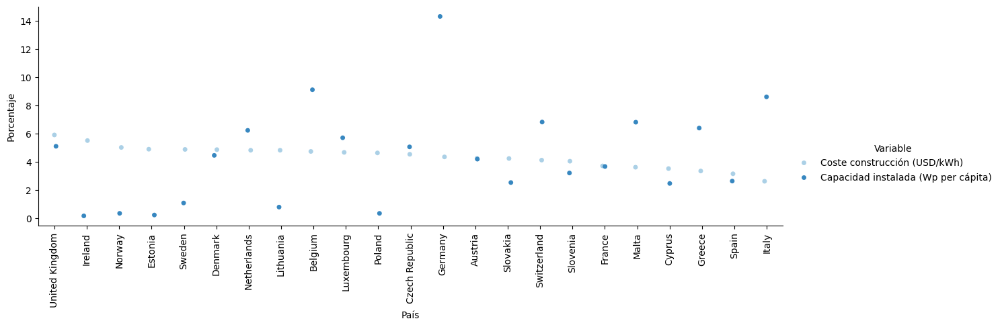

              País                          Variable         Valor  Porcentaje
7   United Kingdom      Coste construcción (USD/kWh)      0.152100    5.896034
2          Ireland      Coste construcción (USD/kWh)      0.141800    5.496763
0           Norway      Coste construcción (USD/kWh)      0.129200    5.008334
17         Estonia      Coste construcción (USD/kWh)      0.126000    4.884289
4           Sweden      Coste construcción (USD/kWh)      0.125600    4.868783
6          Denmark      Coste construcción (USD/kWh)      0.125200    4.853278
5      Netherlands      Coste construcción (USD/kWh)      0.124100    4.810637
21       Lithuania      Coste construcción (USD/kWh)      0.124100    4.810637
8          Belgium      Coste construcción (USD/kWh)      0.121900    4.725356
10      Luxembourg      Coste construcción (USD/kWh)      0.120200    4.659457
20          Poland      Coste construcción (USD/kWh)      0.119200    4.620692
14  Czech Republic      Coste construcción (USD/kWh)

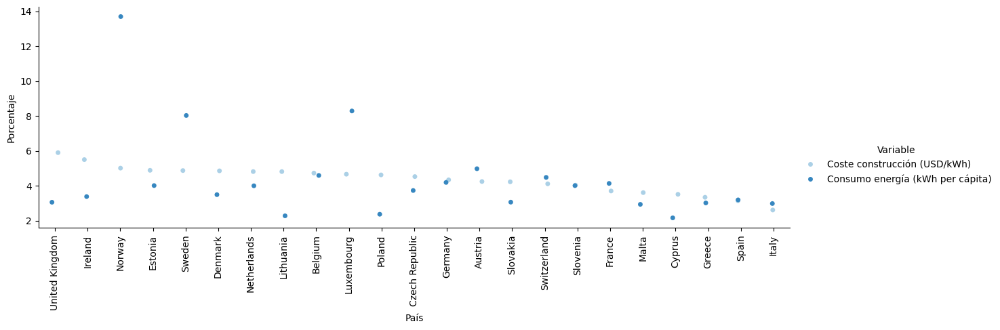

              País                      Variable    Valor  Porcentaje
7   United Kingdom  Coste construcción (USD/kWh)   0.1521    5.896034
2          Ireland  Coste construcción (USD/kWh)   0.1418    5.496763
0           Norway  Coste construcción (USD/kWh)   0.1292    5.008334
17         Estonia  Coste construcción (USD/kWh)   0.1260    4.884289
4           Sweden  Coste construcción (USD/kWh)   0.1256    4.868783
6          Denmark  Coste construcción (USD/kWh)   0.1252    4.853278
5      Netherlands  Coste construcción (USD/kWh)   0.1241    4.810637
21       Lithuania  Coste construcción (USD/kWh)   0.1241    4.810637
8          Belgium  Coste construcción (USD/kWh)   0.1219    4.725356
10      Luxembourg  Coste construcción (USD/kWh)   0.1202    4.659457
20          Poland  Coste construcción (USD/kWh)   0.1192    4.620692
14  Czech Republic  Coste construcción (USD/kWh)   0.1167    4.523782
3          Germany  Coste construcción (USD/kWh)   0.1119    4.337714
9          Austria  

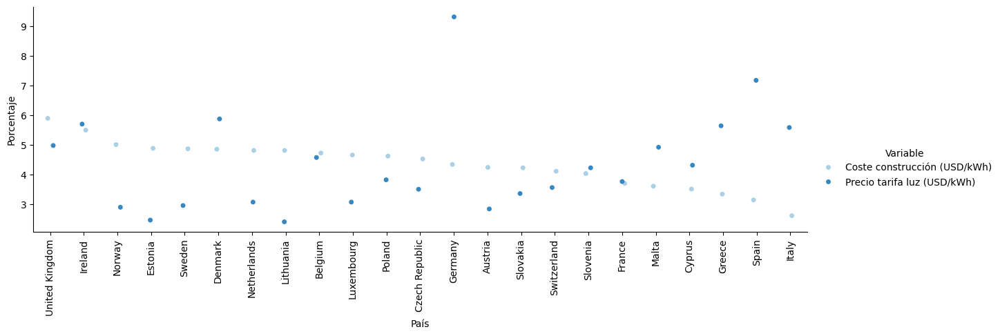

In [57]:

df_eu_melt = df_eu_final.copy()
df_eu_melt_upper = df_eu_melt.sort_values(by= ["Desarrollo humano (%)"], ascending = False)
df_eu_melt_upper = df_eu_melt_upper.loc[df_eu_melt_upper["Desarrollo humano (%)"]> 0.85]
df_eu_melt_upper

df_eu_melt_upper = df_eu_melt_upper.reset_index()
df_eu_melt_upper = df_eu_melt_upper.rename(columns={'index': 'País'})
df_eu_melt_upper

for ele in df_eu_melt_upper.columns[1:]:  # Empezar desde la segunda columna para evitar 'Pais'
    # Reorganizar el DataFrame a un formato largo
    df_melted = df_eu_melt_upper.melt(id_vars=['País'], 
                                value_vars=['Coste construcción (USD/kWh)', ele],
                                var_name='Variable', 
                                value_name='Valor')

    # Calcula la suma total de los valores para cada categoría
    suma_cap = df_melted[df_melted['Variable'] == 'Coste construcción (USD/kWh)']['Valor'].sum()
    suma_ele = df_melted[df_melted['Variable'] == ele]['Valor'].sum()

    # Crear una lista para almacenar los porcentajes
    porcentajes = []

    # Itera a través de cada fila del DataFrame y calcula el porcentaje correspondiente
    for index, row in df_melted.iterrows():
        if row['Variable'] == 'Coste construcción (USD/kWh)':
            porcentaje = (row['Valor'] / suma_cap) * 100
        else:
            porcentaje = (row['Valor'] / suma_ele) * 100
        porcentajes.append(porcentaje)

    # Añade la lista de porcentajes como una nueva columna al DataFrame
    df_melted['Porcentaje'] = porcentajes

    # Ordenar el DataFrame por Capacidad_instalada_2018 antes de graficar
    df_melted['Orden'] = df_melted.apply(
        lambda row: row['Valor'] if row['Variable'] == 'Coste construcción (USD/kWh)' else None, axis=1
    )
    df_melted = df_melted.sort_values(by='Orden', ascending=False).drop(columns='Orden')

    # Mostrar el DataFrame reorganizado con porcentajes
    print(df_melted)

    # Crear el gráfico
    g = sns.catplot(
        data=df_melted,
        hue='Variable',
        kind='strip',
        palette="Blues",
        x='País',
        y='Porcentaje',
        height=4,    # Ajusta la altura
        aspect=3)    # Ajusta el aspecto para que el ancho sea el doble de la altura

    # Rotar las etiquetas del eje x
    plt.xticks(rotation=90)

    # Mostrar la gráfica
    plt.show()

              País                             Variable         Valor  \
0           Norway  Capacidad instalada (Wp per cápita)  1.287085e+01   
1      Switzerland  Capacidad instalada (Wp per cápita)  2.637220e+02   
2          Ireland  Capacidad instalada (Wp per cápita)  5.913251e+00   
3          Germany  Capacidad instalada (Wp per cápita)  5.538545e+02   
4           Sweden  Capacidad instalada (Wp per cápita)  4.134271e+01   
5      Netherlands  Capacidad instalada (Wp per cápita)  2.408448e+02   
6          Denmark  Capacidad instalada (Wp per cápita)  1.721448e+02   
7   United Kingdom  Capacidad instalada (Wp per cápita)  1.971454e+02   
8          Belgium  Capacidad instalada (Wp per cápita)  3.524406e+02   
9          Austria  Capacidad instalada (Wp per cápita)  1.617491e+02   
10      Luxembourg  Capacidad instalada (Wp per cápita)  2.204934e+02   
11          France  Capacidad instalada (Wp per cápita)  1.415702e+02   
12        Slovenia  Capacidad instalada (Wp per cáp

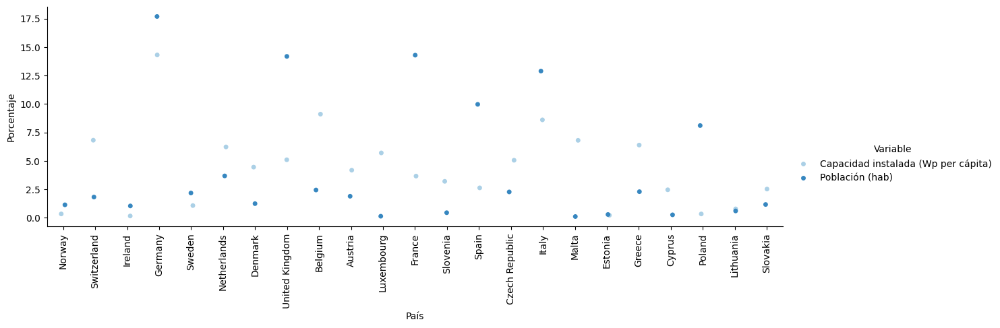

              País                             Variable          Valor  \
0           Norway  Capacidad instalada (Wp per cápita)      12.870846   
1      Switzerland  Capacidad instalada (Wp per cápita)     263.722029   
2          Ireland  Capacidad instalada (Wp per cápita)       5.913251   
3          Germany  Capacidad instalada (Wp per cápita)     553.854467   
4           Sweden  Capacidad instalada (Wp per cápita)      41.342705   
5      Netherlands  Capacidad instalada (Wp per cápita)     240.844751   
6          Denmark  Capacidad instalada (Wp per cápita)     172.144769   
7   United Kingdom  Capacidad instalada (Wp per cápita)     197.145419   
8          Belgium  Capacidad instalada (Wp per cápita)     352.440556   
9          Austria  Capacidad instalada (Wp per cápita)     161.749069   
10      Luxembourg  Capacidad instalada (Wp per cápita)     220.493379   
11          France  Capacidad instalada (Wp per cápita)     141.570237   
12        Slovenia  Capacidad instalad

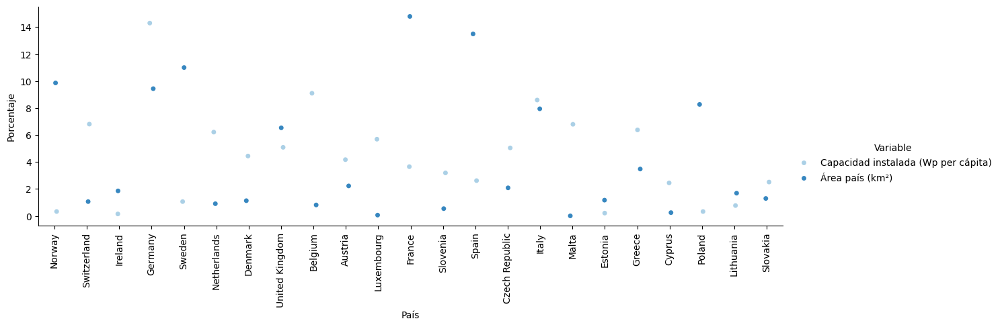

              País                             Variable       Valor  \
0           Norway  Capacidad instalada (Wp per cápita)   12.870846   
1      Switzerland  Capacidad instalada (Wp per cápita)  263.722029   
2          Ireland  Capacidad instalada (Wp per cápita)    5.913251   
3          Germany  Capacidad instalada (Wp per cápita)  553.854467   
4           Sweden  Capacidad instalada (Wp per cápita)   41.342705   
5      Netherlands  Capacidad instalada (Wp per cápita)  240.844751   
6          Denmark  Capacidad instalada (Wp per cápita)  172.144769   
7   United Kingdom  Capacidad instalada (Wp per cápita)  197.145419   
8          Belgium  Capacidad instalada (Wp per cápita)  352.440556   
9          Austria  Capacidad instalada (Wp per cápita)  161.749069   
10      Luxembourg  Capacidad instalada (Wp per cápita)  220.493379   
11          France  Capacidad instalada (Wp per cápita)  141.570237   
12        Slovenia  Capacidad instalada (Wp per cápita)  123.731965   
13    

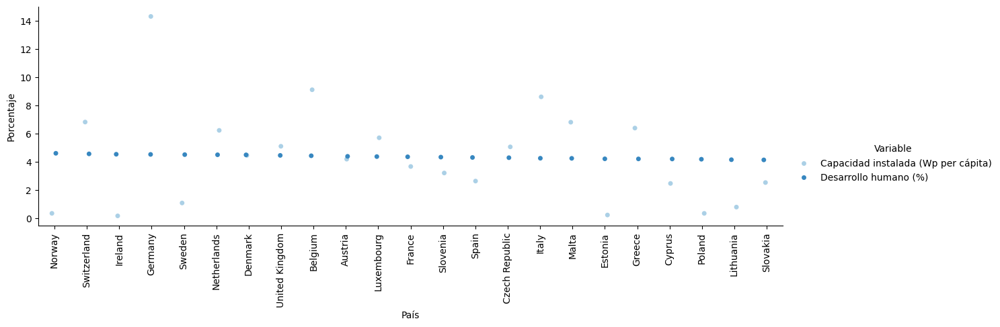

              País                             Variable          Valor  \
0           Norway  Capacidad instalada (Wp per cápita)      12.870846   
1      Switzerland  Capacidad instalada (Wp per cápita)     263.722029   
2          Ireland  Capacidad instalada (Wp per cápita)       5.913251   
3          Germany  Capacidad instalada (Wp per cápita)     553.854467   
4           Sweden  Capacidad instalada (Wp per cápita)      41.342705   
5      Netherlands  Capacidad instalada (Wp per cápita)     240.844751   
6          Denmark  Capacidad instalada (Wp per cápita)     172.144769   
7   United Kingdom  Capacidad instalada (Wp per cápita)     197.145419   
8          Belgium  Capacidad instalada (Wp per cápita)     352.440556   
9          Austria  Capacidad instalada (Wp per cápita)     161.749069   
10      Luxembourg  Capacidad instalada (Wp per cápita)     220.493379   
11          France  Capacidad instalada (Wp per cápita)     141.570237   
12        Slovenia  Capacidad instalad

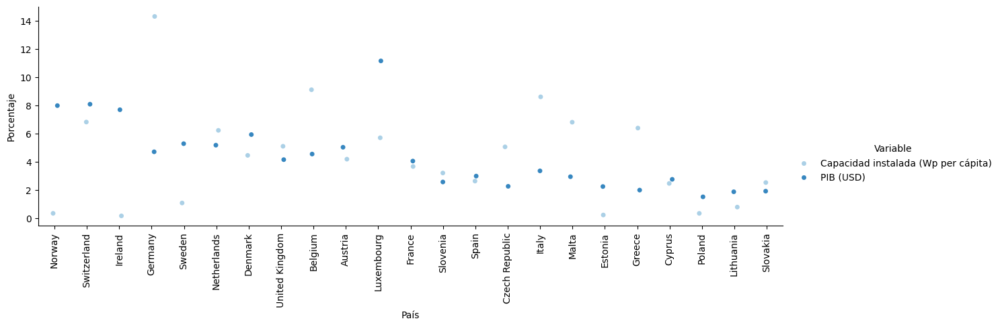

              País                             Variable        Valor  \
0           Norway  Capacidad instalada (Wp per cápita)    12.870846   
1      Switzerland  Capacidad instalada (Wp per cápita)   263.722029   
2          Ireland  Capacidad instalada (Wp per cápita)     5.913251   
3          Germany  Capacidad instalada (Wp per cápita)   553.854467   
4           Sweden  Capacidad instalada (Wp per cápita)    41.342705   
5      Netherlands  Capacidad instalada (Wp per cápita)   240.844751   
6          Denmark  Capacidad instalada (Wp per cápita)   172.144769   
7   United Kingdom  Capacidad instalada (Wp per cápita)   197.145419   
8          Belgium  Capacidad instalada (Wp per cápita)   352.440556   
9          Austria  Capacidad instalada (Wp per cápita)   161.749069   
10      Luxembourg  Capacidad instalada (Wp per cápita)   220.493379   
11          France  Capacidad instalada (Wp per cápita)   141.570237   
12        Slovenia  Capacidad instalada (Wp per cápita)   123.73

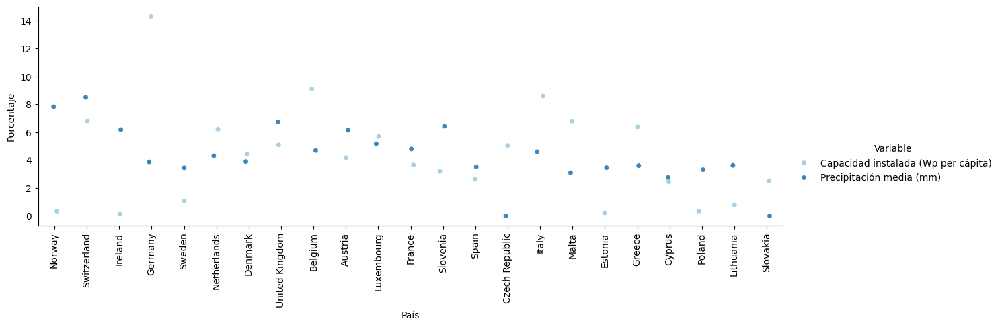

              País                                    Variable       Valor  \
0           Norway         Capacidad instalada (Wp per cápita)   12.870846   
1      Switzerland         Capacidad instalada (Wp per cápita)  263.722029   
2          Ireland         Capacidad instalada (Wp per cápita)    5.913251   
3          Germany         Capacidad instalada (Wp per cápita)  553.854467   
4           Sweden         Capacidad instalada (Wp per cápita)   41.342705   
5      Netherlands         Capacidad instalada (Wp per cápita)  240.844751   
6          Denmark         Capacidad instalada (Wp per cápita)  172.144769   
7   United Kingdom         Capacidad instalada (Wp per cápita)  197.145419   
8          Belgium         Capacidad instalada (Wp per cápita)  352.440556   
9          Austria         Capacidad instalada (Wp per cápita)  161.749069   
10      Luxembourg         Capacidad instalada (Wp per cápita)  220.493379   
11          France         Capacidad instalada (Wp per cápita)  

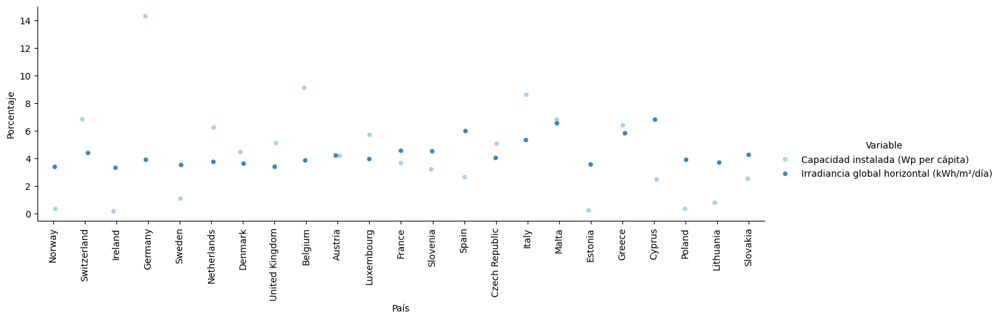

              País                             Variable       Valor  \
0           Norway  Capacidad instalada (Wp per cápita)   12.870846   
1      Switzerland  Capacidad instalada (Wp per cápita)  263.722029   
2          Ireland  Capacidad instalada (Wp per cápita)    5.913251   
3          Germany  Capacidad instalada (Wp per cápita)  553.854467   
4           Sweden  Capacidad instalada (Wp per cápita)   41.342705   
5      Netherlands  Capacidad instalada (Wp per cápita)  240.844751   
6          Denmark  Capacidad instalada (Wp per cápita)  172.144769   
7   United Kingdom  Capacidad instalada (Wp per cápita)  197.145419   
8          Belgium  Capacidad instalada (Wp per cápita)  352.440556   
9          Austria  Capacidad instalada (Wp per cápita)  161.749069   
10      Luxembourg  Capacidad instalada (Wp per cápita)  220.493379   
11          France  Capacidad instalada (Wp per cápita)  141.570237   
12        Slovenia  Capacidad instalada (Wp per cápita)  123.731965   
13    

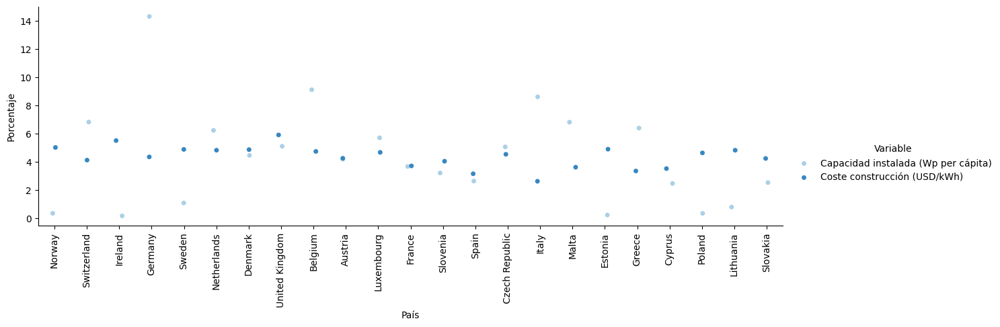

              País                             Variable       Valor  \
0           Norway  Capacidad instalada (Wp per cápita)   12.870846   
1      Switzerland  Capacidad instalada (Wp per cápita)  263.722029   
2          Ireland  Capacidad instalada (Wp per cápita)    5.913251   
3          Germany  Capacidad instalada (Wp per cápita)  553.854467   
4           Sweden  Capacidad instalada (Wp per cápita)   41.342705   
5      Netherlands  Capacidad instalada (Wp per cápita)  240.844751   
6          Denmark  Capacidad instalada (Wp per cápita)  172.144769   
7   United Kingdom  Capacidad instalada (Wp per cápita)  197.145419   
8          Belgium  Capacidad instalada (Wp per cápita)  352.440556   
9          Austria  Capacidad instalada (Wp per cápita)  161.749069   
10      Luxembourg  Capacidad instalada (Wp per cápita)  220.493379   
11          France  Capacidad instalada (Wp per cápita)  141.570237   
12        Slovenia  Capacidad instalada (Wp per cápita)  123.731965   
13    

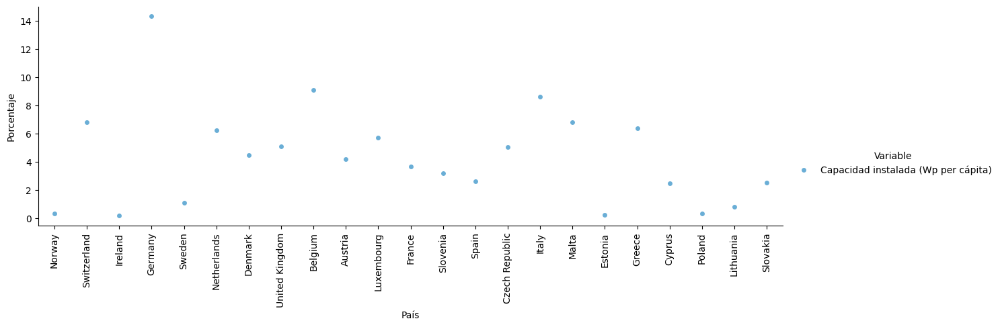

              País                             Variable         Valor  \
0           Norway  Capacidad instalada (Wp per cápita)     12.870846   
1      Switzerland  Capacidad instalada (Wp per cápita)    263.722029   
2          Ireland  Capacidad instalada (Wp per cápita)      5.913251   
3          Germany  Capacidad instalada (Wp per cápita)    553.854467   
4           Sweden  Capacidad instalada (Wp per cápita)     41.342705   
5      Netherlands  Capacidad instalada (Wp per cápita)    240.844751   
6          Denmark  Capacidad instalada (Wp per cápita)    172.144769   
7   United Kingdom  Capacidad instalada (Wp per cápita)    197.145419   
8          Belgium  Capacidad instalada (Wp per cápita)    352.440556   
9          Austria  Capacidad instalada (Wp per cápita)    161.749069   
10      Luxembourg  Capacidad instalada (Wp per cápita)    220.493379   
11          France  Capacidad instalada (Wp per cápita)    141.570237   
12        Slovenia  Capacidad instalada (Wp per cáp

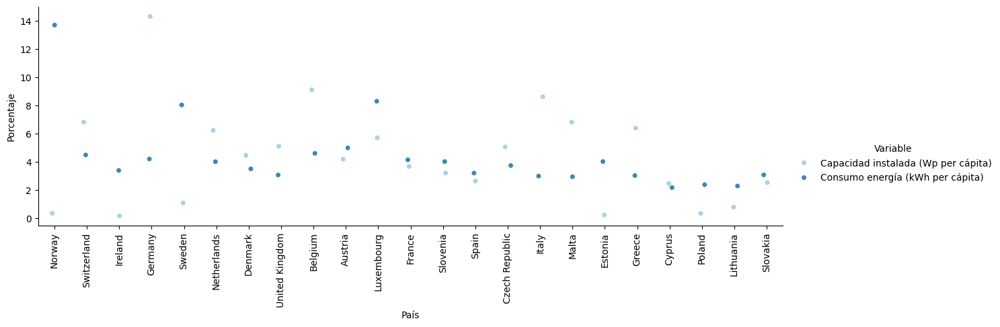

              País                             Variable       Valor  \
0           Norway  Capacidad instalada (Wp per cápita)   12.870846   
1      Switzerland  Capacidad instalada (Wp per cápita)  263.722029   
2          Ireland  Capacidad instalada (Wp per cápita)    5.913251   
3          Germany  Capacidad instalada (Wp per cápita)  553.854467   
4           Sweden  Capacidad instalada (Wp per cápita)   41.342705   
5      Netherlands  Capacidad instalada (Wp per cápita)  240.844751   
6          Denmark  Capacidad instalada (Wp per cápita)  172.144769   
7   United Kingdom  Capacidad instalada (Wp per cápita)  197.145419   
8          Belgium  Capacidad instalada (Wp per cápita)  352.440556   
9          Austria  Capacidad instalada (Wp per cápita)  161.749069   
10      Luxembourg  Capacidad instalada (Wp per cápita)  220.493379   
11          France  Capacidad instalada (Wp per cápita)  141.570237   
12        Slovenia  Capacidad instalada (Wp per cápita)  123.731965   
13    

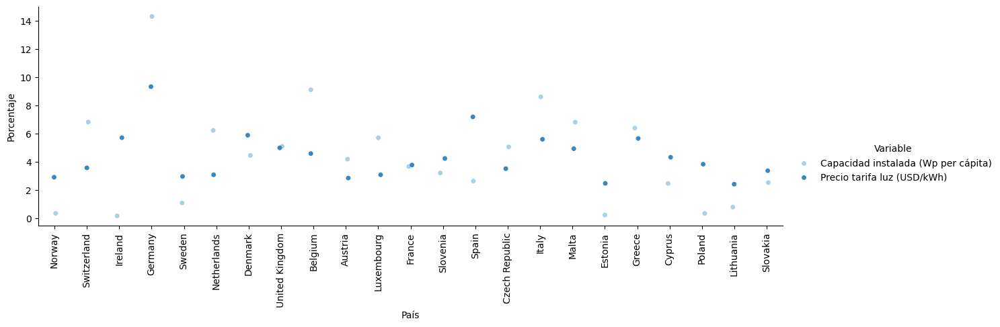

In [58]:

df_eu_melt = df_eu_final.copy()
df_eu_melt_upper = df_eu_melt.sort_values(by= ["Desarrollo humano (%)"], ascending = False)
df_eu_melt_upper = df_eu_melt_upper.loc[df_eu_melt_upper["Desarrollo humano (%)"]> 0.85]
df_eu_melt_upper

df_eu_melt_upper = df_eu_melt_upper.reset_index()
df_eu_melt_upper = df_eu_melt_upper.rename(columns={'index': 'País'})
df_eu_melt_upper

for ele in df_eu_melt_upper.columns[1:]:  # Empezar desde la segunda columna para evitar 'Pais'
    # Reorganizar el DataFrame a un formato largo
    df_melted = df_eu_melt_upper.melt(id_vars=['País'], 
                                value_vars=['Capacidad instalada (Wp per cápita)', ele],
                                var_name='Variable', 
                                value_name='Valor')

    # Calcula la suma total de los valores para cada categoría
    suma_cap = df_melted[df_melted['Variable'] == 'Capacidad instalada (Wp per cápita)']['Valor'].sum()
    suma_ele = df_melted[df_melted['Variable'] == ele]['Valor'].sum()

    # Crear una lista para almacenar los porcentajes
    porcentajes = []

    # Itera a través de cada fila del DataFrame y calcula el porcentaje correspondiente
    for index, row in df_melted.iterrows():
        if row['Variable'] == 'Capacidad instalada (Wp per cápita)':
            porcentaje = (row['Valor'] / suma_cap) * 100
        else:
            porcentaje = (row['Valor'] / suma_ele) * 100
        porcentajes.append(porcentaje)

    # Añade la lista de porcentajes como una nueva columna al DataFrame
    df_melted['Porcentaje'] = porcentajes

    # Ordenar el DataFrame por Capacidad_instalada_2018 antes de graficar
    df_melted['Orden'] = df_melted.apply(
        lambda row: row['Valor'] if row['Variable'] == 'Capacidad_instalada_2018' else None, axis=1
    )
    df_melted = df_melted.sort_values(by='Orden', ascending=False).drop(columns='Orden')

    # Mostrar el DataFrame reorganizado con porcentajes
    print(df_melted)

    # Crear el gráfico
    g = sns.catplot(
        data=df_melted,
        hue='Variable',
        kind='strip',
        palette="Blues",
        x='País',
        y='Porcentaje',
        height=4,    # Ajusta la altura
        aspect=3)    # Ajusta el aspecto para que el ancho sea el doble de la altura

    # Rotar las etiquetas del eje x
    plt.xticks(rotation=90)

    # Mostrar la gráfica
    plt.show()

              País                             Variable         Valor  \
0          Germany  Capacidad instalada (Wp per cápita)  5.538545e+02   
1          Belgium  Capacidad instalada (Wp per cápita)  3.524406e+02   
2            Italy  Capacidad instalada (Wp per cápita)  3.329401e+02   
3      Switzerland  Capacidad instalada (Wp per cápita)  2.637220e+02   
4            Malta  Capacidad instalada (Wp per cápita)  2.632722e+02   
5           Greece  Capacidad instalada (Wp per cápita)  2.471646e+02   
6      Netherlands  Capacidad instalada (Wp per cápita)  2.408448e+02   
7       Luxembourg  Capacidad instalada (Wp per cápita)  2.204934e+02   
8   United Kingdom  Capacidad instalada (Wp per cápita)  1.971454e+02   
9   Czech Republic  Capacidad instalada (Wp per cápita)  1.955166e+02   
10         Denmark  Capacidad instalada (Wp per cápita)  1.721448e+02   
11         Austria  Capacidad instalada (Wp per cápita)  1.617491e+02   
12          France  Capacidad instalada (Wp per cáp

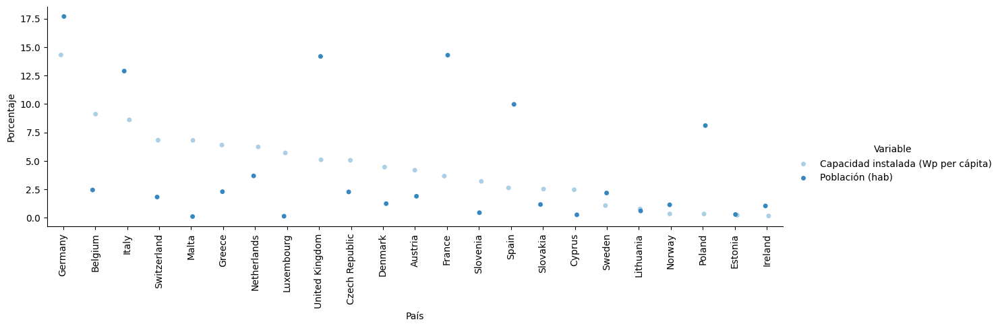

              País                             Variable          Valor  \
0          Germany  Capacidad instalada (Wp per cápita)     553.854467   
1          Belgium  Capacidad instalada (Wp per cápita)     352.440556   
2            Italy  Capacidad instalada (Wp per cápita)     332.940143   
3      Switzerland  Capacidad instalada (Wp per cápita)     263.722029   
4            Malta  Capacidad instalada (Wp per cápita)     263.272186   
5           Greece  Capacidad instalada (Wp per cápita)     247.164621   
6      Netherlands  Capacidad instalada (Wp per cápita)     240.844751   
7       Luxembourg  Capacidad instalada (Wp per cápita)     220.493379   
8   United Kingdom  Capacidad instalada (Wp per cápita)     197.145419   
9   Czech Republic  Capacidad instalada (Wp per cápita)     195.516623   
10         Denmark  Capacidad instalada (Wp per cápita)     172.144769   
11         Austria  Capacidad instalada (Wp per cápita)     161.749069   
12          France  Capacidad instalad

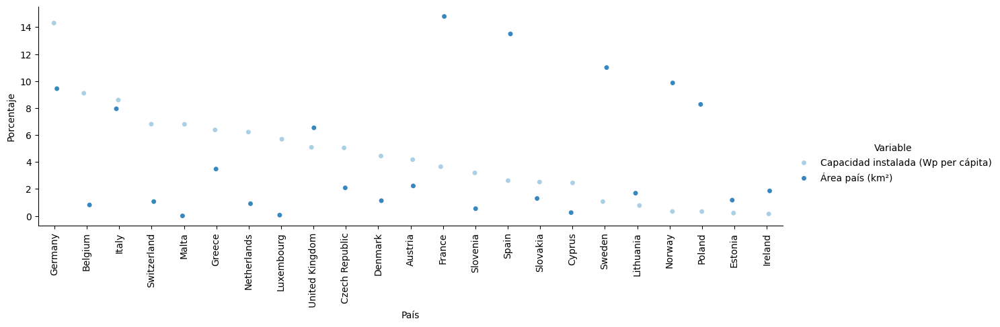

              País                             Variable       Valor  \
0          Germany  Capacidad instalada (Wp per cápita)  553.854467   
1          Belgium  Capacidad instalada (Wp per cápita)  352.440556   
2            Italy  Capacidad instalada (Wp per cápita)  332.940143   
3      Switzerland  Capacidad instalada (Wp per cápita)  263.722029   
4            Malta  Capacidad instalada (Wp per cápita)  263.272186   
5           Greece  Capacidad instalada (Wp per cápita)  247.164621   
6      Netherlands  Capacidad instalada (Wp per cápita)  240.844751   
7       Luxembourg  Capacidad instalada (Wp per cápita)  220.493379   
8   United Kingdom  Capacidad instalada (Wp per cápita)  197.145419   
9   Czech Republic  Capacidad instalada (Wp per cápita)  195.516623   
10         Denmark  Capacidad instalada (Wp per cápita)  172.144769   
11         Austria  Capacidad instalada (Wp per cápita)  161.749069   
12          France  Capacidad instalada (Wp per cápita)  141.570237   
13    

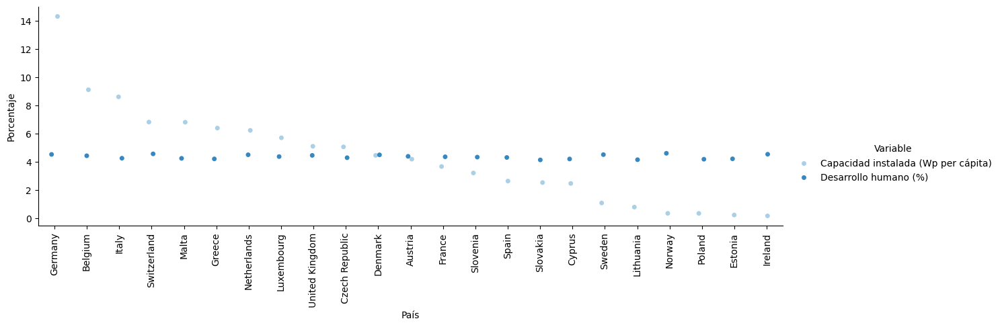

              País                             Variable          Valor  \
0          Germany  Capacidad instalada (Wp per cápita)     553.854467   
1          Belgium  Capacidad instalada (Wp per cápita)     352.440556   
2            Italy  Capacidad instalada (Wp per cápita)     332.940143   
3      Switzerland  Capacidad instalada (Wp per cápita)     263.722029   
4            Malta  Capacidad instalada (Wp per cápita)     263.272186   
5           Greece  Capacidad instalada (Wp per cápita)     247.164621   
6      Netherlands  Capacidad instalada (Wp per cápita)     240.844751   
7       Luxembourg  Capacidad instalada (Wp per cápita)     220.493379   
8   United Kingdom  Capacidad instalada (Wp per cápita)     197.145419   
9   Czech Republic  Capacidad instalada (Wp per cápita)     195.516623   
10         Denmark  Capacidad instalada (Wp per cápita)     172.144769   
11         Austria  Capacidad instalada (Wp per cápita)     161.749069   
12          France  Capacidad instalad

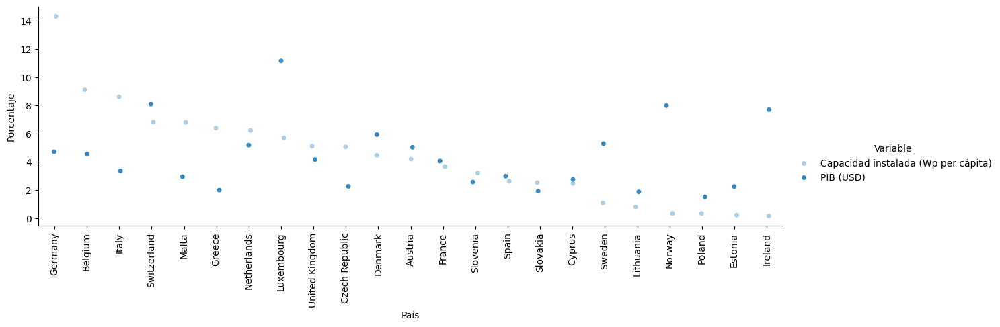

              País                             Variable        Valor  \
0          Germany  Capacidad instalada (Wp per cápita)   553.854467   
1          Belgium  Capacidad instalada (Wp per cápita)   352.440556   
2            Italy  Capacidad instalada (Wp per cápita)   332.940143   
3      Switzerland  Capacidad instalada (Wp per cápita)   263.722029   
4            Malta  Capacidad instalada (Wp per cápita)   263.272186   
5           Greece  Capacidad instalada (Wp per cápita)   247.164621   
6      Netherlands  Capacidad instalada (Wp per cápita)   240.844751   
7       Luxembourg  Capacidad instalada (Wp per cápita)   220.493379   
8   United Kingdom  Capacidad instalada (Wp per cápita)   197.145419   
9   Czech Republic  Capacidad instalada (Wp per cápita)   195.516623   
10         Denmark  Capacidad instalada (Wp per cápita)   172.144769   
11         Austria  Capacidad instalada (Wp per cápita)   161.749069   
12          France  Capacidad instalada (Wp per cápita)   141.57

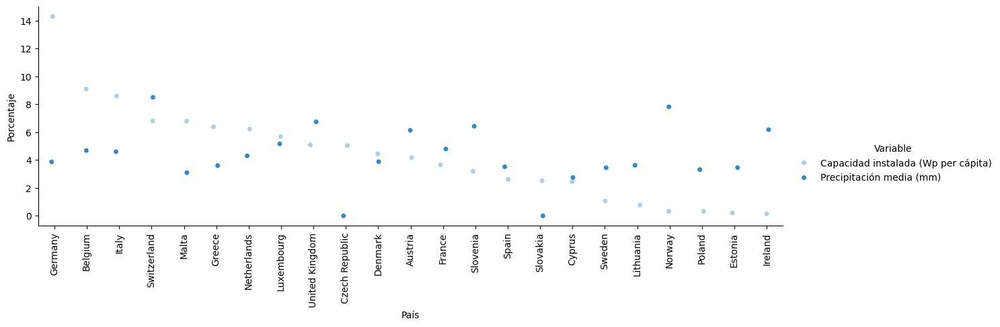

              País                                    Variable       Valor  \
0          Germany         Capacidad instalada (Wp per cápita)  553.854467   
1          Belgium         Capacidad instalada (Wp per cápita)  352.440556   
2            Italy         Capacidad instalada (Wp per cápita)  332.940143   
3      Switzerland         Capacidad instalada (Wp per cápita)  263.722029   
4            Malta         Capacidad instalada (Wp per cápita)  263.272186   
5           Greece         Capacidad instalada (Wp per cápita)  247.164621   
6      Netherlands         Capacidad instalada (Wp per cápita)  240.844751   
7       Luxembourg         Capacidad instalada (Wp per cápita)  220.493379   
8   United Kingdom         Capacidad instalada (Wp per cápita)  197.145419   
9   Czech Republic         Capacidad instalada (Wp per cápita)  195.516623   
10         Denmark         Capacidad instalada (Wp per cápita)  172.144769   
11         Austria         Capacidad instalada (Wp per cápita)  

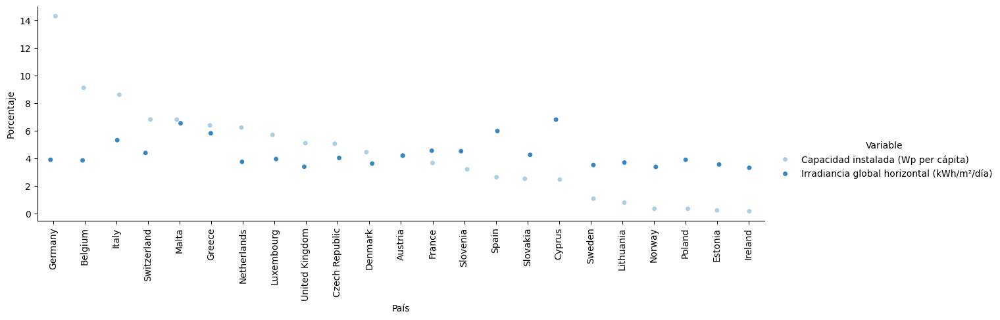

              País                             Variable       Valor  \
0          Germany  Capacidad instalada (Wp per cápita)  553.854467   
1          Belgium  Capacidad instalada (Wp per cápita)  352.440556   
2            Italy  Capacidad instalada (Wp per cápita)  332.940143   
3      Switzerland  Capacidad instalada (Wp per cápita)  263.722029   
4            Malta  Capacidad instalada (Wp per cápita)  263.272186   
5           Greece  Capacidad instalada (Wp per cápita)  247.164621   
6      Netherlands  Capacidad instalada (Wp per cápita)  240.844751   
7       Luxembourg  Capacidad instalada (Wp per cápita)  220.493379   
8   United Kingdom  Capacidad instalada (Wp per cápita)  197.145419   
9   Czech Republic  Capacidad instalada (Wp per cápita)  195.516623   
10         Denmark  Capacidad instalada (Wp per cápita)  172.144769   
11         Austria  Capacidad instalada (Wp per cápita)  161.749069   
12          France  Capacidad instalada (Wp per cápita)  141.570237   
13    

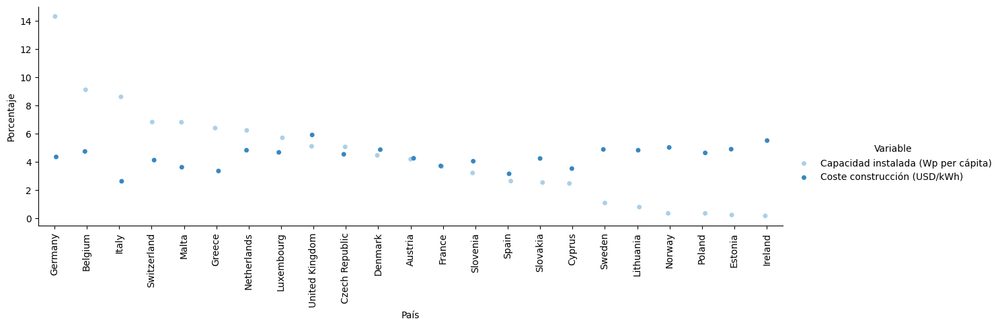

              País                             Variable       Valor  \
0          Germany  Capacidad instalada (Wp per cápita)  553.854467   
1          Belgium  Capacidad instalada (Wp per cápita)  352.440556   
2            Italy  Capacidad instalada (Wp per cápita)  332.940143   
3      Switzerland  Capacidad instalada (Wp per cápita)  263.722029   
4            Malta  Capacidad instalada (Wp per cápita)  263.272186   
5           Greece  Capacidad instalada (Wp per cápita)  247.164621   
6      Netherlands  Capacidad instalada (Wp per cápita)  240.844751   
7       Luxembourg  Capacidad instalada (Wp per cápita)  220.493379   
8   United Kingdom  Capacidad instalada (Wp per cápita)  197.145419   
9   Czech Republic  Capacidad instalada (Wp per cápita)  195.516623   
10         Denmark  Capacidad instalada (Wp per cápita)  172.144769   
11         Austria  Capacidad instalada (Wp per cápita)  161.749069   
12          France  Capacidad instalada (Wp per cápita)  141.570237   
13    

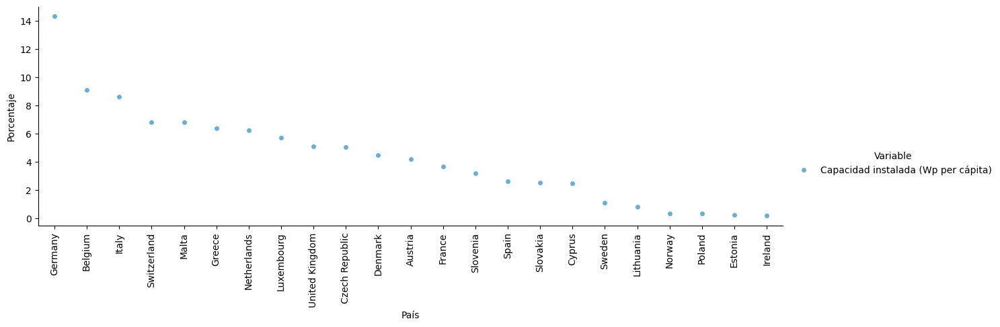

              País                             Variable         Valor  \
0          Germany  Capacidad instalada (Wp per cápita)    553.854467   
1          Belgium  Capacidad instalada (Wp per cápita)    352.440556   
2            Italy  Capacidad instalada (Wp per cápita)    332.940143   
3      Switzerland  Capacidad instalada (Wp per cápita)    263.722029   
4            Malta  Capacidad instalada (Wp per cápita)    263.272186   
5           Greece  Capacidad instalada (Wp per cápita)    247.164621   
6      Netherlands  Capacidad instalada (Wp per cápita)    240.844751   
7       Luxembourg  Capacidad instalada (Wp per cápita)    220.493379   
8   United Kingdom  Capacidad instalada (Wp per cápita)    197.145419   
9   Czech Republic  Capacidad instalada (Wp per cápita)    195.516623   
10         Denmark  Capacidad instalada (Wp per cápita)    172.144769   
11         Austria  Capacidad instalada (Wp per cápita)    161.749069   
12          France  Capacidad instalada (Wp per cáp

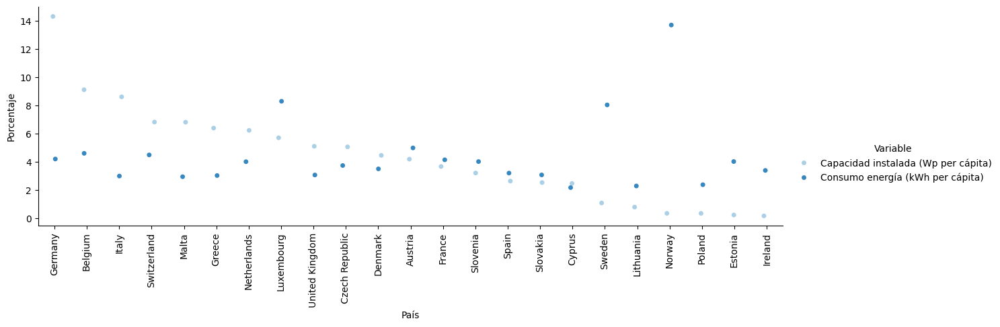

              País                             Variable       Valor  \
0          Germany  Capacidad instalada (Wp per cápita)  553.854467   
1          Belgium  Capacidad instalada (Wp per cápita)  352.440556   
2            Italy  Capacidad instalada (Wp per cápita)  332.940143   
3      Switzerland  Capacidad instalada (Wp per cápita)  263.722029   
4            Malta  Capacidad instalada (Wp per cápita)  263.272186   
5           Greece  Capacidad instalada (Wp per cápita)  247.164621   
6      Netherlands  Capacidad instalada (Wp per cápita)  240.844751   
7       Luxembourg  Capacidad instalada (Wp per cápita)  220.493379   
8   United Kingdom  Capacidad instalada (Wp per cápita)  197.145419   
9   Czech Republic  Capacidad instalada (Wp per cápita)  195.516623   
10         Denmark  Capacidad instalada (Wp per cápita)  172.144769   
11         Austria  Capacidad instalada (Wp per cápita)  161.749069   
12          France  Capacidad instalada (Wp per cápita)  141.570237   
13    

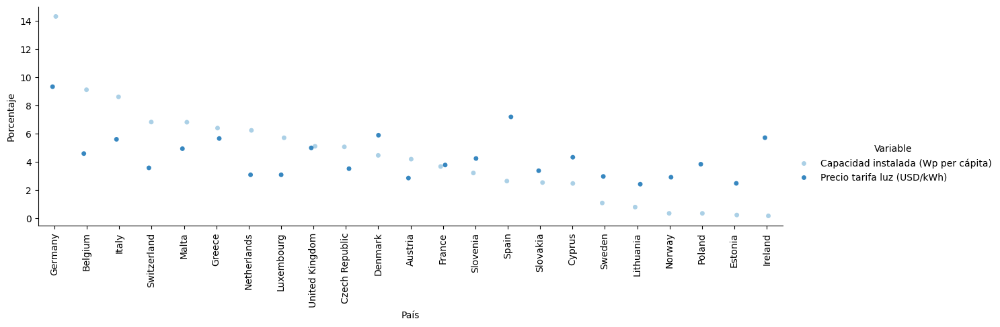

In [59]:

df_eu_melt = df_eu_final.copy()
df_eu_melt_upper = df_eu_melt.sort_values(by= ["Desarrollo humano (%)"], ascending = False)
df_eu_melt_upper = df_eu_melt_upper.loc[df_eu_melt_upper["Desarrollo humano (%)"]> 0.85]
df_eu_melt_upper

df_eu_melt_upper = df_eu_melt_upper.reset_index()
df_eu_melt_upper = df_eu_melt_upper.rename(columns={'index': 'País'})
df_eu_melt_upper

df_eu_melt_upper = df_eu_melt_upper.sort_values(by='Capacidad instalada (Wp per cápita)', ascending=False)

for ele in df_eu_melt_upper.columns[1:]:  # Empezar desde la segunda columna para evitar 'Pais'
    # Reorganizar el DataFrame a un formato largo
    df_melted = df_eu_melt_upper.melt(id_vars=['País'], 
                                value_vars=['Capacidad instalada (Wp per cápita)', ele],
                                var_name='Variable', 
                                value_name='Valor')

    # Calcula la suma total de los valores para cada categoría
    suma_cap = df_melted[df_melted['Variable'] == 'Capacidad instalada (Wp per cápita)']['Valor'].sum()
    suma_ele = df_melted[df_melted['Variable'] == ele]['Valor'].sum()

    # Crear una lista para almacenar los porcentajes
    porcentajes = []

    # Itera a través de cada fila del DataFrame y calcula el porcentaje correspondiente
    for index, row in df_melted.iterrows():
        if row['Variable'] == 'Capacidad instalada (Wp per cápita)':
            porcentaje = (row['Valor'] / suma_cap) * 100
        else:
            porcentaje = (row['Valor'] / suma_ele) * 100
        porcentajes.append(porcentaje)

    # Añade la lista de porcentajes como una nueva columna al DataFrame
    df_melted['Porcentaje'] = porcentajes

    # Ordenar el DataFrame por Capacidad_instalada_2018 antes de graficar
    df_melted['Orden'] = df_melted.apply(
        lambda row: row['Valor'] if row['Variable'] == "Capacidad instalada (Wp per cápita)" else None, axis=1
    )
    df_melted = df_melted.sort_values(by='Orden', ascending=False).drop(columns='Orden')

    # Mostrar el DataFrame reorganizado con porcentajes
    print(df_melted)

    # Crear el gráfico
    g = sns.catplot(
        data=df_melted,
        hue='Variable',
        kind='strip',
        palette="Blues",
        x='País',
        y='Porcentaje',
        height=4,    # Ajusta la altura
        aspect=3)    # Ajusta el aspecto para que el ancho sea el doble de la altura

    # Rotar las etiquetas del eje x
    plt.xticks(rotation=90)

    # Mostrar la gráfica
    plt.show()

In [60]:
#Tabla contigencia

In [61]:
df_eu_final["Capacidad instalada (Wp per cápita)"].sort_values(ascending = False)

País
Germany           553.854467
Belgium           352.440556
Italy             332.940143
Switzerland       263.722029
Malta             263.272186
Greece            247.164621
Netherlands       240.844751
Luxembourg        220.493379
United Kingdom    197.145419
Czech Republic    195.516623
Denmark           172.144769
Austria           161.749069
Bulgaria          147.432824
France            141.570237
Slovenia          123.731965
Spain             101.526528
Slovakia           97.484657
Cyprus             95.016670
Romania            70.715032
Hungary            68.073972
Portugal           65.183380
Turkey             61.502879
Ukraine            44.880930
Sweden             41.342705
Lithuania          30.040871
Belarus            16.267129
Croatia            14.916614
Norway             12.870846
Poland             12.809863
Kazakhstan         11.435451
Estonia             8.327756
Ireland             5.913251
Armenia             5.860878
Montenegro          5.463208
Azerbaija

In [62]:
#Quiero dibujar un mapa

In [63]:
import geopandas as gpd

# Cargar el shapefile
shapefile_path = './data/ne_110m_admin_0_countries.shp'
gdf_world = gpd.read_file(shapefile_path)

# Ver las primeras filas del GeoDataFrame para inspeccionar las columnas
print(gdf_world)

# # Imprimir todas las columnas
# for col in gdf_world.columns:
#     print(col)

          featurecla  scalerank  LABELRANK                   SOVEREIGNT  \
0    Admin-0 country          1          6                         Fiji   
1    Admin-0 country          1          3  United Republic of Tanzania   
2    Admin-0 country          1          7               Western Sahara   
3    Admin-0 country          1          2                       Canada   
4    Admin-0 country          1          2     United States of America   
..               ...        ...        ...                          ...   
172  Admin-0 country          1          5           Republic of Serbia   
173  Admin-0 country          1          6                   Montenegro   
174  Admin-0 country          1          6                       Kosovo   
175  Admin-0 country          1          5          Trinidad and Tobago   
176  Admin-0 country          1          3                  South Sudan   

    SOV_A3  ADM0_DIF  LEVEL               TYPE TLC  \
0      FJI         0      2  Sovereign countr

c:\Users\gema.sanz\AppData\Local\Programs\Python\Python312\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


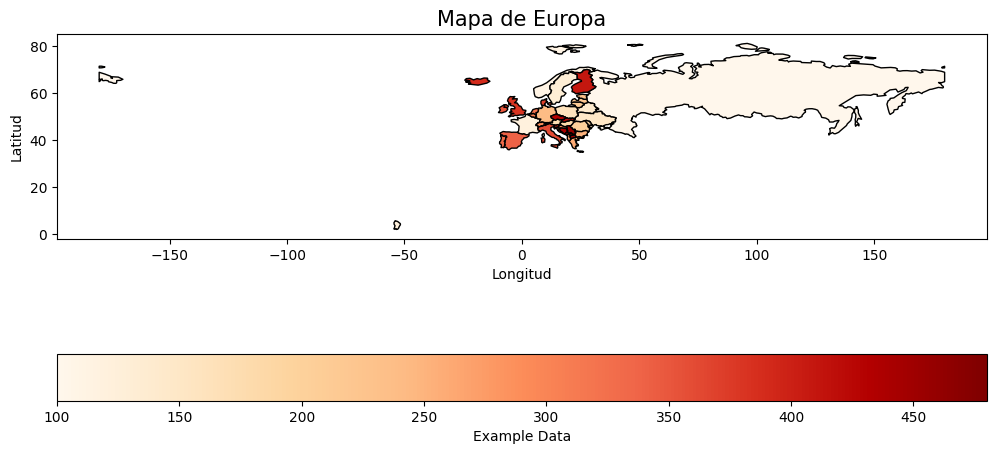

In [64]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Cargar el shapefile del mundo
gdf_world = gpd.read_file("./data/ne_110m_admin_0_countries.shp")

# Filtrar para mantener solo los países de Europa
gdf_europe = gdf_world[gdf_world['CONTINENT'] == 'Europe']

# Crear una columna de ejemplo para colorear, puedes reemplazar esto con tus propios datos
# Por ejemplo, podrías agregar una columna con datos de población, PIB, etc.
gdf_europe['example_data'] = [100 + i * 10 for i in range(len(gdf_europe))]  # Datos de ejemplo

# Crear la visualización
fig, ax = plt.subplots(figsize=(12, 10))

# Dibujar el mapa de Europa con colores basados en 'example_data'
# El parámetro 'cmap' define la paleta de colores
gdf_europe.plot(column='example_data', ax=ax, legend=True,
                legend_kwds={'label': "Example Data",
                             'orientation': "horizontal"},
                cmap='OrRd',  # Paleta de colores (puedes cambiar a tu preferencia)
                edgecolor='black')

# Ajustar los detalles del mapa
ax.set_title('Mapa de Europa', fontsize=15)
ax.set_xlabel('Longitud')
ax.set_ylabel('Latitud')

# Mostrar el mapa
plt.show()

In [65]:
df_eu_final

,Población (hab),Área país (km²),Desarrollo humano (%),PIB (USD),Precipitación media (mm),Irradiancia global horizontal (kWh/m²/día),Coste construcción (USD/kWh),Capacidad instalada (Wp per cápita),Consumo energía (kWh per cápita),Precio tarifa luz (USD/kWh)
País,,,,,,,,,,
Albania,2866376,27400.0,0.784911,5253.630064,1485.0,4.1954,0.1051,0.348873,2309.366503,8.7
Armenia,2951776,28470.0,0.755113,4212.070943,562.0,4.2241,0.1038,5.860878,1961.610395,7.6
Austria,8847037,82523.0,0.907755,51512.905475,1110.0,3.2138,0.1094,161.749069,8355.841952,9.8
Azerbaijan,9942334,82670.0,0.756965,4721.178087,447.0,4.0422,0.1116,3.661112,2202.393918,5.4
Belarus,9485386,202988.0,0.807530,6289.938553,618.0,2.9377,0.1446,16.267129,3679.978840,11.7
Belgium,11422068,30280.0,0.916066,46556.099567,847.0,2.9436,0.1219,352.440556,7709.123078,15.8
Bulgaria,7024216,108560.0,0.813006,9272.629304,608.0,3.8729,0.1147,147.432824,4708.927458,12.4
Croatia,4089400,55960.0,0.831102,14869.090682,1113.0,3.7370,0.1176,14.916614,3714.382988,17.6
Cyprus,1189265,9240.0,0.868784,28159.301700,498.0,5.2104,0.0905,95.016670,3624.971253,14.9


In [66]:
df_eu_final

,Población (hab),Área país (km²),Desarrollo humano (%),PIB (USD),Precipitación media (mm),Irradiancia global horizontal (kWh/m²/día),Coste construcción (USD/kWh),Capacidad instalada (Wp per cápita),Consumo energía (kWh per cápita),Precio tarifa luz (USD/kWh)
País,,,,,,,,,,
Albania,2866376,27400.0,0.784911,5253.630064,1485.0,4.1954,0.1051,0.348873,2309.366503,8.7
Armenia,2951776,28470.0,0.755113,4212.070943,562.0,4.2241,0.1038,5.860878,1961.610395,7.6
Austria,8847037,82523.0,0.907755,51512.905475,1110.0,3.2138,0.1094,161.749069,8355.841952,9.8
Azerbaijan,9942334,82670.0,0.756965,4721.178087,447.0,4.0422,0.1116,3.661112,2202.393918,5.4
Belarus,9485386,202988.0,0.807530,6289.938553,618.0,2.9377,0.1446,16.267129,3679.978840,11.7
Belgium,11422068,30280.0,0.916066,46556.099567,847.0,2.9436,0.1219,352.440556,7709.123078,15.8
Bulgaria,7024216,108560.0,0.813006,9272.629304,608.0,3.8729,0.1147,147.432824,4708.927458,12.4
Croatia,4089400,55960.0,0.831102,14869.090682,1113.0,3.7370,0.1176,14.916614,3714.382988,17.6
Cyprus,1189265,9240.0,0.868784,28159.301700,498.0,5.2104,0.0905,95.016670,3624.971253,14.9


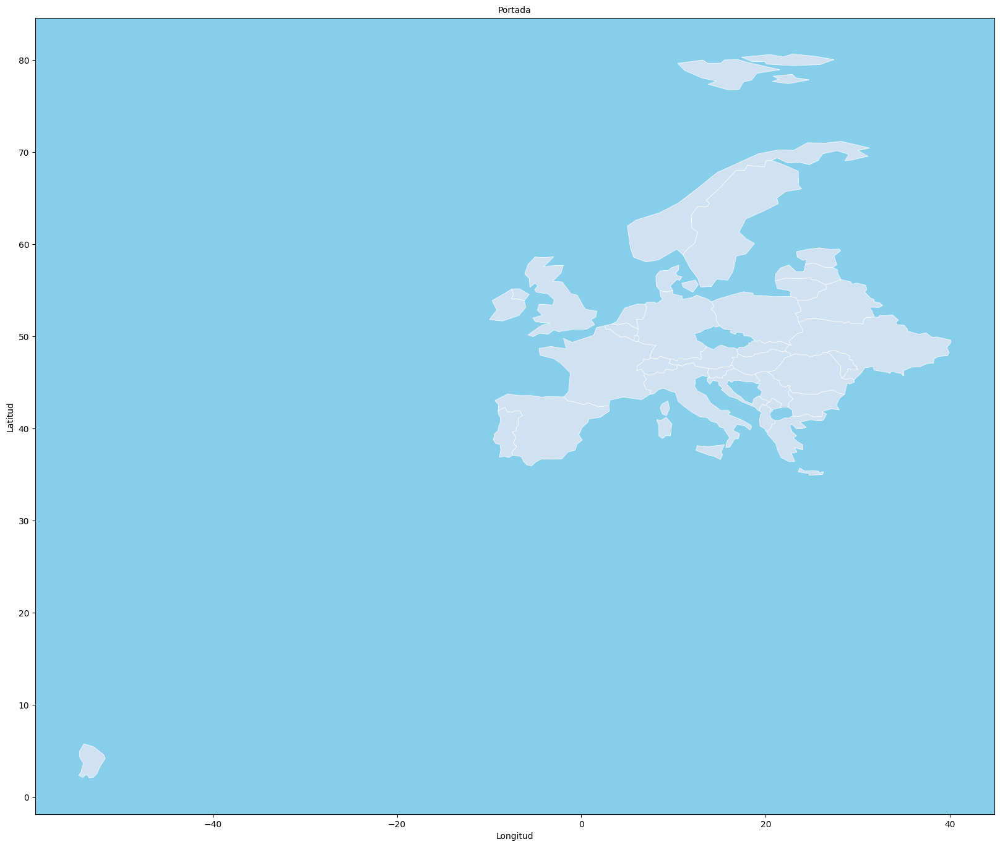

In [67]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

# Cargar dataframes
df_eu = pd.read_csv("./data/df_eu.csv")
df_eu_final = pd.read_csv("./data/df_eu_final.csv", index_col="País")

# Cargar el shapefile del mundo
gdf_mundo = gpd.read_file("./data/ne_110m_admin_0_countries.shp")

# Renombrar la columna para que coincida
gdf_mundo.rename(columns={"NAME": "País"}, inplace=True)

# Filtrar para mantener solo los países de Europa
gdf_eu = gdf_mundo[gdf_mundo['CONTINENT'] == 'Europe']

# Establecer el índice para poder unirlos
gdf_eu.set_index("País", inplace=True)

# Unir el GeoDataFrame con el DataFrame de datos
gdf_eu_final = gdf_eu.join(df_eu_final)

# Filtrar para mantener solo los países presentes en df_eu
gdf_eu_final = gdf_eu_final[gdf_eu_final.index.isin(df_eu["Pais"])]

# Crear una columna nueva para mantener color e intensidad
gdf_eu_final['color_value'] = 0.2

# Crear la visualización
fig, ax = plt.subplots(figsize=(20, 20))

# Establecer el fondo azul para el gráfico
ax.set_facecolor('skyblue')  # Puedes cambiar 'lightblue' por cualquier color que prefieras

# Dibujar el mapa de Europa con colores basados en 'color_value'
gdf_eu_final.plot(column='color_value',
                  ax=ax,
                  legend=False,
                  cmap="Blues",
                  edgecolor='white',
                  linewidth=0.5,
                  vmin=0,
                  vmax=1)

# Ajustar los detalles del mapa
ax.set_title("Portada", fontsize=10)
ax.set_xlabel('Longitud')
ax.set_ylabel('Latitud')

# Mostrar el mapa
plt.show()

Text(217.09722222222223, 0.5, 'Latitud')

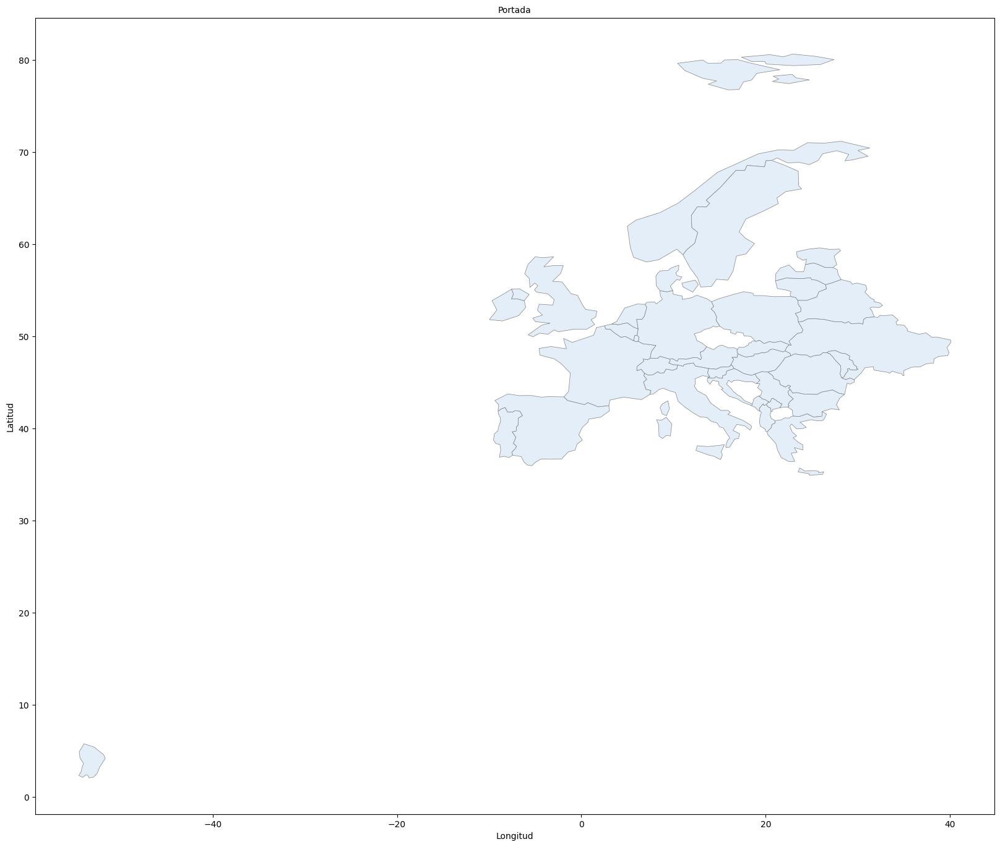

In [68]:
    # Cargar dataframes
    df_eu = pd.read_csv("./data/df_eu.csv")
    df_eu_final = pd.read_csv("./data/df_eu_final.csv",index_col= "País")
    
    gdf_mundo = gpd.read_file("./data/ne_110m_admin_0_countries.shp")

    # Renombrar la columna para que coincida
    gdf_mundo.rename(columns={"NAME": "País"}, inplace=True)

    # Filtrar para mantener solo los países de Europa
    gdf_eu = gdf_mundo[gdf_mundo['CONTINENT'] == 'Europe']

    # Establecer el índice para poder unirlos
    gdf_eu.set_index("País", inplace=True)

    # Unir el GeoDataFrame con el DataFrame de datos
    gdf_eu_final = gdf_eu.join(df_eu_final)

    # Filtrar para mantener solo los países presentes en df_eu
    gdf_eu_final = gdf_eu_final[gdf_eu_final.index.isin(df_eu["Pais"])]

   #Columna nueva para mantener color e intensidad
    gdf_eu_final['color_value'] = 0.1


    # Crear la visualización
    fig, ax = plt.subplots(figsize=(20, 20))
    
    # Dibujar el mapa de Europa con colores basados en 'dato'
    gdf_eu_final.plot(column='color_value',
                        ax=ax,
                        legend=False,
                        legend_kwds={'label': ".",
                                     'orientation': "vertical"},
                        cmap="Blues",
                        edgecolor='grey',
                        linewidth = 0.5,
                        vmin = 0,
                        vmax = 1)

    # Ajustar los detalles del mapa
    ax.set_title("Portada", fontsize=10)
    ax.set_xlabel('Longitud')
    ax.set_ylabel('Latitud')


In [69]:
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd

def mapa_europa(dato):
    # Cargar dataframes
    df_eu = pd.read_csv("./data/df_eu.csv")
    df_eu_final = pd.read_csv("./data/df_eu_final.csv",index_col= "País")
    
    # Cargar el shapefile del mundo
    gdf_mundo = gpd.read_file("./data/ne_110m_admin_0_countries.shp")

    # Renombrar la columna para que coincida
    gdf_mundo.rename(columns={"NAME": "País"}, inplace=True)

    # Filtrar para mantener solo los países de Europa
    gdf_eu = gdf_mundo[gdf_mundo['CONTINENT'] == 'Europe']

    # Establecer el índice para poder unirlos
    gdf_eu.set_index("País", inplace=True)

    # Unir el GeoDataFrame con el DataFrame de datos
    gdf_eu_final = gdf_eu.join(df_eu_final)

    # Filtrar para mantener solo los países presentes en df_eu
    gdf_eu_final = gdf_eu_final[gdf_eu_final.index.isin(df_eu["Pais"])]

    # Verificar si la columna 'dato' existe en el DataFrame unido
    if dato not in gdf_eu_final.columns:
        raise ValueError(f"La columna '{dato}' no existe en el DataFrame.")
        
    # Crear la visualización
    fig, ax = plt.subplots(figsize=(20, 20))
    
    # Dibujar el mapa de Europa con colores basados en 'dato'
    gdf_eu_final.plot(column=dato,
                        ax=ax,
                        legend=True,
                        legend_kwds={'label': dato,
                                     'orientation': "vertical"},
                        cmap ="Blues",
                        edgecolor='grey',
                        linewidth = 0.5)

    # Ajustar los detalles del mapa
    ax.set_title(dato)
    ax.set_xlabel('Longitud')
    ax.set_ylabel('Latitud')

    # Mostrar el mapa

    return plt.show()

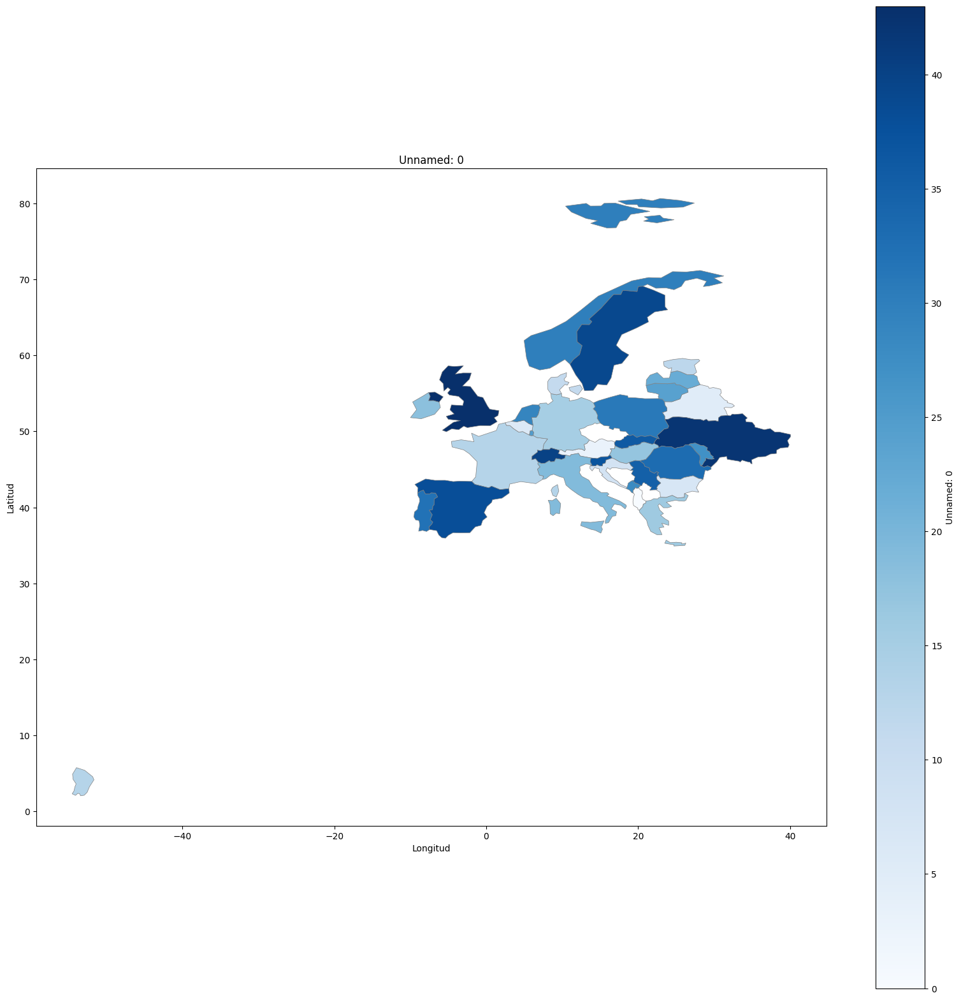

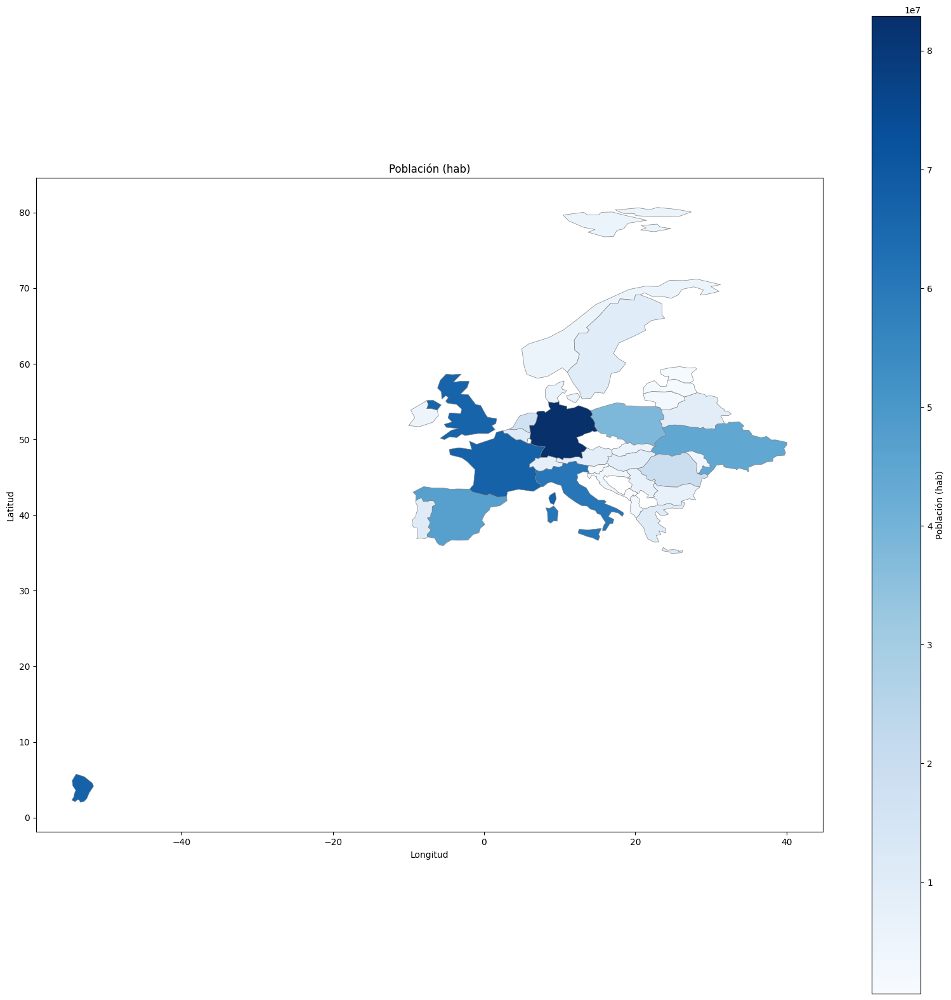

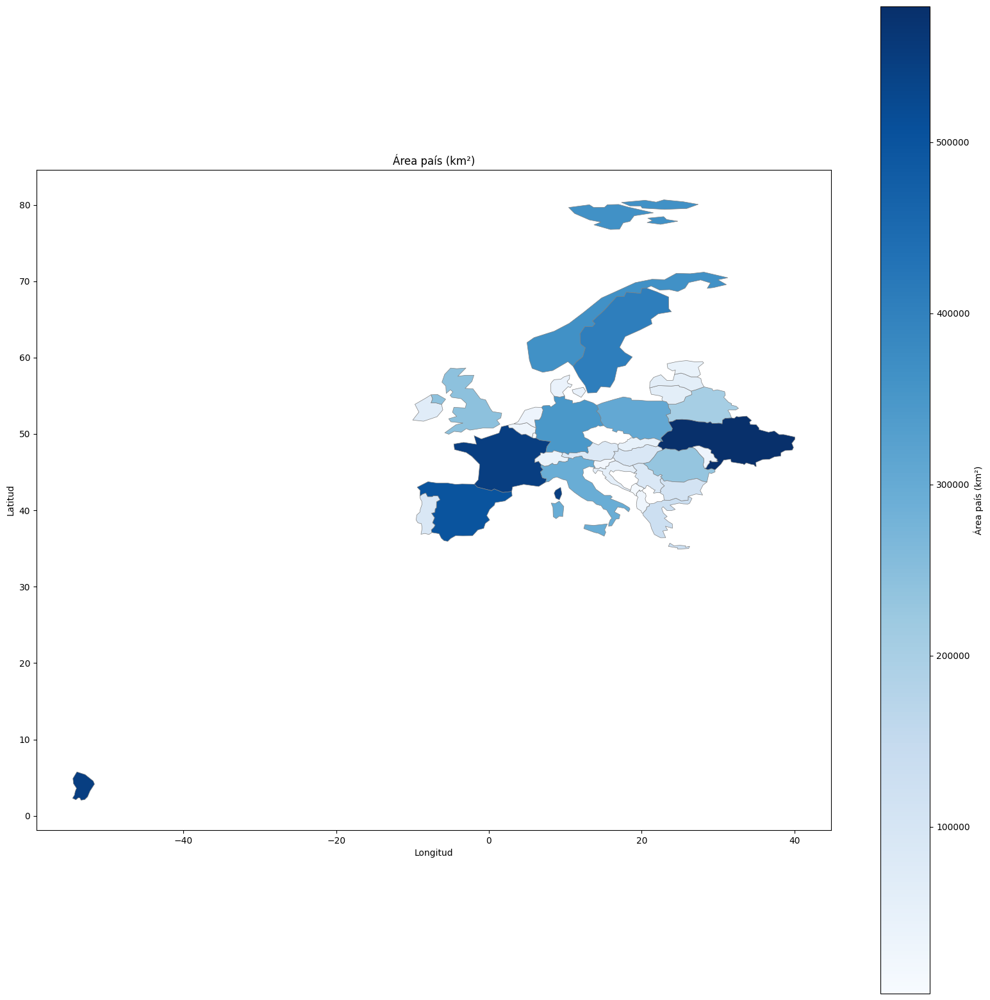

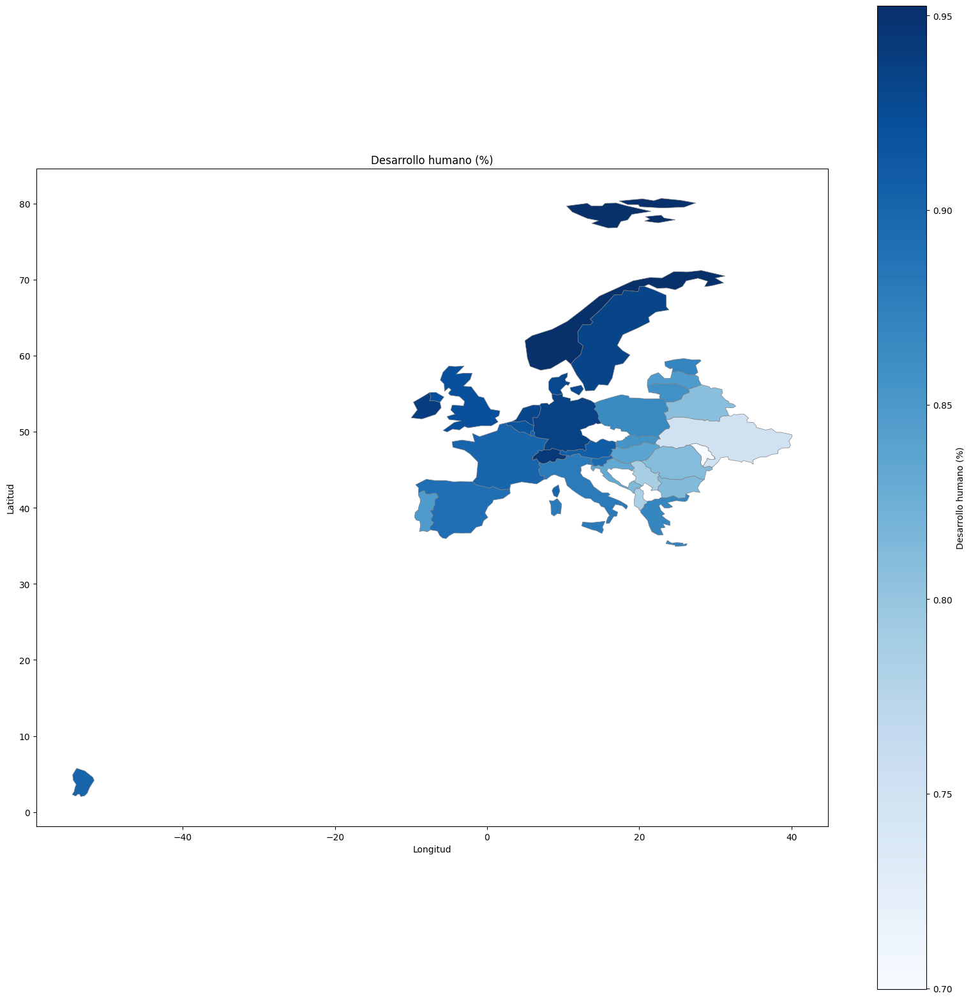

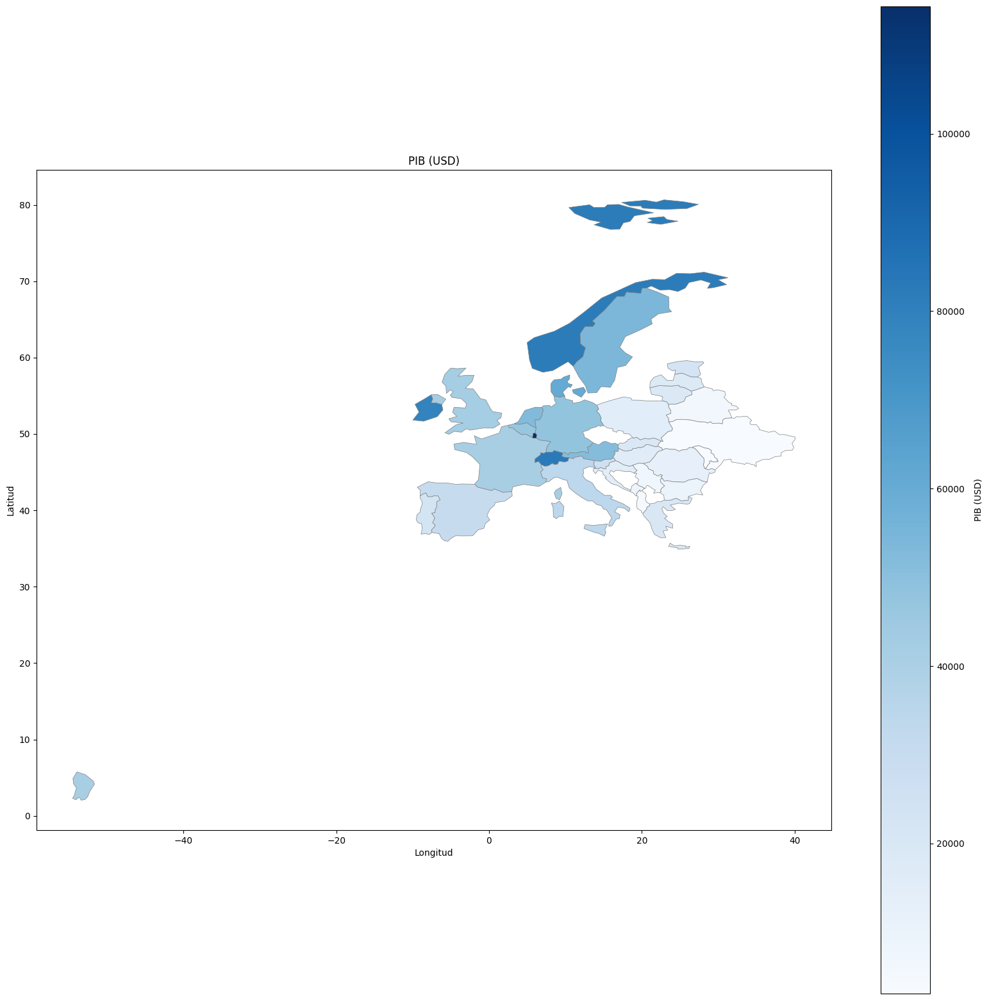

...

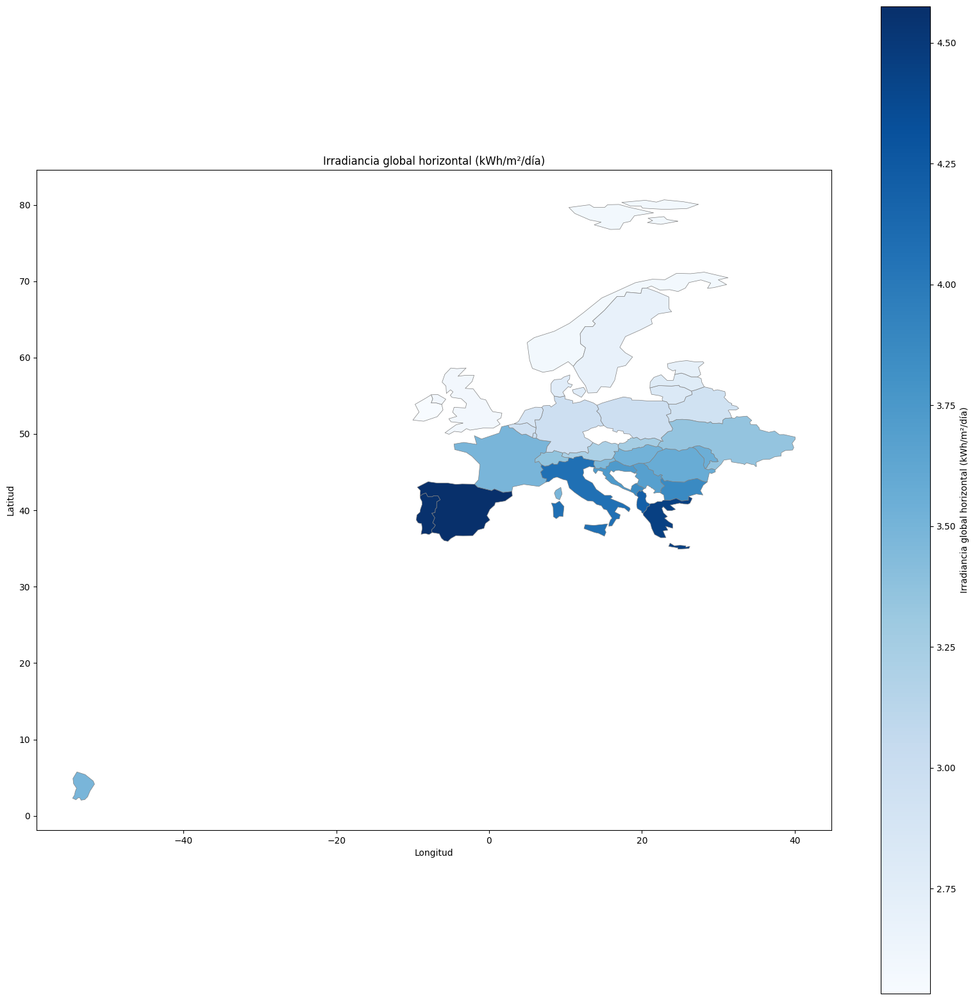

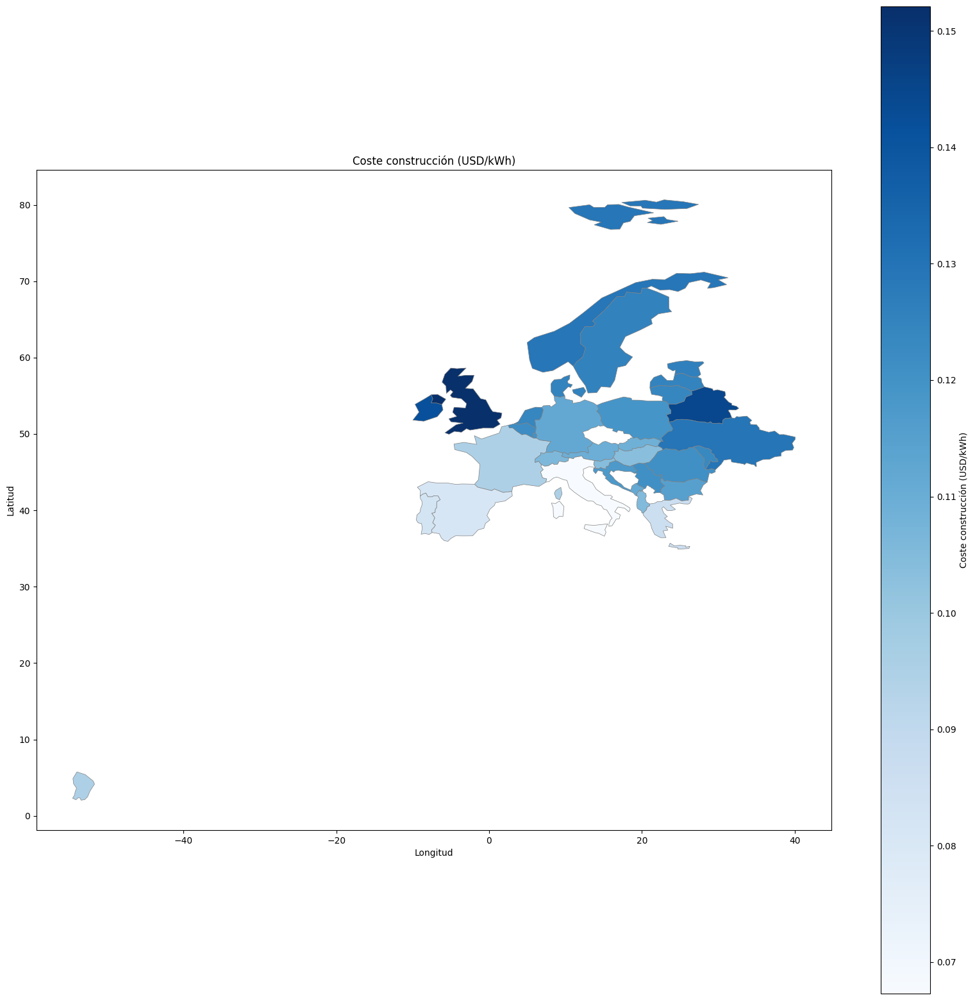

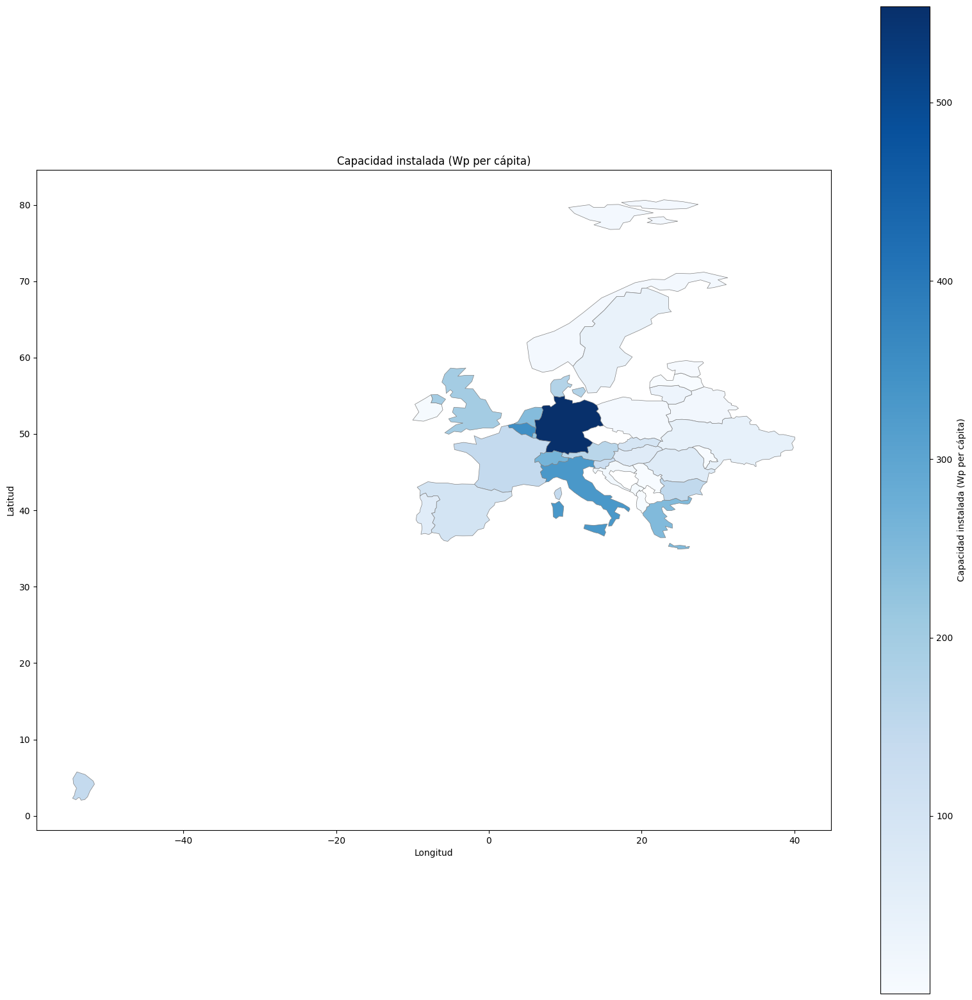

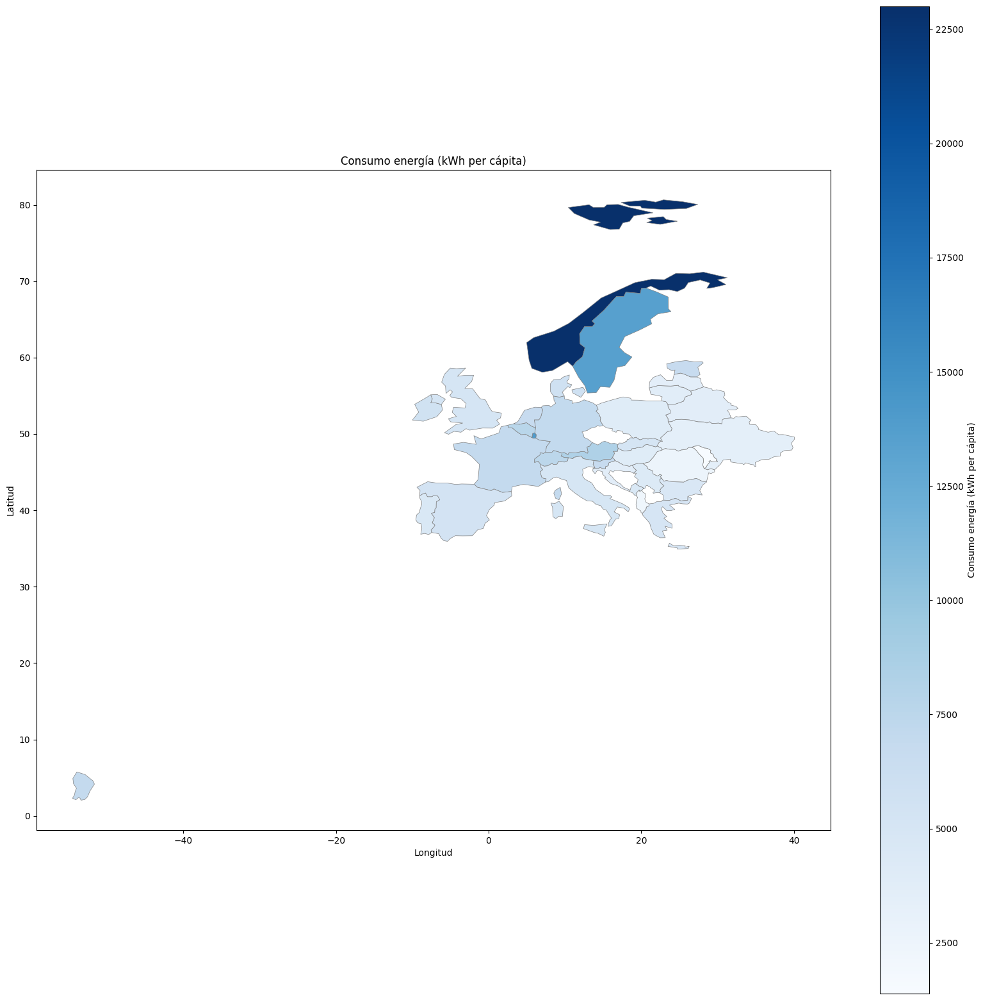

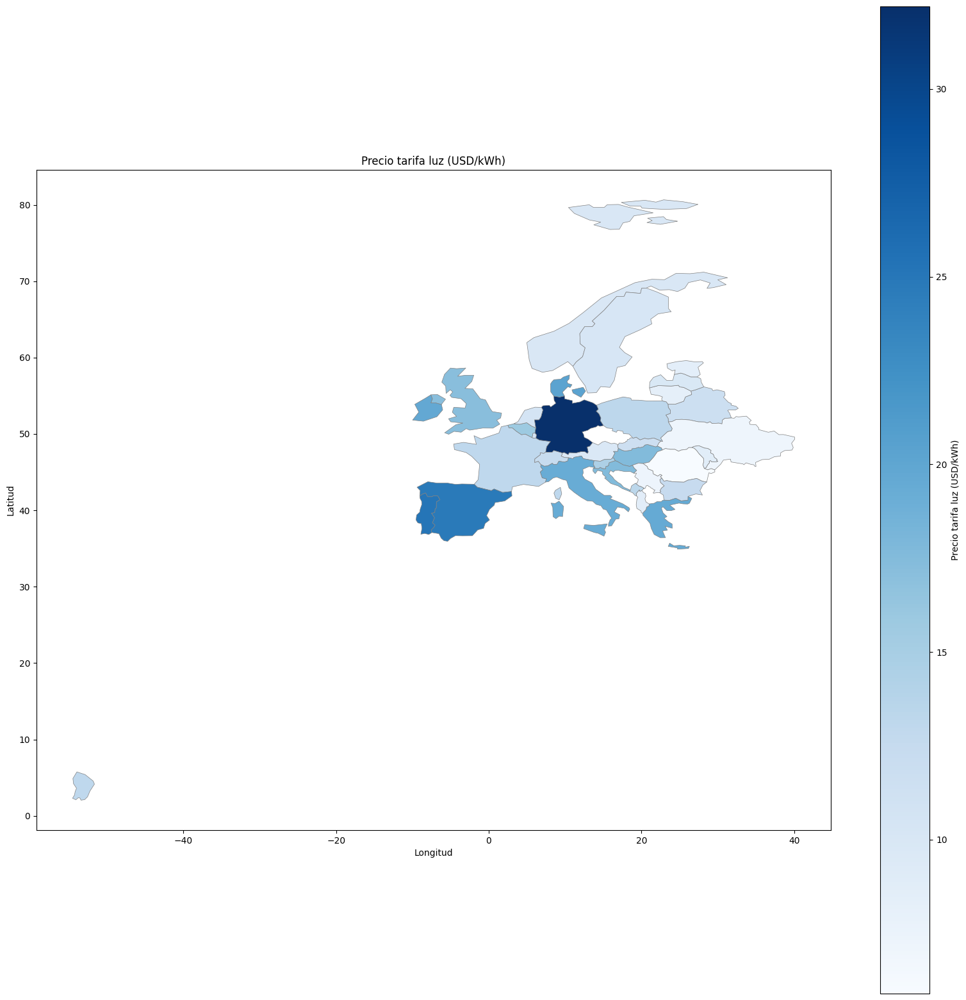

In [70]:

for elemento in df_eu_final:
    mapa_europa(elemento)

In [71]:
df_eu_final.columns

Index(['Unnamed: 0', 'Población (hab)', 'Área país (km²)',
       'Desarrollo humano (%)', 'PIB (USD)', 'Precipitación media (mm)',
       'Irradiancia global horizontal (kWh/m²/día)',
       'Coste construcción (USD/kWh)', 'Capacidad instalada (Wp per cápita)',
       'Consumo energía (kWh per cápita)', 'Precio tarifa luz (USD/kWh)'],
      dtype='object')

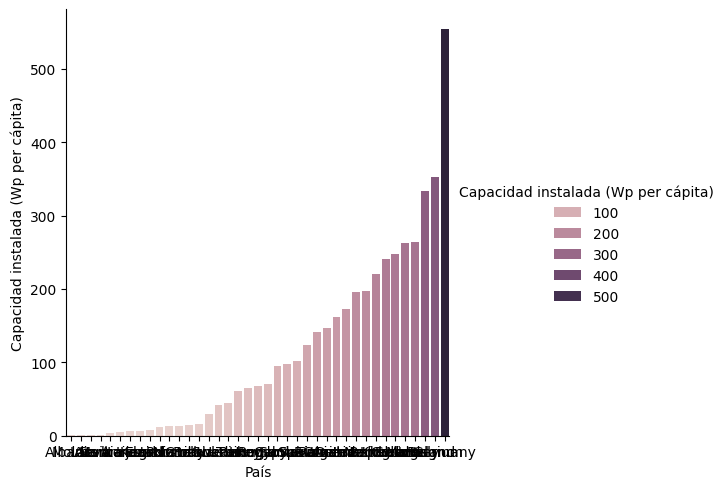

In [72]:
sns.catplot(data=df_eu_final.sort_values("Capacidad instalada (Wp per cápita)"),
            hue= 'Capacidad instalada (Wp per cápita)',
              x='País',
              y= 'Capacidad instalada (Wp per cápita)',
              kind = "bar")

In [113]:
#Haciendo separacion entre los 7 con más capacidad instalada
df_eu_capacidad_upper = df_eu_final.sort_values(by = "Capacidad instalada (Wp per cápita)",ascending= False )
df_eu_capacidad_upper_slicing = df_eu_capacidad_upper.head(15)
df_eu_capacidad_upper_slicing
df_eu_capacidad_upper["Capacidad instalada (Wp per cápita)"].median()
df_eu_capacidad_upper["Capacidad instalada (Wp per cápita)"].mean()

df_eu_capacidad_upper.columns

Index(['Unnamed: 0', 'Población (hab)', 'Área país (km²)',
       'Desarrollo humano (%)', 'PIB (USD)', 'Precipitación media (mm)',
       'Irradiancia global horizontal (kWh/m²/día)',
       'Coste construcción (USD/kWh)', 'Capacidad instalada (Wp per cápita)',
       'Consumo energía (kWh per cápita)', 'Precio tarifa luz (USD/kWh)'],
      dtype='object')

In [121]:
df_eu_capacidad_upper_comprobacion = df_eu_capacidad_upper_slicing.copy()
df_eu_capacidad_upper_comprobacion.drop(columns=['Unnamed: 0',
                                                  'Población (hab)',
                                                  'Área país (km²)',
                                                  'Desarrollo humano (%)',
                                                  'Precipitación media (mm)',
                                                  'Precio tarifa luz (USD/kWh)'], inplace=True)

df_eu_capacidad_upper_comprobacion

,PIB (USD),Irradiancia global horizontal (kWh/m²/día),Coste construcción (USD/kWh),Capacidad instalada (Wp per cápita),Consumo energía (kWh per cápita)
País,,,,,
Germany,48195.579904,2.9777,0.1119,553.854467,7035.482975
Belgium,46556.099567,2.9436,0.1219,352.440556,7709.123078
Italy,34318.351124,4.0721,0.0673,332.940143,5002.406680
Switzerland,82838.929445,3.3567,0.1060,263.722029,7520.166025
Malta,30074.741185,5.0071,0.0930,263.272186,4924.544019
Greece,20324.253564,4.4501,0.0861,247.164621,5062.606422
Netherlands,53024.059213,2.8649,0.1241,240.844751,6712.774758
Luxembourg,114340.498742,3.0173,0.1202,220.493379,13914.678449
United Kingdom,42491.364435,2.5918,0.1521,197.145419,5129.527793


In [124]:
df_eu_capacidad_upper_comprobacion.loc[df_eu_capacidad_upper_comprobacion["Coste construcción (USD/kWh)"] > 0.10 ].head(5)

,PIB (USD),Irradiancia global horizontal (kWh/m²/día),Coste construcción (USD/kWh),Capacidad instalada (Wp per cápita),Consumo energía (kWh per cápita)
País,,,,,
Germany,48195.579904,2.9777,0.1119,553.854467,7035.482975
Belgium,46556.099567,2.9436,0.1219,352.440556,7709.123078
Switzerland,82838.929445,3.3567,0.1060,263.722029,7520.166025
Netherlands,53024.059213,2.8649,0.1241,240.844751,6712.774758
Luxembourg,114340.498742,3.0173,0.1202,220.493379,13914.678449


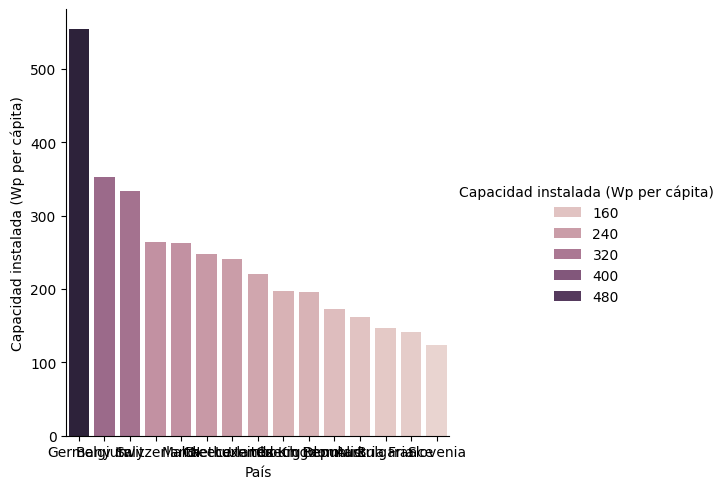

In [74]:
#7 PAISES CON MÁS CAPACIDAD INSTALADA
sns.catplot(data= df_eu_capacidad_upper_slicing.sort_values(by="Capacidad instalada (Wp per cápita)",ascending= False),
            hue= 'Capacidad instalada (Wp per cápita)',
            x='País',
            y= 'Capacidad instalada (Wp per cápita)',
            kind= "bar")

C:\Users\gema.sanz\AppData\Local\Temp\ipykernel_17688\2789358968.py:12: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  filtro_correlacion = matriz_correlacion.applymap(lambda x: x if abs(x) > porcentaje else np.nan)


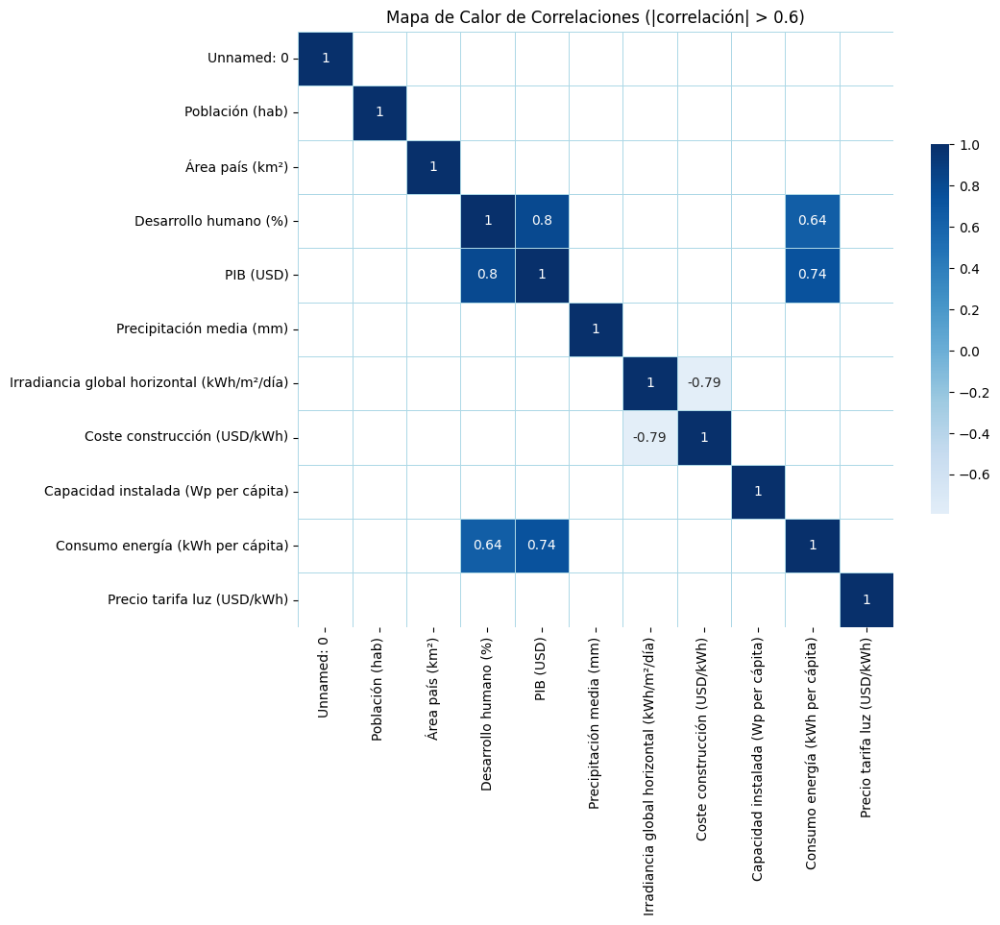

In [75]:
mapa_calor_correlacion(df_eu_capacidad_upper, 0.6)

In [76]:
#Relaciones a estudiar en grafico de dispersión con burbujas, x pais, burbuja variables, y capacidad
''' 
1. Tarifa luz vs Capacidad
2. Poblacion vs Capacidad
3. Area vs Capacidad (No es necesario porque población y area están muy similar)
________________

'''

' \n1. Tarifa luz vs Capacidad\n2. Poblacion vs Capacidad\n3. Area vs Capacidad (No es necesario porque población y area están muy similar)\n________________\n\n'

In [77]:
df_eu_capacidad_upper.columns

Index(['Unnamed: 0', 'Población (hab)', 'Área país (km²)',
       'Desarrollo humano (%)', 'PIB (USD)', 'Precipitación media (mm)',
       'Irradiancia global horizontal (kWh/m²/día)',
       'Coste construcción (USD/kWh)', 'Capacidad instalada (Wp per cápita)',
       'Consumo energía (kWh per cápita)', 'Precio tarifa luz (USD/kWh)'],
      dtype='object')

<Axes: xlabel='País', ylabel='Precio tarifa luz (USD/kWh)'>

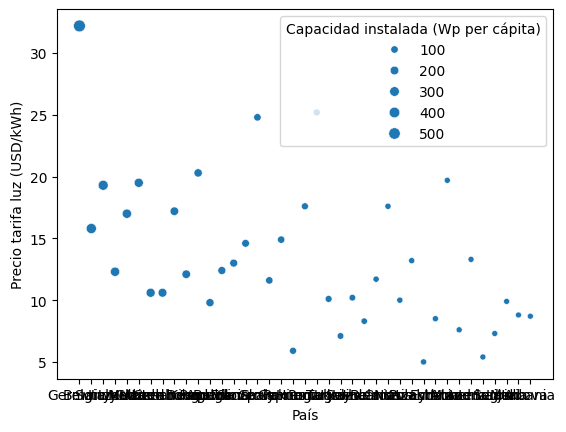

In [78]:
sns.scatterplot(x = "País",
                y = "Precio tarifa luz (USD/kWh)",
                size = df_eu_capacidad_upper["Capacidad instalada (Wp per cápita)"],
                data = df_eu_capacidad_upper)

In [79]:
def dispersion_3_var(df,x1, z1):
    num_graphs = len(df.columns)
    for y1 in df.columns:
        plt.figure()  # Crea una nueva figura
        sns.scatterplot(x=x1,
                        y=y1,
                        size=df[z1],
                        hue=df[z1],
                        palette= "Blues",
                        data=df,
                        edgecolor='grey',
                        legend=False)  # Esto quita la leyenda)
    # Mostrar todas las gráficas
    return plt.show()

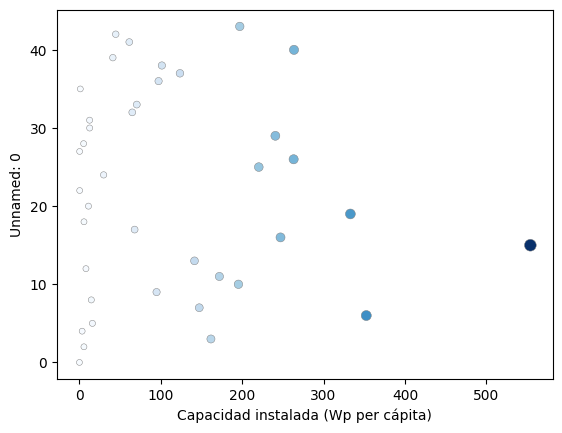

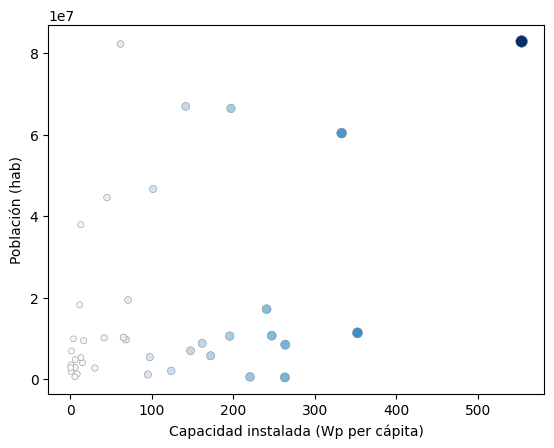

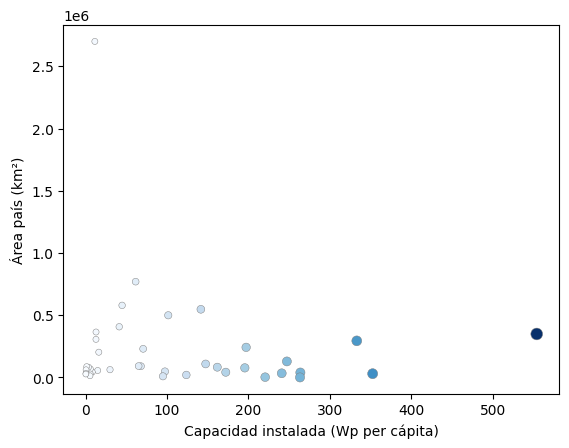

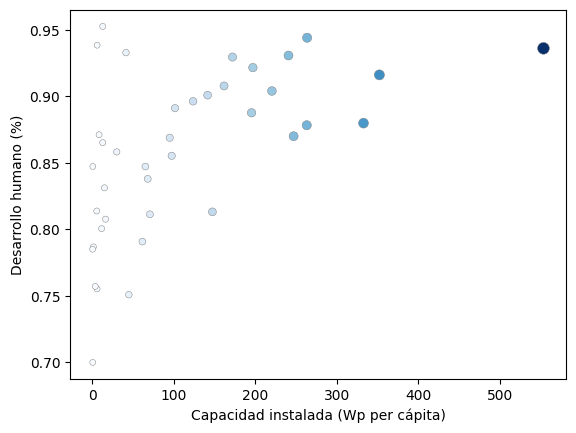

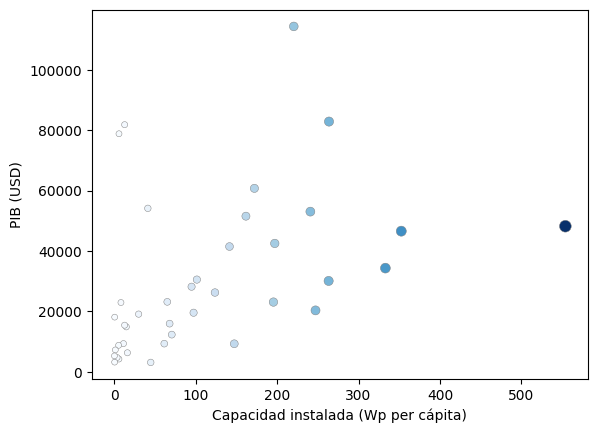

...

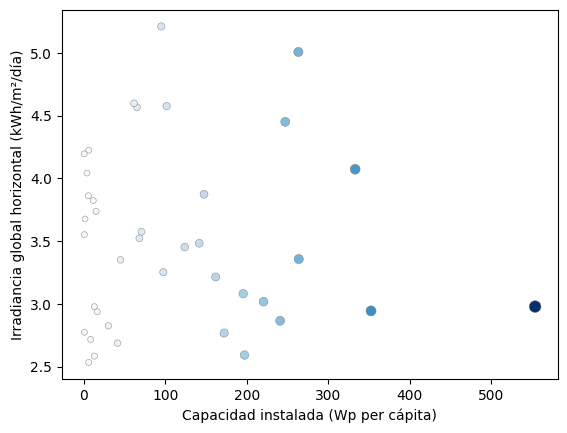

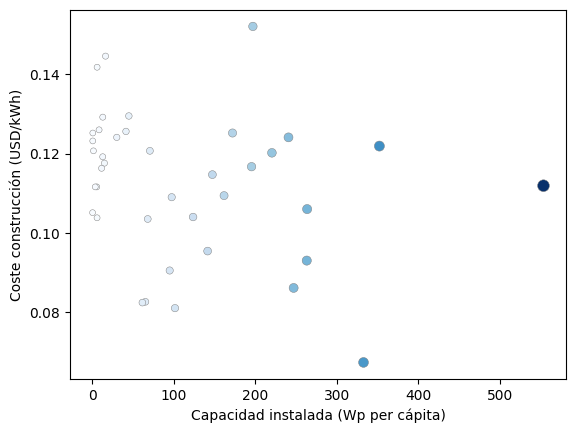

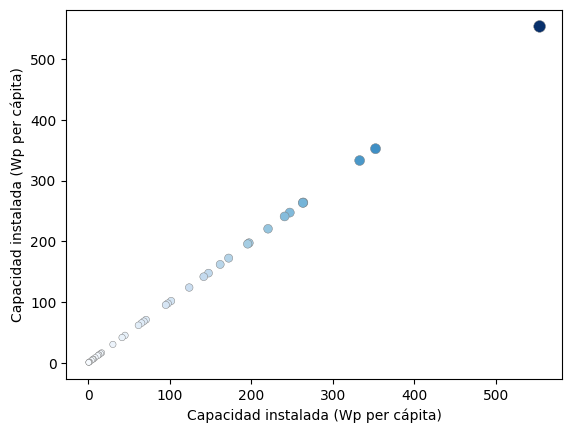

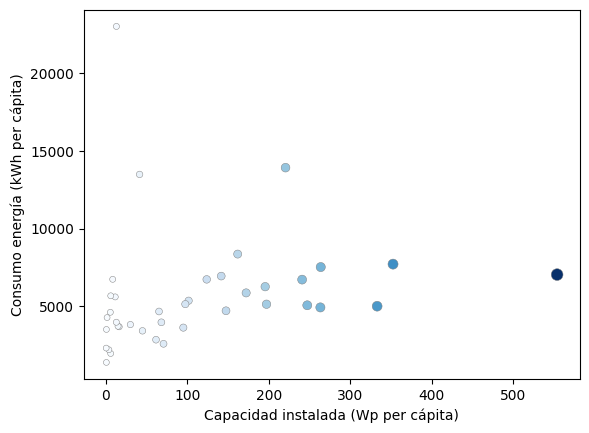

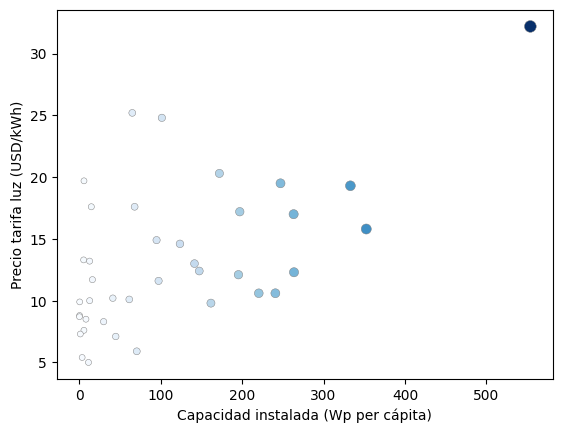

In [80]:
#VARIABLE CAPACIDAD INSTALADA COMO PRINCIPAL
dispersion_3_var(df_eu_capacidad_upper,"Capacidad instalada (Wp per cápita)","Capacidad instalada (Wp per cápita)")

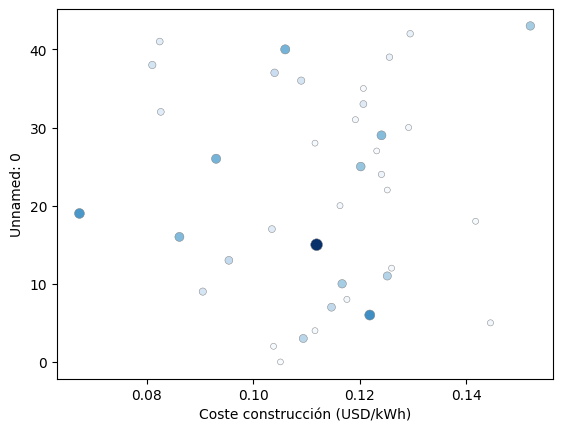

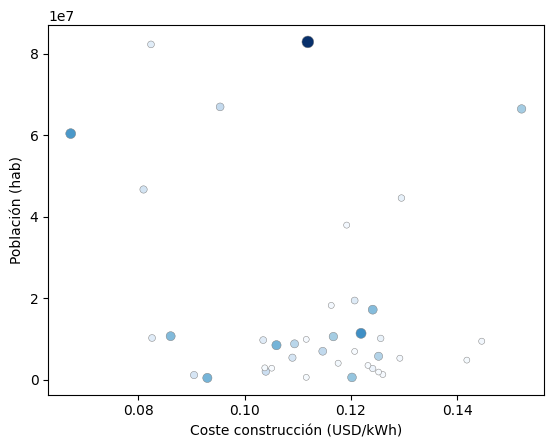

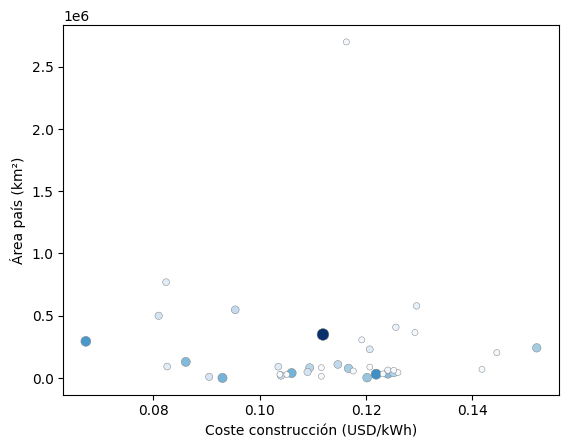

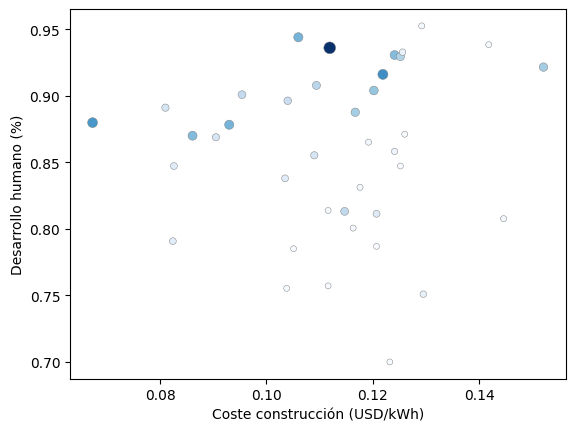

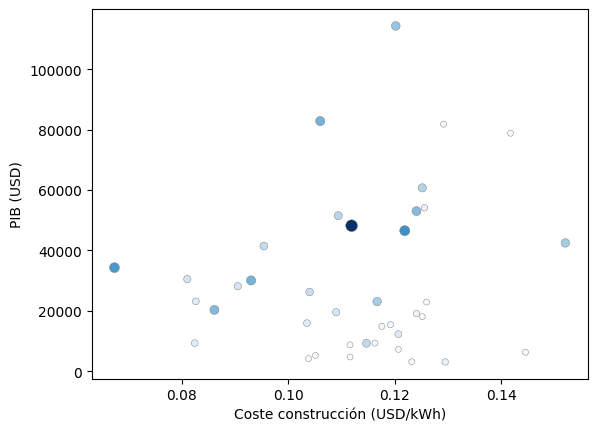

...

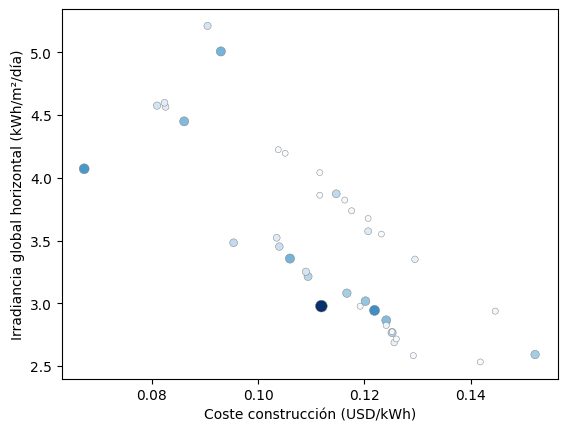

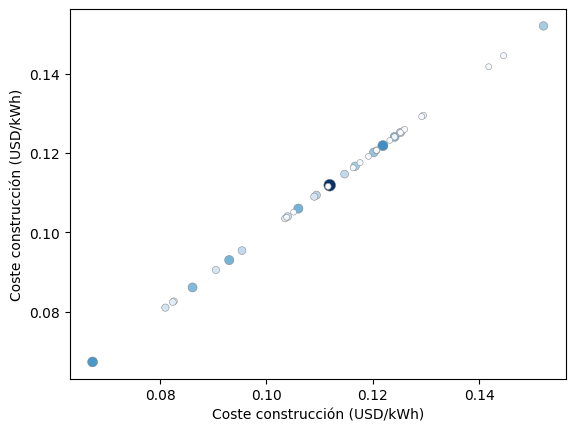

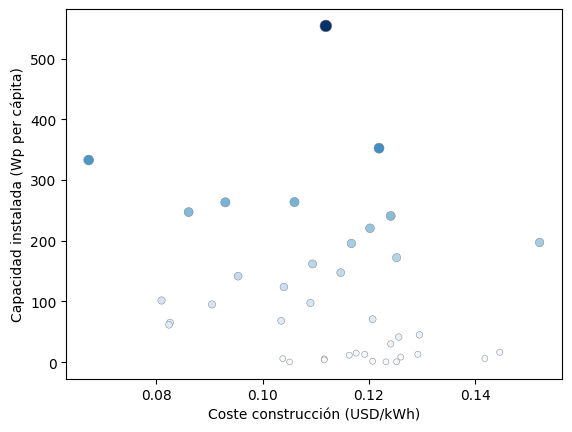

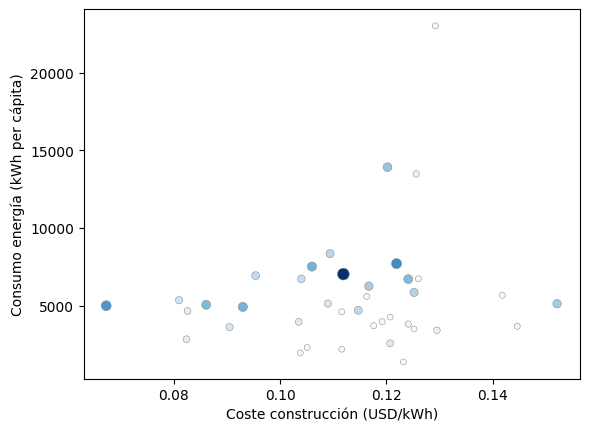

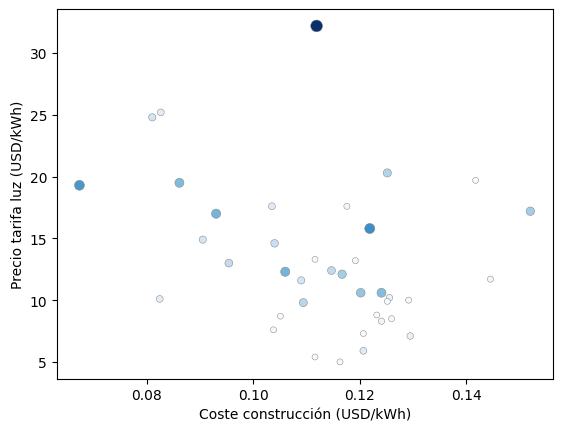

In [81]:
#VARIABLE PRINCIPAL COSTE
dispersion_3_var(df_eu_capacidad_upper, "Coste construcción (USD/kWh)","Capacidad instalada (Wp per cápita)")

In [82]:
df_eu_capacidad_upper_slicing.columns

Index(['Unnamed: 0', 'Población (hab)', 'Área país (km²)',
       'Desarrollo humano (%)', 'PIB (USD)', 'Precipitación media (mm)',
       'Irradiancia global horizontal (kWh/m²/día)',
       'Coste construcción (USD/kWh)', 'Capacidad instalada (Wp per cápita)',
       'Consumo energía (kWh per cápita)', 'Precio tarifa luz (USD/kWh)'],
      dtype='object')

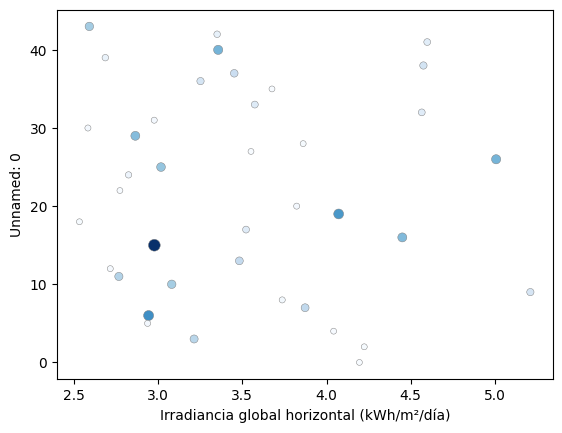

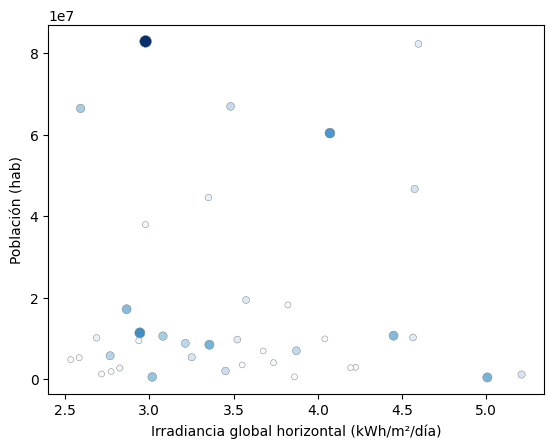

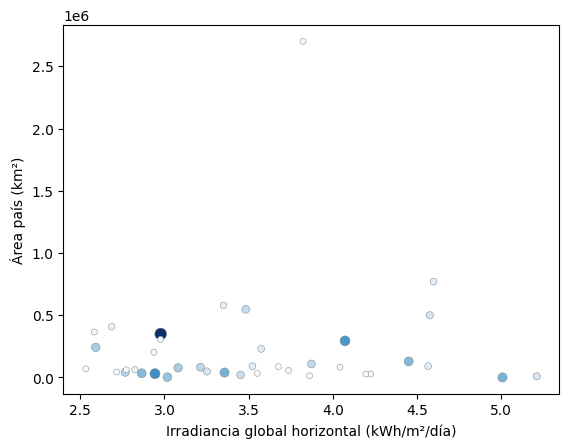

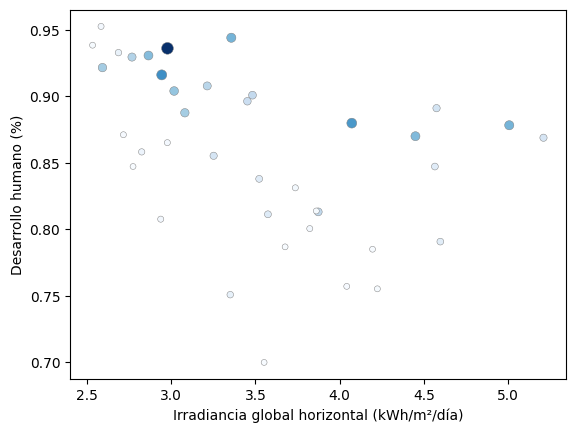

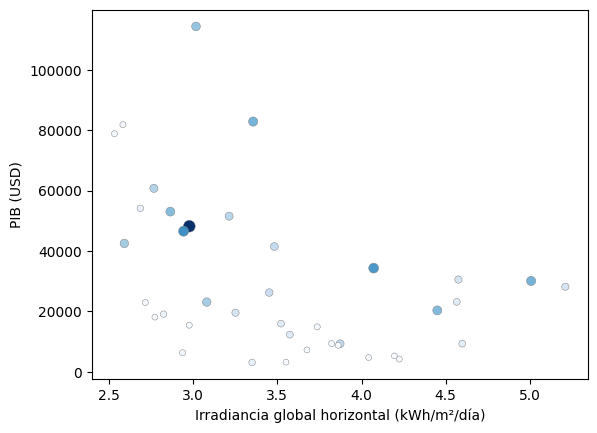

...

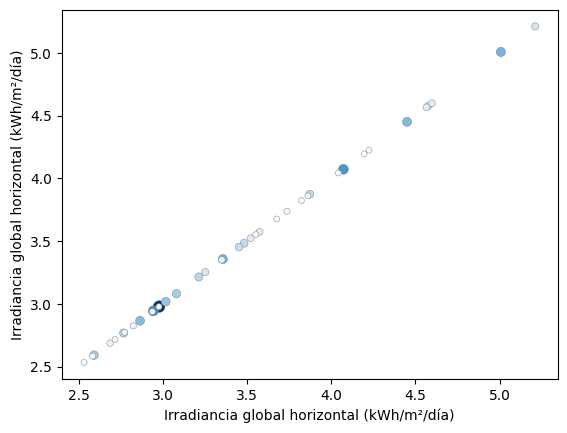

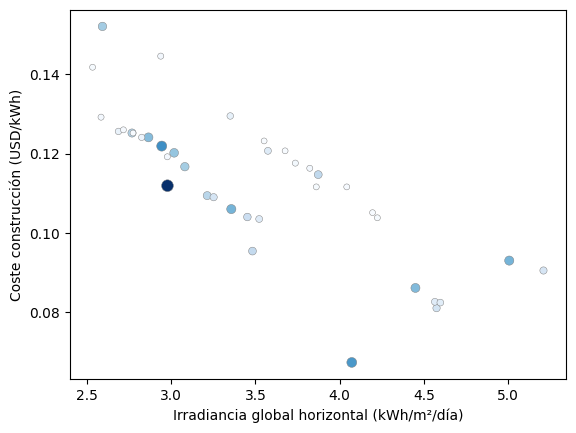

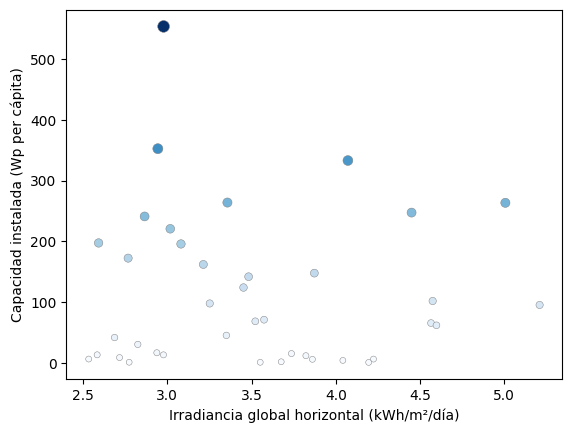

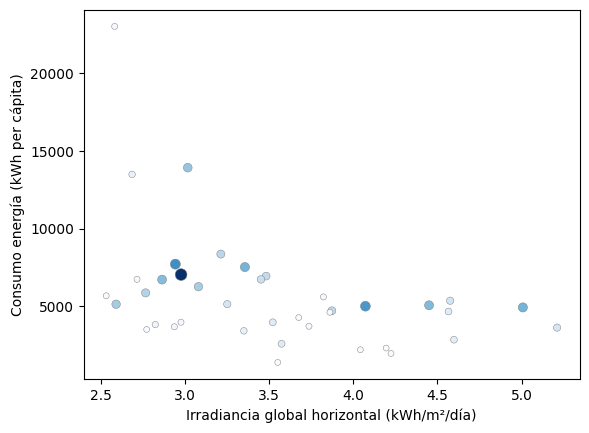

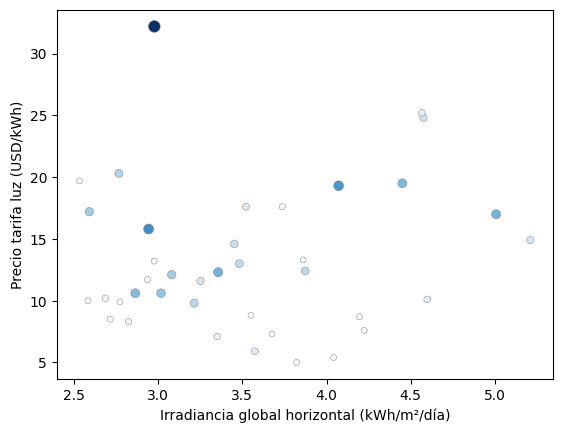

In [83]:
#VARIABLE PRINCIPAL IRRADIANCIA
dispersion_3_var(df_eu_capacidad_upper, "Irradiancia global horizontal (kWh/m²/día)","Capacidad instalada (Wp per cápita)" )

In [84]:
df_eu_capacidad_upper.columns

Index(['Unnamed: 0', 'Población (hab)', 'Área país (km²)',
       'Desarrollo humano (%)', 'PIB (USD)', 'Precipitación media (mm)',
       'Irradiancia global horizontal (kWh/m²/día)',
       'Coste construcción (USD/kWh)', 'Capacidad instalada (Wp per cápita)',
       'Consumo energía (kWh per cápita)', 'Precio tarifa luz (USD/kWh)'],
      dtype='object')

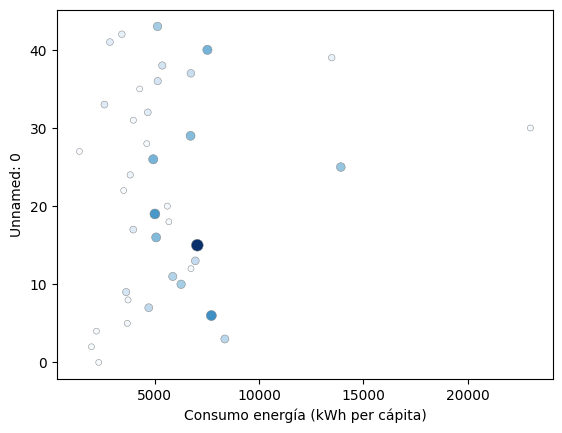

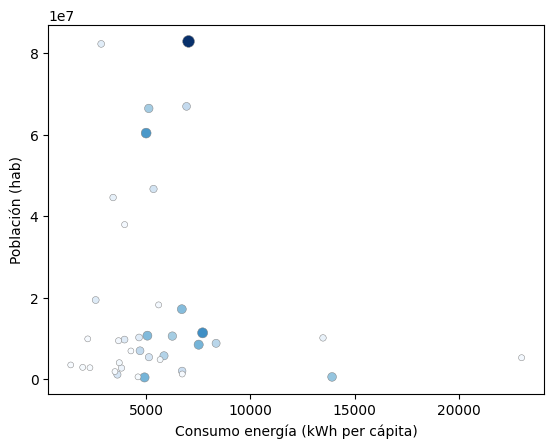

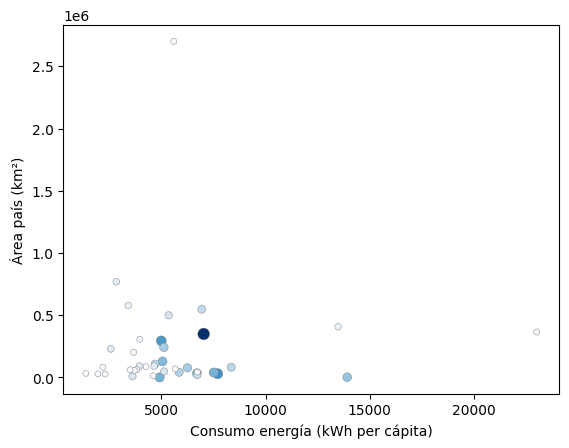

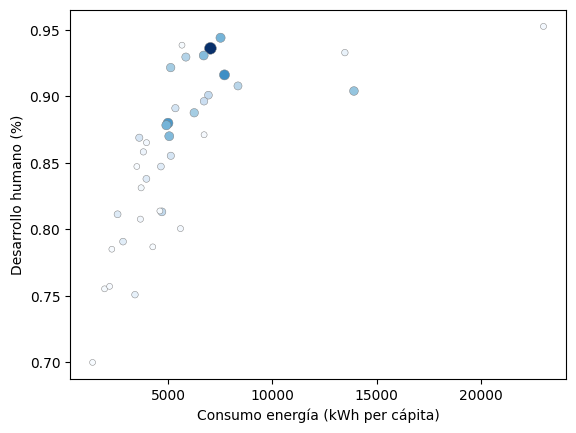

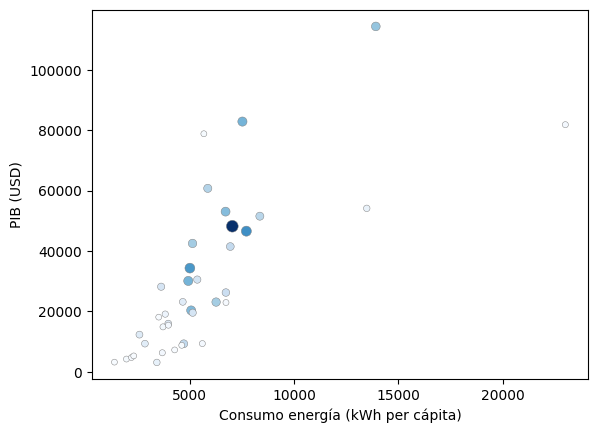

...

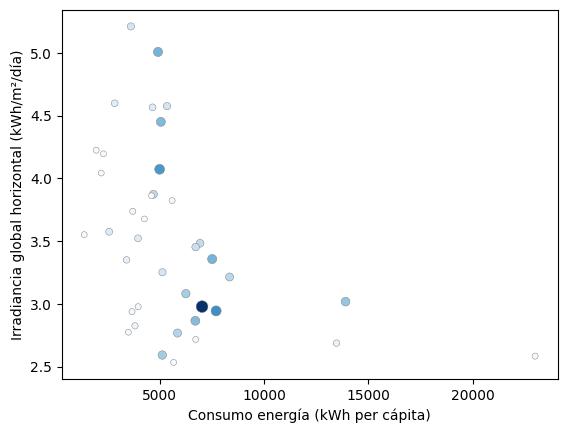

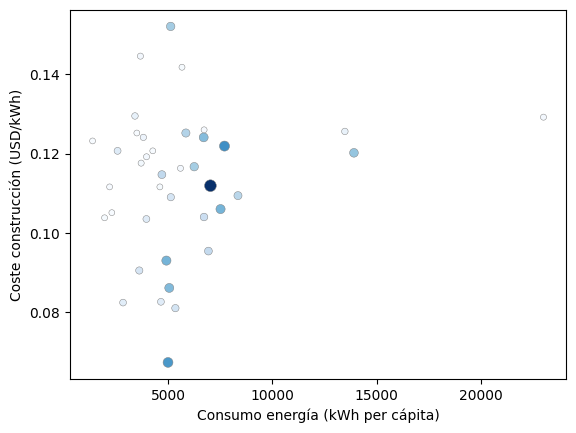

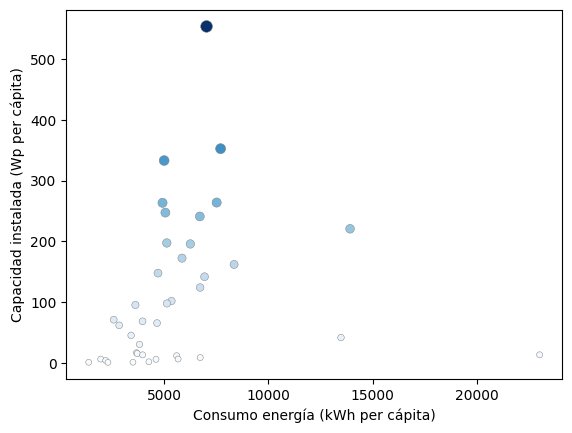

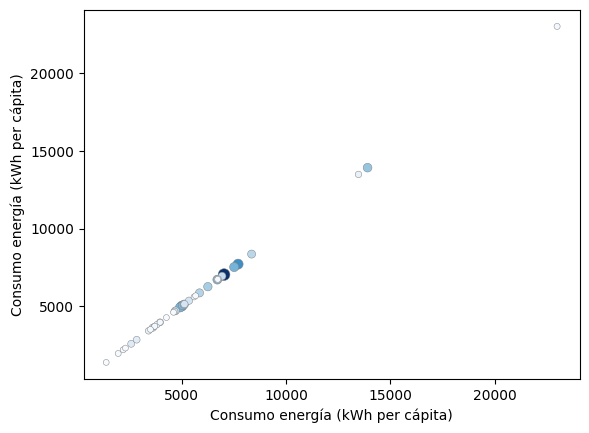

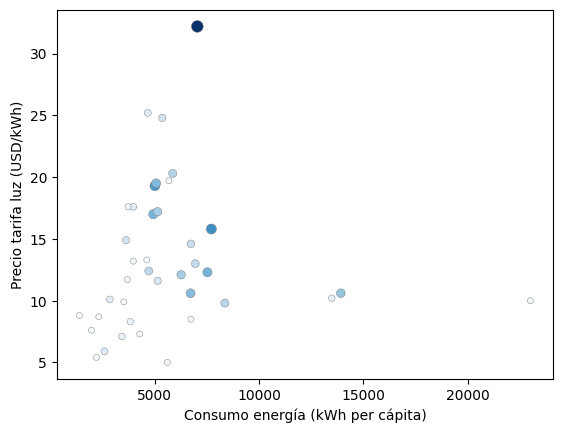

In [85]:
#VARIABLE PRINCIPAL CONSUMO PER CAPITA
dispersion_3_var(df_eu_capacidad_upper,"Consumo energía (kWh per cápita)","Capacidad instalada (Wp per cápita)")

In [86]:
df_eu_capacidad_upper.columns

Index(['Unnamed: 0', 'Población (hab)', 'Área país (km²)',
       'Desarrollo humano (%)', 'PIB (USD)', 'Precipitación media (mm)',
       'Irradiancia global horizontal (kWh/m²/día)',
       'Coste construcción (USD/kWh)', 'Capacidad instalada (Wp per cápita)',
       'Consumo energía (kWh per cápita)', 'Precio tarifa luz (USD/kWh)'],
      dtype='object')

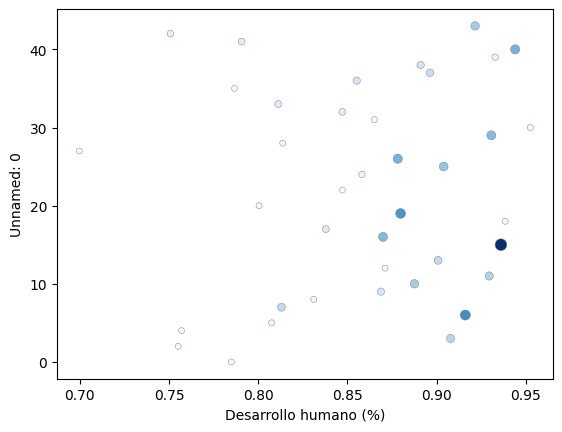

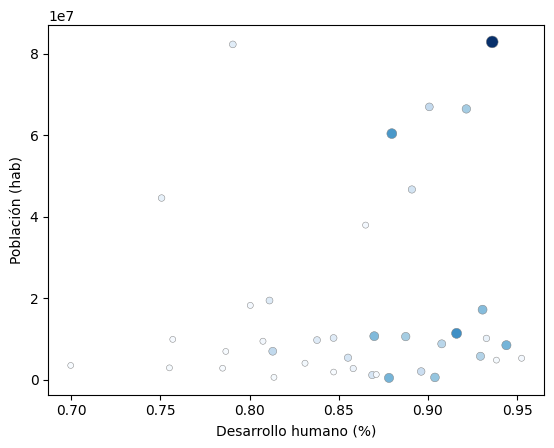

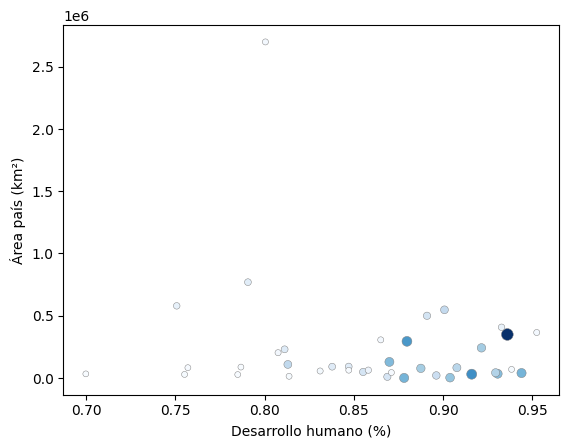

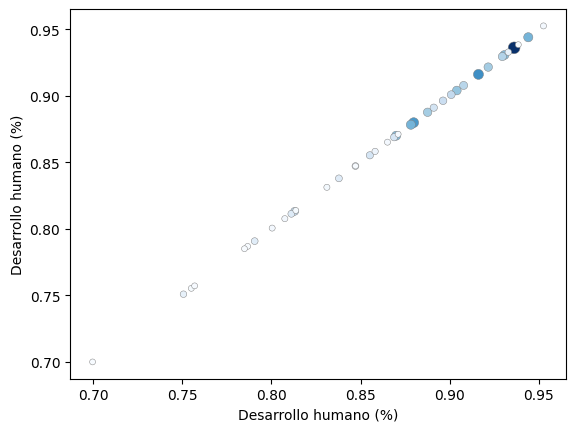

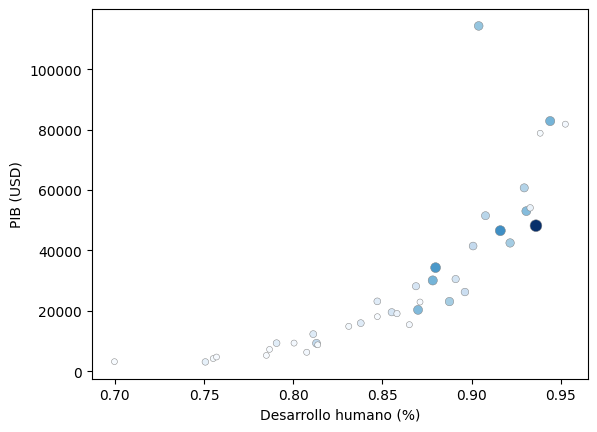

...

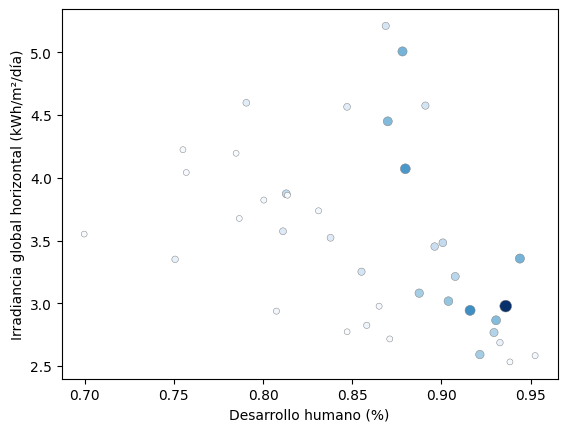

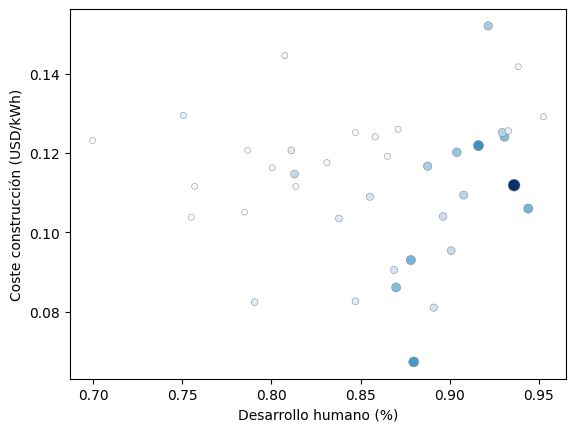

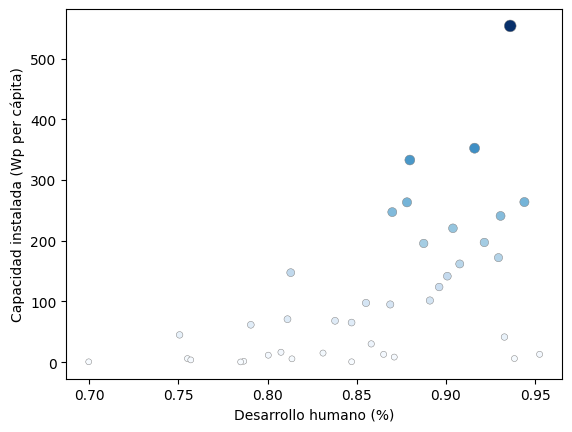

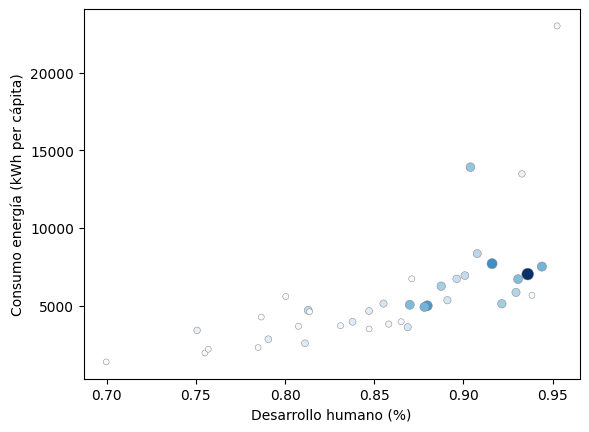

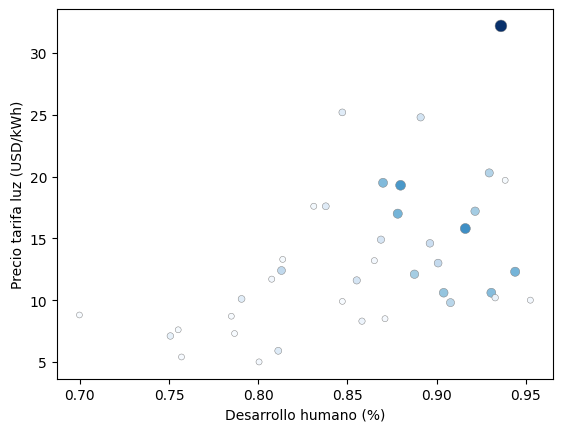

In [87]:
#VARIABLE PRINCIPAL DESARROLLO HUMANO
dispersion_3_var(df_eu_capacidad_upper, "Desarrollo humano (%)","Capacidad instalada (Wp per cápita)")

In [88]:
df_eu_capacidad_upper.columns

Index(['Unnamed: 0', 'Población (hab)', 'Área país (km²)',
       'Desarrollo humano (%)', 'PIB (USD)', 'Precipitación media (mm)',
       'Irradiancia global horizontal (kWh/m²/día)',
       'Coste construcción (USD/kWh)', 'Capacidad instalada (Wp per cápita)',
       'Consumo energía (kWh per cápita)', 'Precio tarifa luz (USD/kWh)'],
      dtype='object')

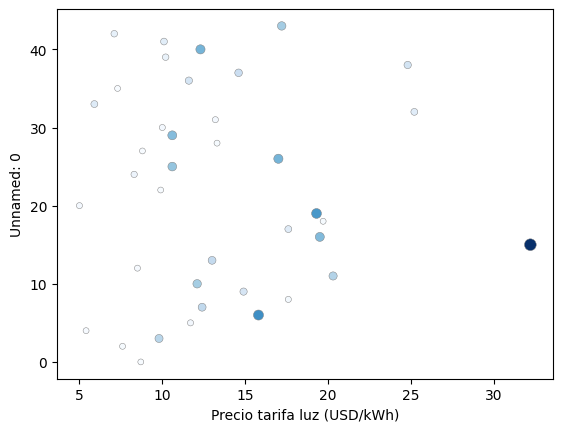

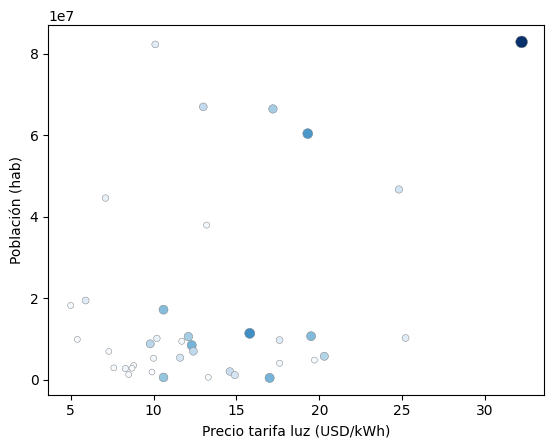

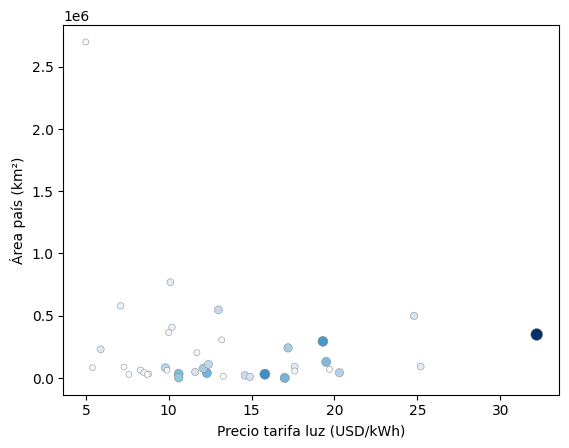

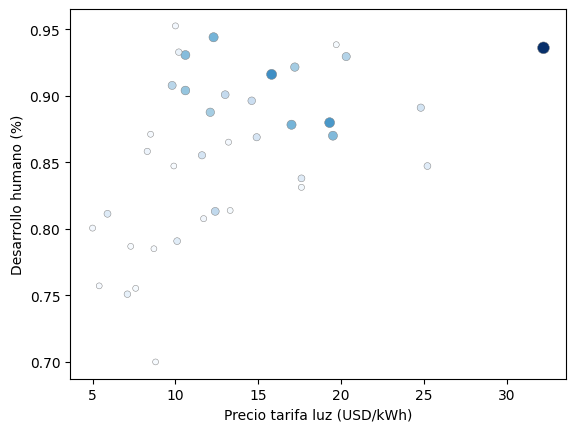

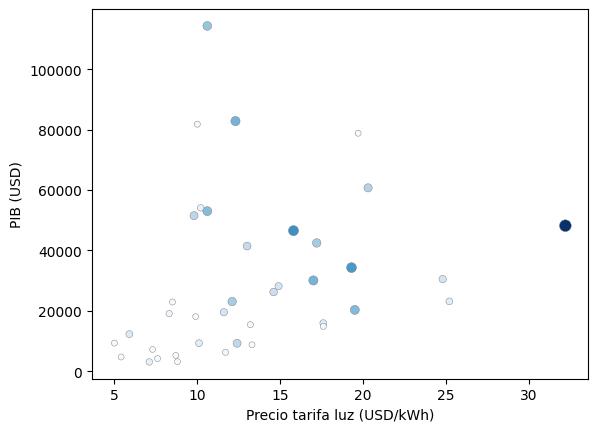

...

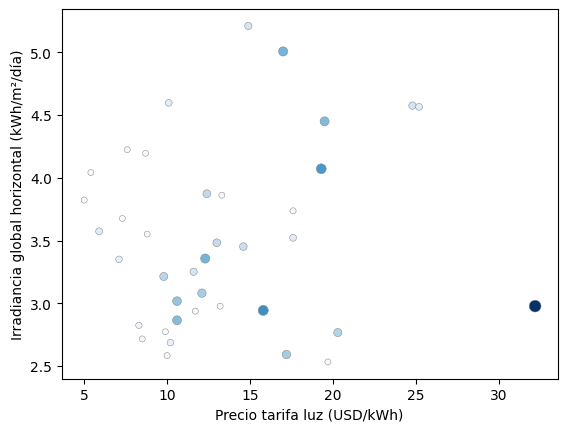

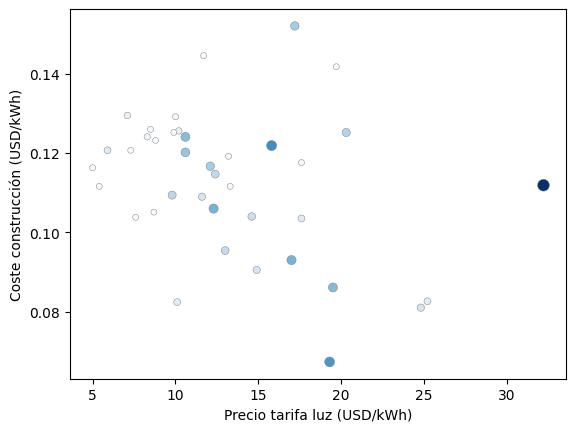

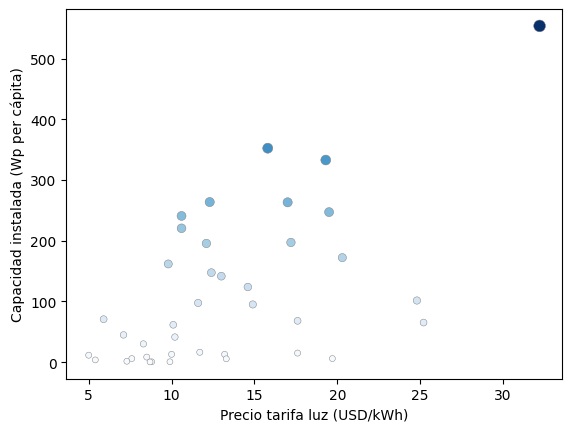

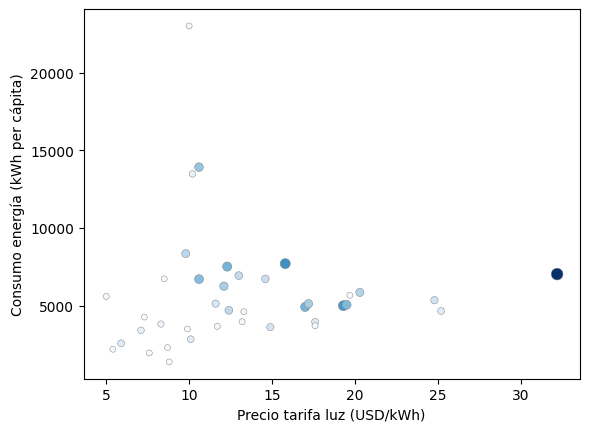

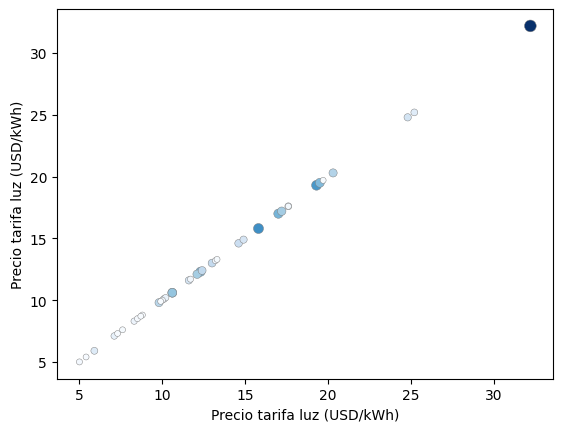

In [89]:
dispersion_3_var(df_eu_capacidad_upper,"Precio tarifa luz (USD/kWh)","Capacidad instalada (Wp per cápita)")

In [90]:
df_eu_final.columns

Index(['Unnamed: 0', 'Población (hab)', 'Área país (km²)',
       'Desarrollo humano (%)', 'PIB (USD)', 'Precipitación media (mm)',
       'Irradiancia global horizontal (kWh/m²/día)',
       'Coste construcción (USD/kWh)', 'Capacidad instalada (Wp per cápita)',
       'Consumo energía (kWh per cápita)', 'Precio tarifa luz (USD/kWh)'],
      dtype='object')

<Axes: xlabel='País', ylabel='Capacidad instalada (Wp per cápita)'>

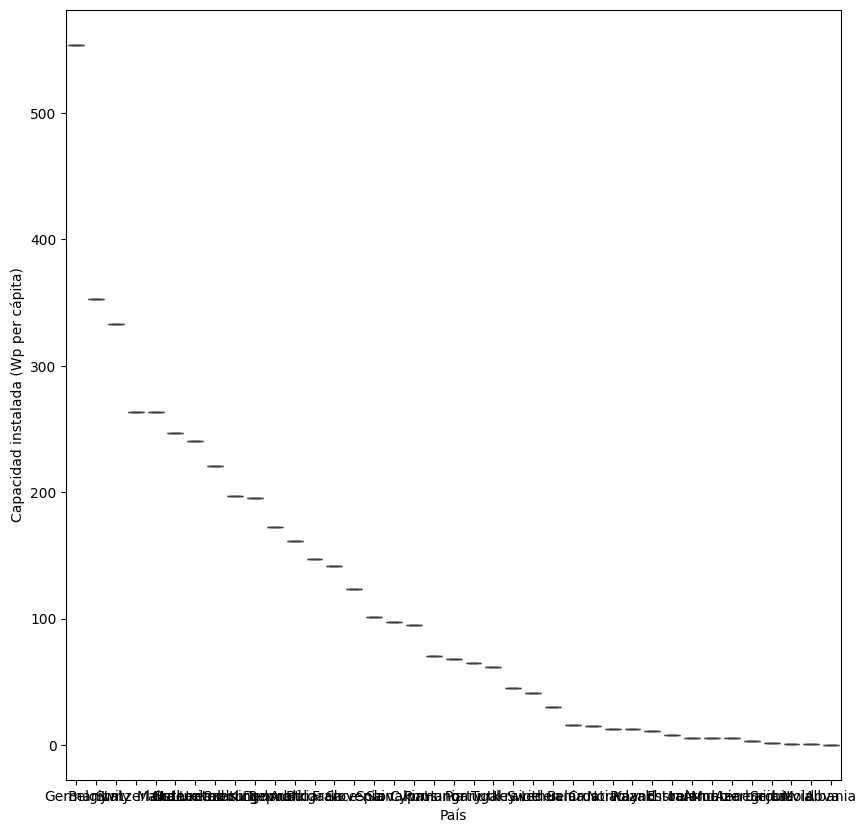

In [91]:

plt.figure(figsize = (10,10))
sns.boxplot(x = "País",
            y = "Capacidad instalada (Wp per cápita)",
            hue = "País",
            data = df_eu_capacidad_upper)

<Axes: xlabel='Capacidad instalada (Wp per cápita)', ylabel='Count'>

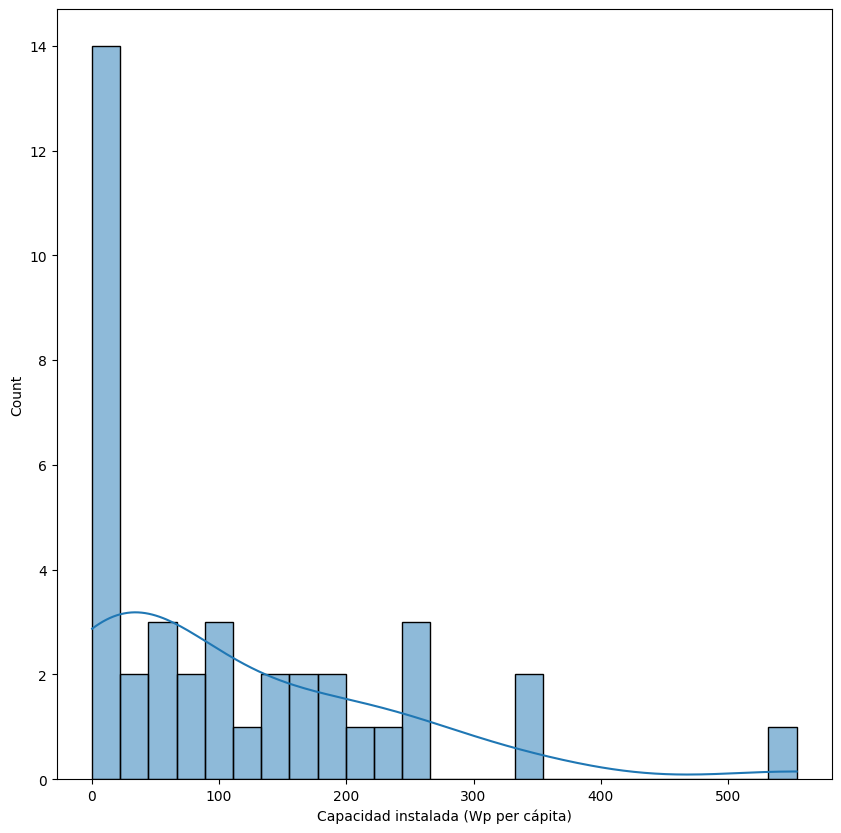

In [92]:
plt.figure(figsize = (10,10))
sns.histplot(kde = True,
            bins= 25,
            data = df_eu_capacidad_upper["Capacidad instalada (Wp per cápita)"])

In [93]:
def dispersion_4_var(df,x1,z1,w1):
    num_graphs = len(df.columns)
    for y1 in df.columns:
        plt.figure()  # Crea una nueva figura
        sns.scatterplot(x=x1,
                        y=y1,
                        size=df[z1],
                        hue=df[w1],
                        palette= "Blues",
                        data=df,
                        edgecolor='grey',
                        legend=False)  # Esto quita la leyenda)
    # Mostrar todas las gráficas
    return plt.show()

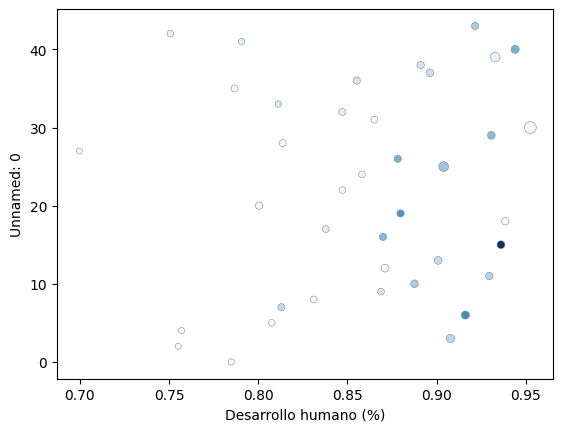

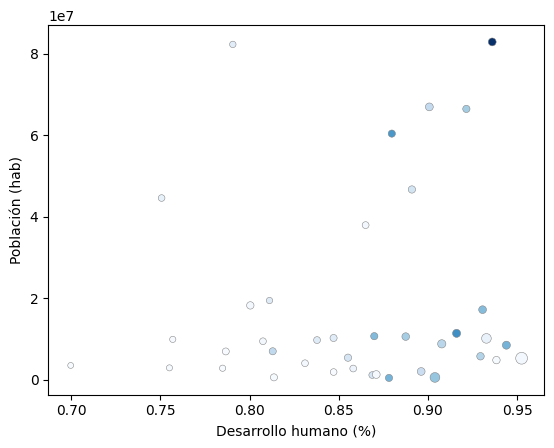

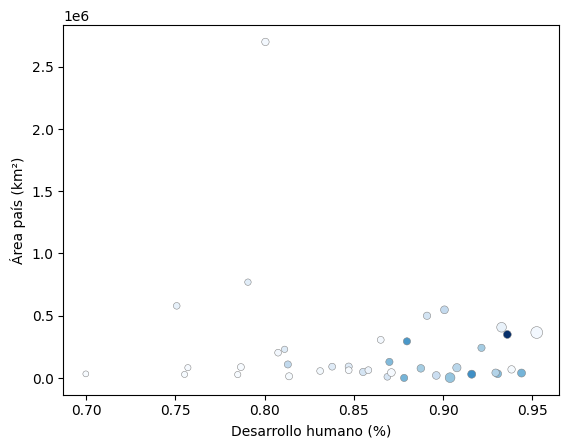

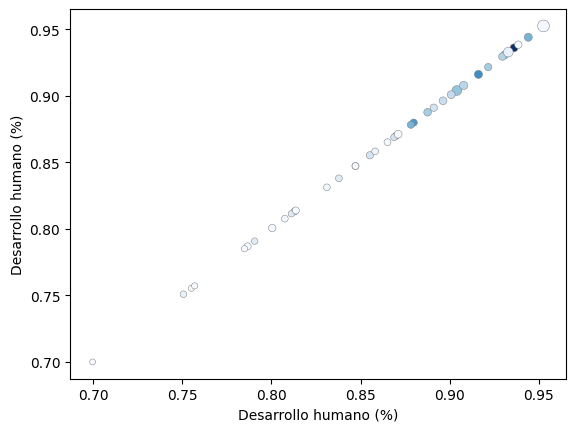

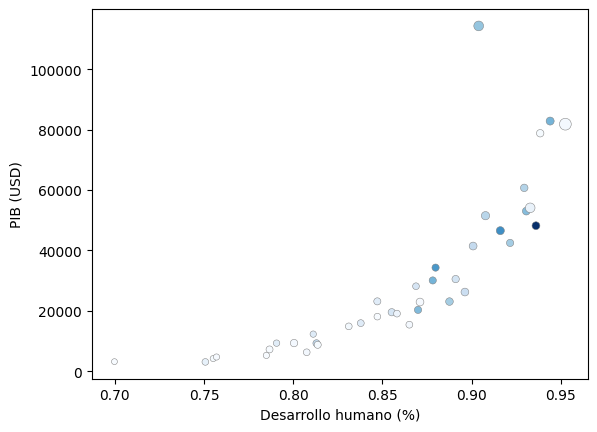

...

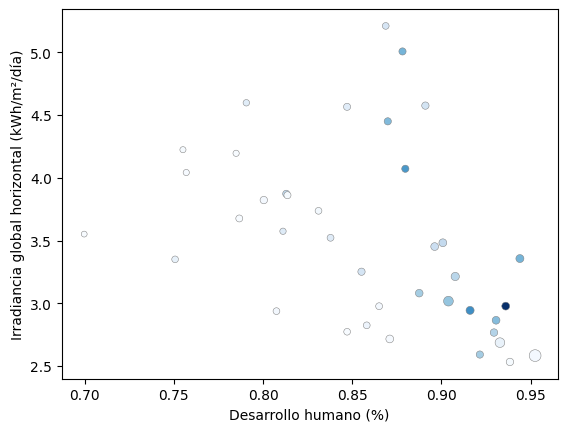

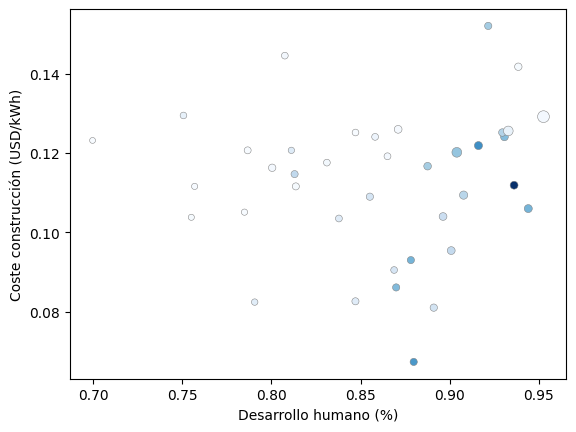

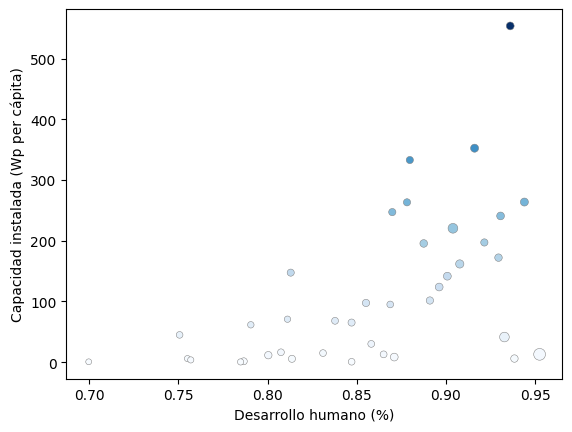

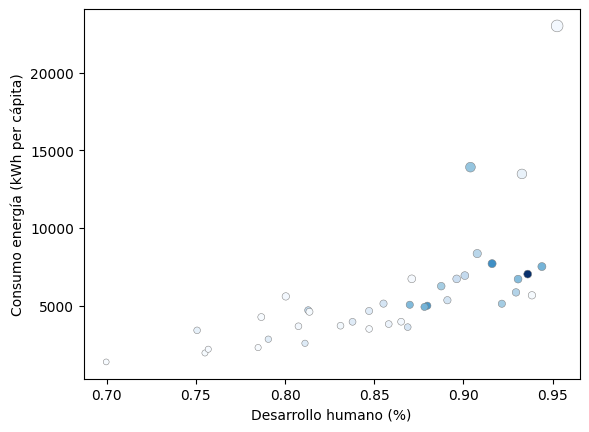

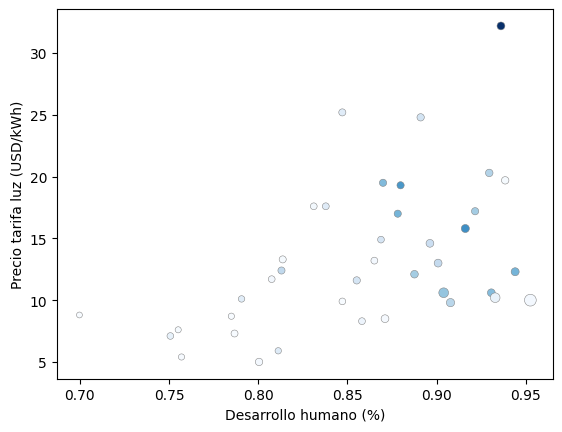

In [94]:
dispersion_4_var(df_eu_capacidad_upper,"Desarrollo humano (%)","Consumo energía (kWh per cápita)", "Capacidad instalada (Wp per cápita)" )

In [95]:
df_eu_capacidad_upper.columns

Index(['Unnamed: 0', 'Población (hab)', 'Área país (km²)',
       'Desarrollo humano (%)', 'PIB (USD)', 'Precipitación media (mm)',
       'Irradiancia global horizontal (kWh/m²/día)',
       'Coste construcción (USD/kWh)', 'Capacidad instalada (Wp per cápita)',
       'Consumo energía (kWh per cápita)', 'Precio tarifa luz (USD/kWh)'],
      dtype='object')

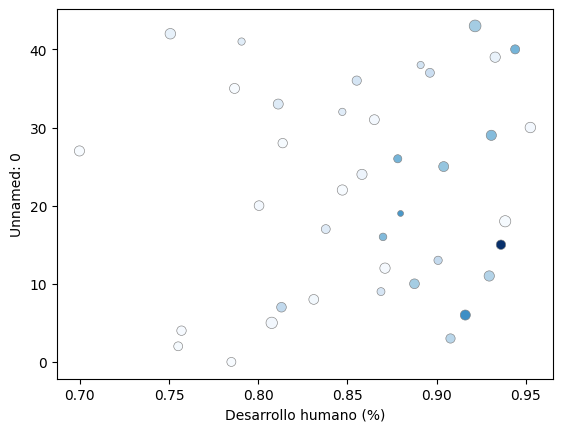

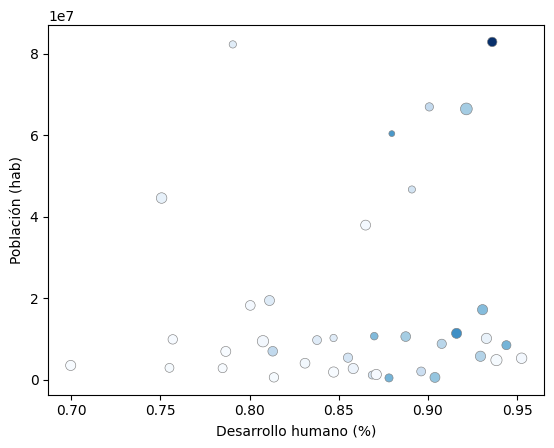

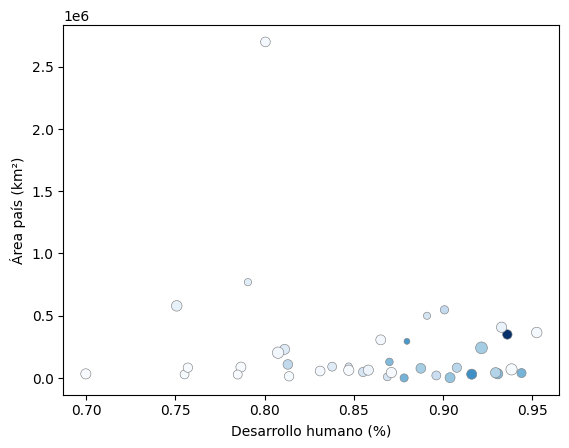

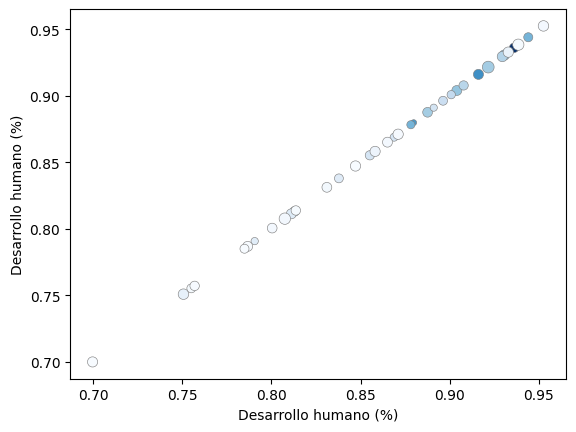

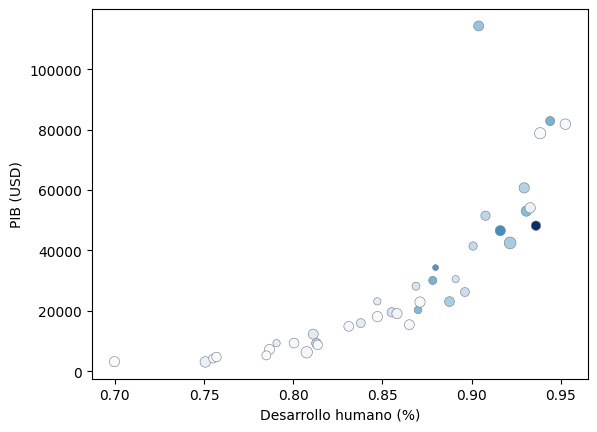

...

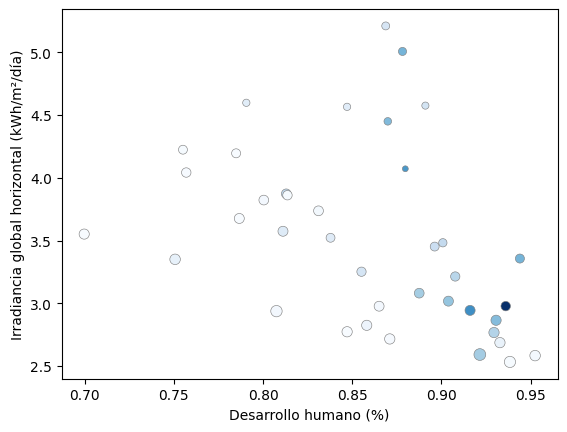

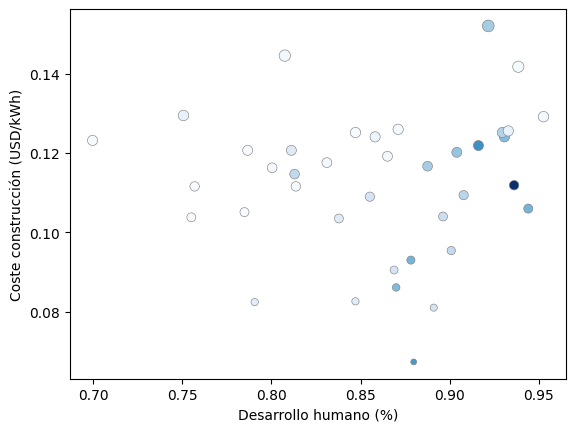

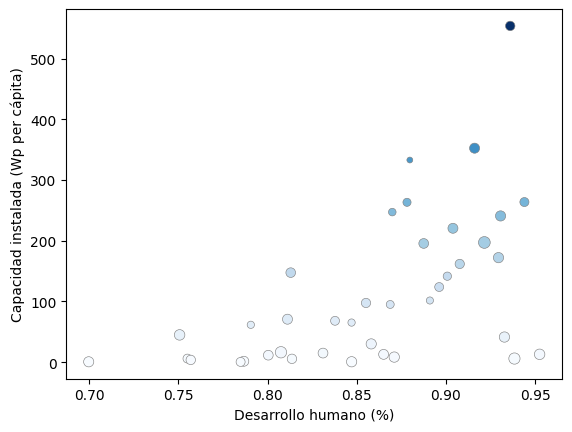

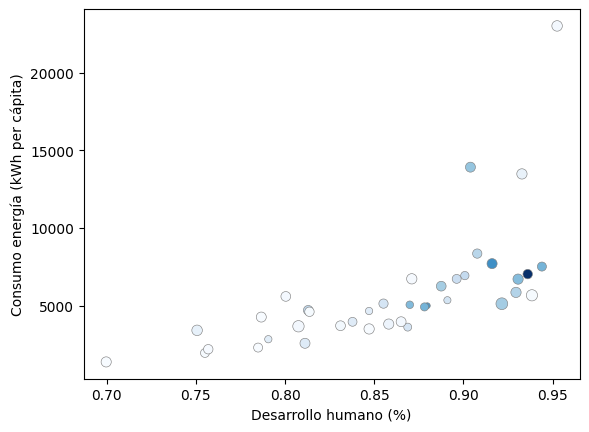

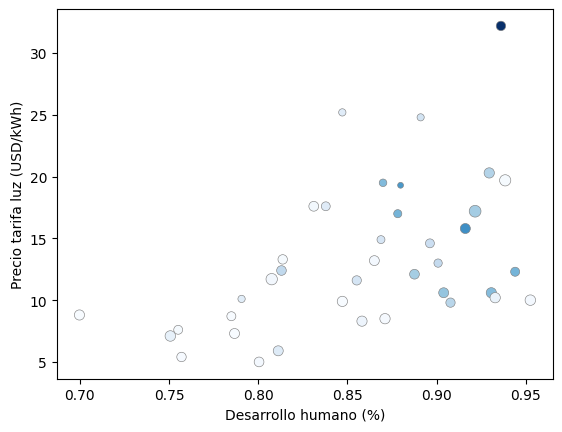

In [96]:
dispersion_4_var(df_eu_capacidad_upper,"Desarrollo humano (%)","Coste construcción (USD/kWh)", "Capacidad instalada (Wp per cápita)" )

In [97]:
df_eu_capacidad_upper_slicing

,Unnamed: 0,Población (hab),Área país (km²),Desarrollo humano (%),PIB (USD),Precipitación media (mm),Irradiancia global horizontal (kWh/m²/día),Coste construcción (USD/kWh),Capacidad instalada (Wp per cápita),Consumo energía (kWh per cápita),Precio tarifa luz (USD/kWh)
País,,,,,,,,,,,
Germany,15,82927922,349360.0,0.936043,48195.579904,700.0,2.9777,0.1119,553.854467,7035.482975,32.2
Belgium,6,11422068,30280.0,0.916066,46556.099567,847.0,2.9436,0.1219,352.440556,7709.123078,15.8
Italy,19,60431283,294140.0,0.879769,34318.351124,832.0,4.0721,0.0673,332.940143,5002.406680,19.3
Switzerland,40,8516543,39516.0,0.943998,82838.929445,1537.0,3.3567,0.1060,263.722029,7520.166025,12.3
Malta,26,483530,320.0,0.878187,30074.741185,560.0,5.0071,0.0930,263.272186,4924.544019,17.0
Greece,16,10727668,128900.0,0.869934,20324.253564,652.0,4.4501,0.0861,247.164621,5062.606422,19.5
Netherlands,29,17231017,33690.0,0.930639,53024.059213,778.0,2.8649,0.1241,240.844751,6712.774758,10.6
Luxembourg,25,607728,2430.0,0.903939,114340.498742,934.0,3.0173,0.1202,220.493379,13914.678449,10.6
United Kingdom,43,66488991,241930.0,0.921549,42491.364435,1220.0,2.5918,0.1521,197.145419,5129.527793,17.2


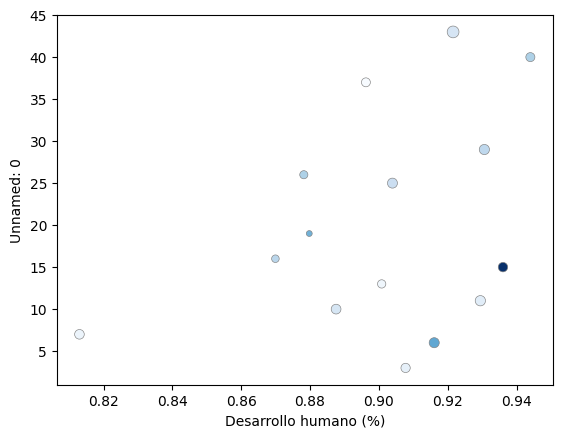

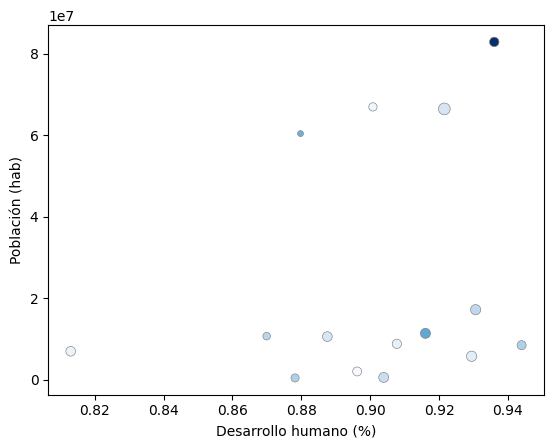

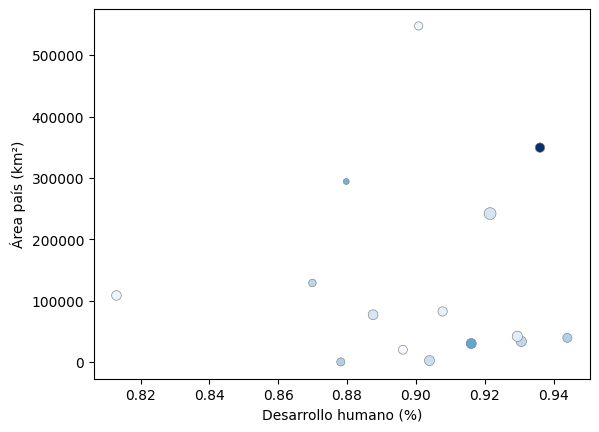

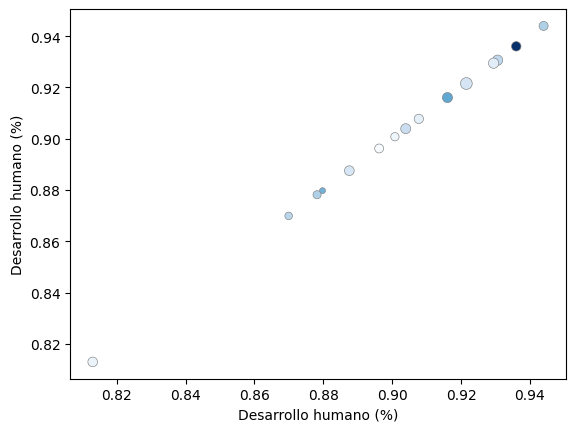

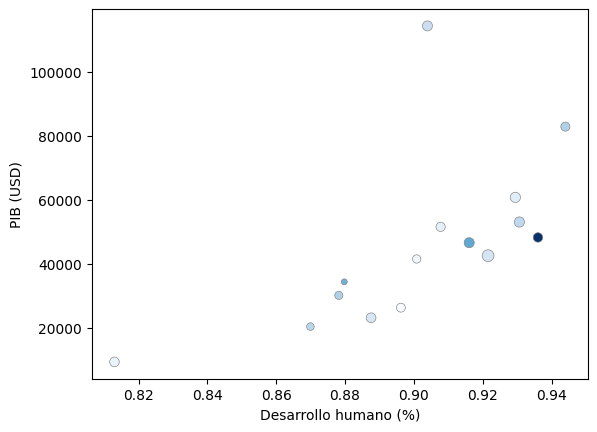

...

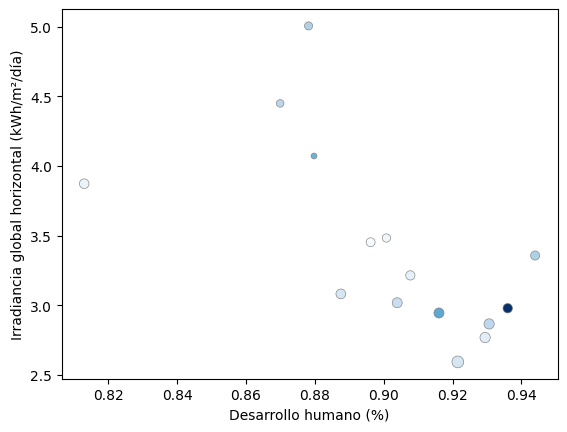

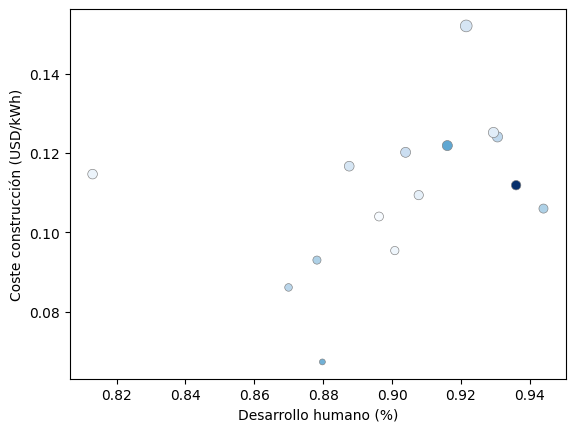

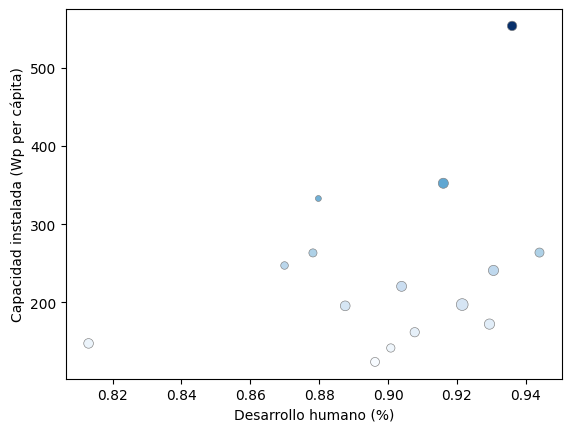

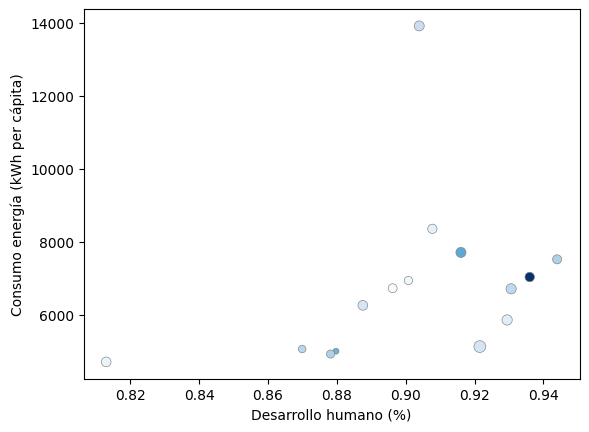

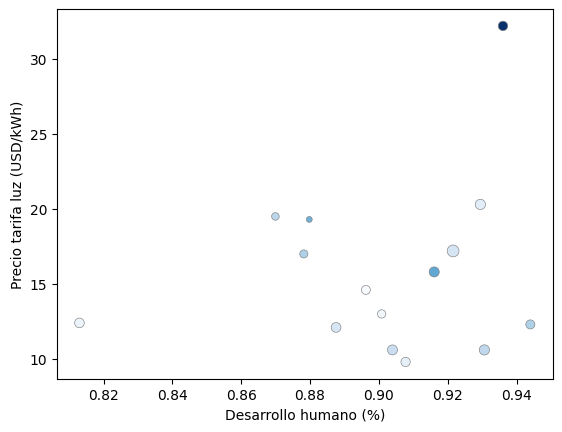

In [98]:
dispersion_4_var(df_eu_capacidad_upper_slicing,"Desarrollo humano (%)","Coste construcción (USD/kWh)", "Capacidad instalada (Wp per cápita)" )

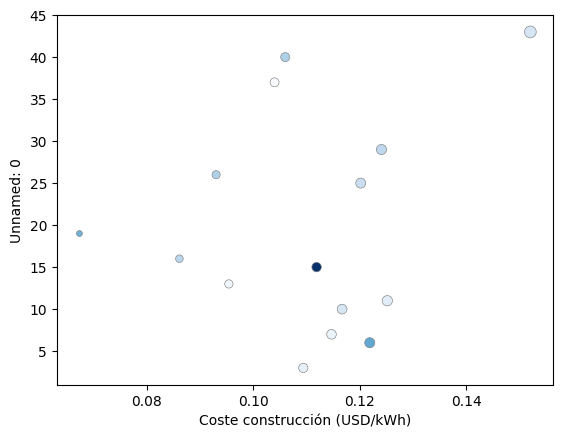

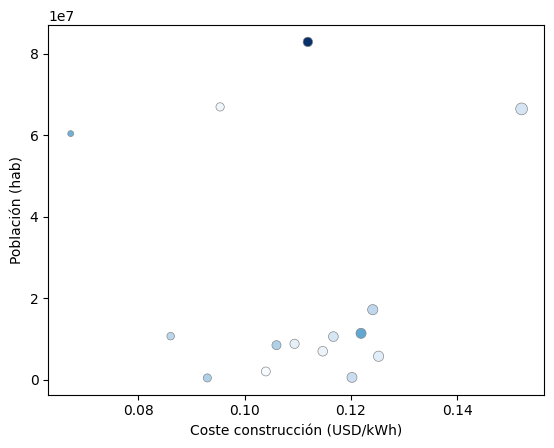

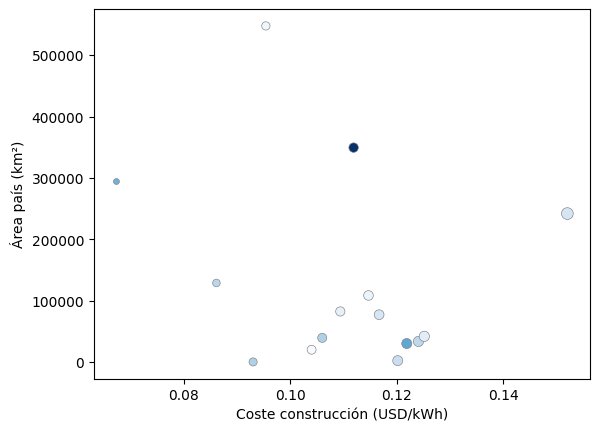

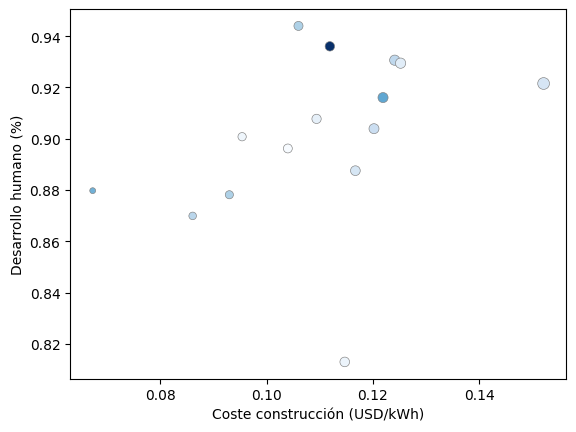

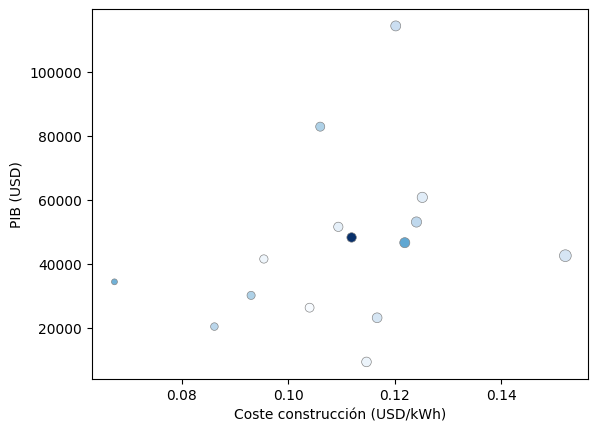

...

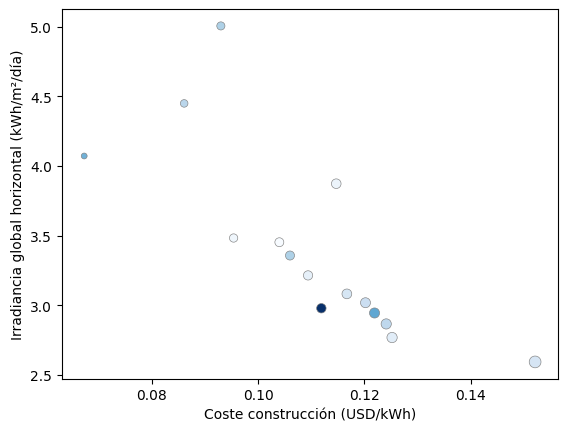

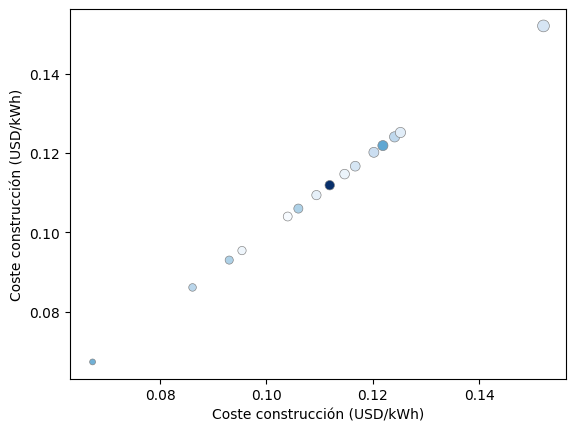

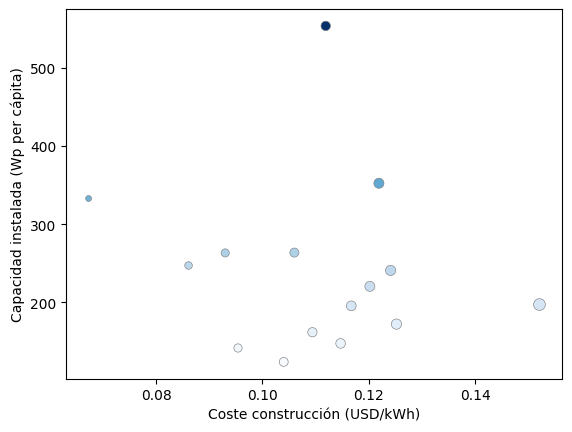

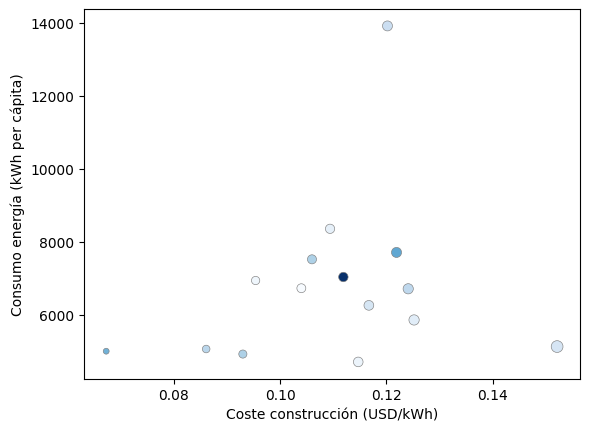

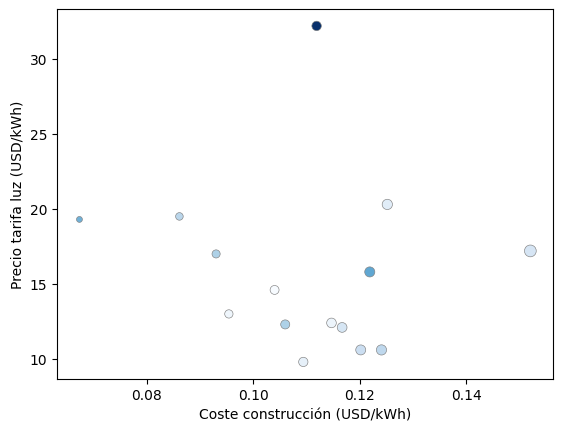

In [99]:
dispersion_4_var(df_eu_capacidad_upper_slicing,"Coste construcción (USD/kWh)","Coste construcción (USD/kWh)", "Capacidad instalada (Wp per cápita)" )

In [100]:

#Si no encontramos porque se invierte, quiza interesa saber porque NO se invierte,
# slicing de coste  de 0.10 a 0.13 y capacidad instalada menor

df_eu_coste = df_eu_final.loc[(df_eu_final["Coste construcción (USD/kWh)"]<0.13) & (df_eu_final["Coste construcción (USD/kWh)"]>0.10) ]
df_eu_coste

,Unnamed: 0,Población (hab),Área país (km²),Desarrollo humano (%),PIB (USD),Precipitación media (mm),Irradiancia global horizontal (kWh/m²/día),Coste construcción (USD/kWh),Capacidad instalada (Wp per cápita),Consumo energía (kWh per cápita),Precio tarifa luz (USD/kWh)
País,,,,,,,,,,,
Albania,0,2866376,27400.0,0.784911,5253.630064,1485.0,4.1954,0.1051,0.348873,2309.366503,8.7
Armenia,2,2951776,28470.0,0.755113,4212.070943,562.0,4.2241,0.1038,5.860878,1961.610395,7.6
Austria,3,8847037,82523.0,0.907755,51512.905475,1110.0,3.2138,0.1094,161.749069,8355.841952,9.8
Azerbaijan,4,9942334,82670.0,0.756965,4721.178087,447.0,4.0422,0.1116,3.661112,2202.393918,5.4
Belgium,6,11422068,30280.0,0.916066,46556.099567,847.0,2.9436,0.1219,352.440556,7709.123078,15.8
Bulgaria,7,7024216,108560.0,0.813006,9272.629304,608.0,3.8729,0.1147,147.432824,4708.927458,12.4
Croatia,8,4089400,55960.0,0.831102,14869.090682,1113.0,3.7370,0.1176,14.916614,3714.382988,17.6
Czech Republic,10,10625695,77220.0,0.887561,23078.573487,0.0,3.0809,0.1167,195.516623,6258.891037,12.1
Denmark,11,5797446,41990.0,0.929474,60726.466535,703.0,2.7671,0.1252,172.144769,5858.801536,20.3


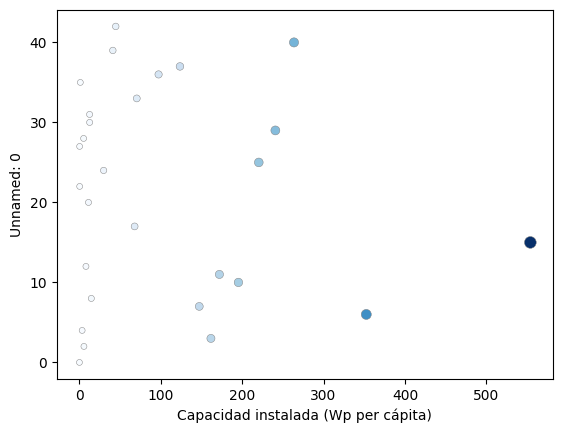

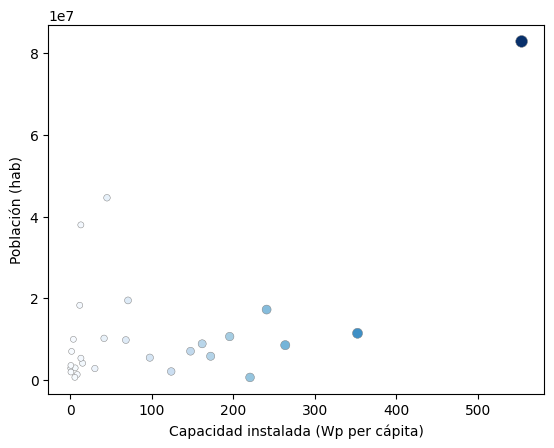

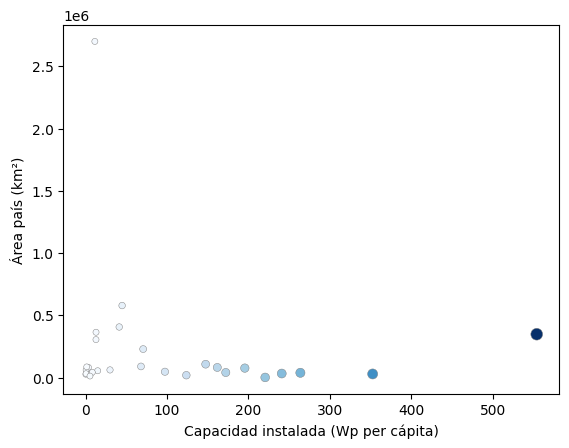

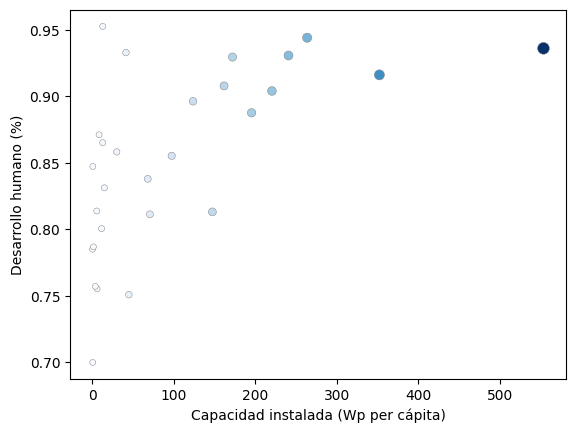

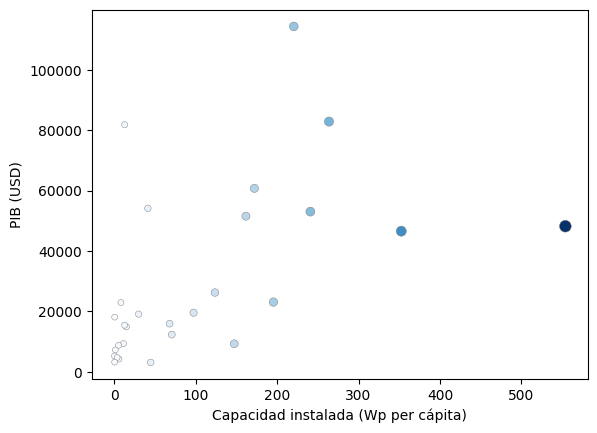

...

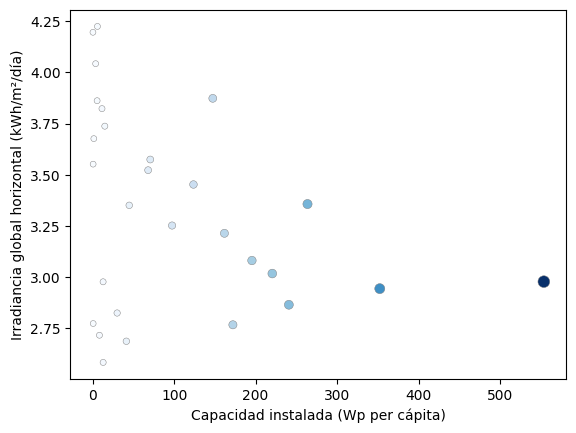

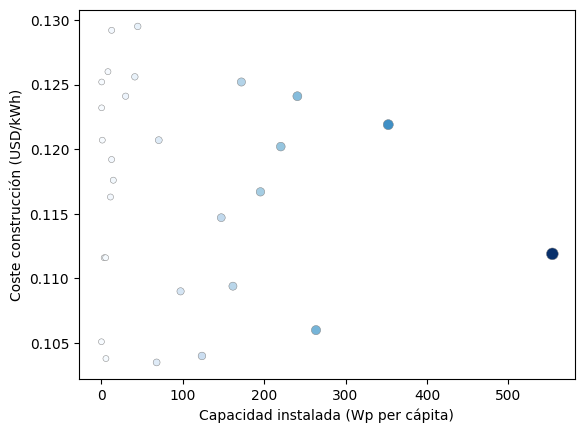

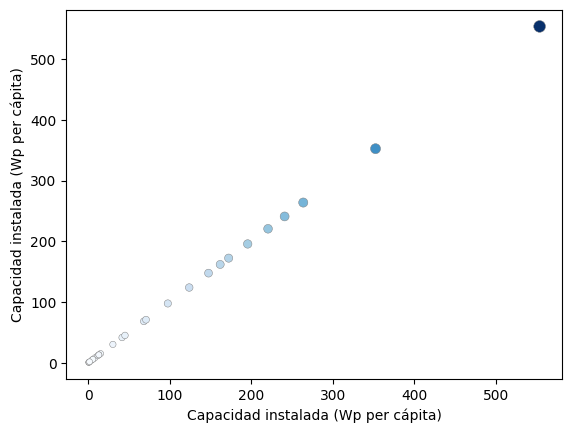

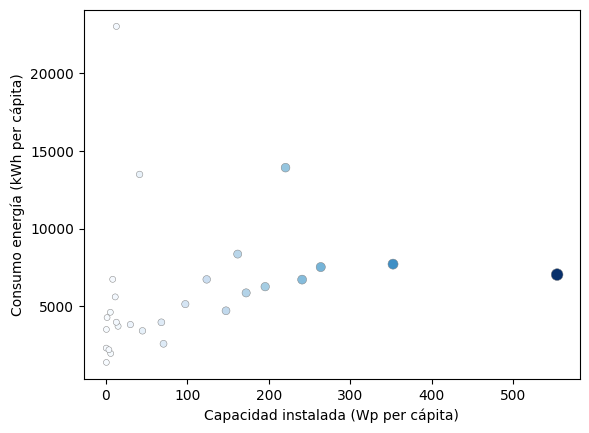

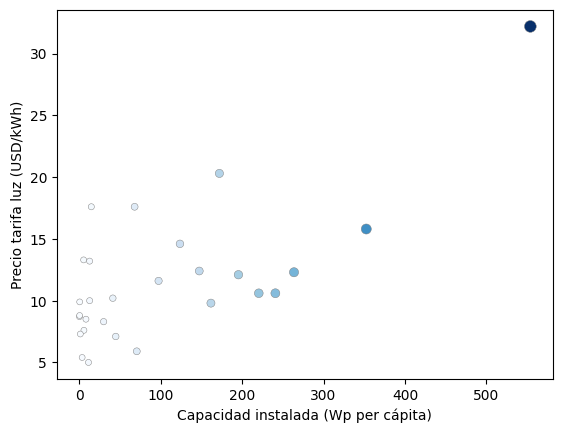

In [101]:
dispersion_4_var(df_eu_coste,"Capacidad instalada (Wp per cápita)","Capacidad instalada (Wp per cápita)", "Capacidad instalada (Wp per cápita)" )

In [102]:
df_eu_coste_si_inversion = df_eu_coste.loc[df_eu_coste["Capacidad instalada (Wp per cápita)"]> df_eu_coste["Capacidad instalada (Wp per cápita)"].mean()]

In [103]:
df_eu_coste_si_inversion

,Unnamed: 0,Población (hab),Área país (km²),Desarrollo humano (%),PIB (USD),Precipitación media (mm),Irradiancia global horizontal (kWh/m²/día),Coste construcción (USD/kWh),Capacidad instalada (Wp per cápita),Consumo energía (kWh per cápita),Precio tarifa luz (USD/kWh)
País,,,,,,,,,,,
Austria,3,8847037,82523.0,0.907755,51512.905475,1110.0,3.2138,0.1094,161.749069,8355.841952,9.8
Belgium,6,11422068,30280.0,0.916066,46556.099567,847.0,2.9436,0.1219,352.440556,7709.123078,15.8
Bulgaria,7,7024216,108560.0,0.813006,9272.629304,608.0,3.8729,0.1147,147.432824,4708.927458,12.4
Czech Republic,10,10625695,77220.0,0.887561,23078.573487,0.0,3.0809,0.1167,195.516623,6258.891037,12.1
Denmark,11,5797446,41990.0,0.929474,60726.466535,703.0,2.7671,0.1252,172.144769,5858.801536,20.3
Germany,15,82927922,349360.0,0.936043,48195.579904,700.0,2.9777,0.1119,553.854467,7035.482975,32.2
Luxembourg,25,607728,2430.0,0.903939,114340.498742,934.0,3.0173,0.1202,220.493379,13914.678449,10.6
Netherlands,29,17231017,33690.0,0.930639,53024.059213,778.0,2.8649,0.1241,240.844751,6712.774758,10.6
Slovenia,37,2067372,20142.0,0.896224,26234.022896,1162.0,3.4522,0.1040,123.731965,6727.999302,14.6


In [104]:
df_eu_coste_no_inversion = df_eu_coste.loc[df_eu_coste["Capacidad instalada (Wp per cápita)"]< df_eu_coste["Capacidad instalada (Wp per cápita)"].mean()]

In [105]:
df_eu_coste["Área país (km²)"].max()

np.float64(2699700.0)

In [106]:
df_eu_coste_no_inversion

,Unnamed: 0,Población (hab),Área país (km²),Desarrollo humano (%),PIB (USD),Precipitación media (mm),Irradiancia global horizontal (kWh/m²/día),Coste construcción (USD/kWh),Capacidad instalada (Wp per cápita),Consumo energía (kWh per cápita),Precio tarifa luz (USD/kWh)
País,,,,,,,,,,,
Albania,0,2866376,27400.0,0.784911,5253.630064,1485.0,4.1954,0.1051,0.348873,2309.366503,8.7
Armenia,2,2951776,28470.0,0.755113,4212.070943,562.0,4.2241,0.1038,5.860878,1961.610395,7.6
Azerbaijan,4,9942334,82670.0,0.756965,4721.178087,447.0,4.0422,0.1116,3.661112,2202.393918,5.4
Croatia,8,4089400,55960.0,0.831102,14869.090682,1113.0,3.7370,0.1176,14.916614,3714.382988,17.6
Estonia,12,1320884,43470.0,0.871042,22927.744417,626.0,2.7161,0.1260,8.327756,6732.367473,8.5
Hungary,17,9768785,90530.0,0.837845,15938.836797,589.0,3.5222,0.1035,68.073972,3965.958233,17.6
Kazakhstan,20,18276499,2699700.0,0.800435,9331.046950,250.0,3.8227,0.1163,11.435451,5600.208465,5.0
Latvia,22,1926542,62180.0,0.847143,18088.927252,667.0,2.7733,0.1252,0.622878,3507.404521,9.9
Lithuania,24,2789533,62642.0,0.858135,19089.707506,656.0,2.8246,0.1241,30.040871,3821.145170,8.3


In [107]:
df_eu_coste.columns

Index(['Unnamed: 0', 'Población (hab)', 'Área país (km²)',
       'Desarrollo humano (%)', 'PIB (USD)', 'Precipitación media (mm)',
       'Irradiancia global horizontal (kWh/m²/día)',
       'Coste construcción (USD/kWh)', 'Capacidad instalada (Wp per cápita)',
       'Consumo energía (kWh per cápita)', 'Precio tarifa luz (USD/kWh)'],
      dtype='object')

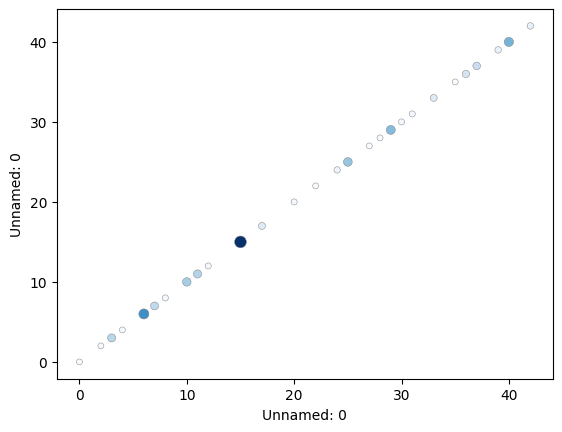

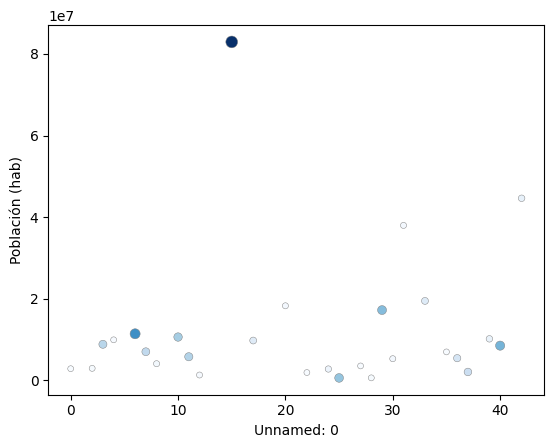

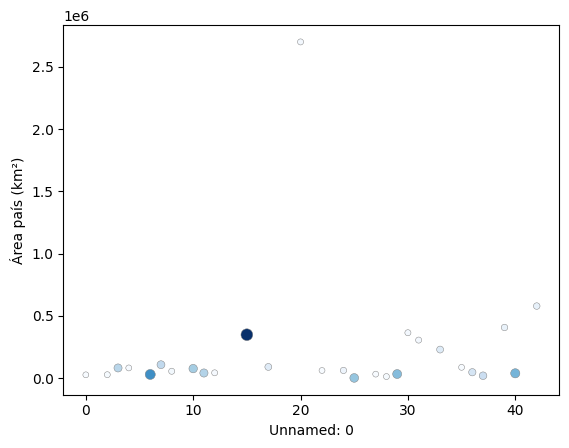

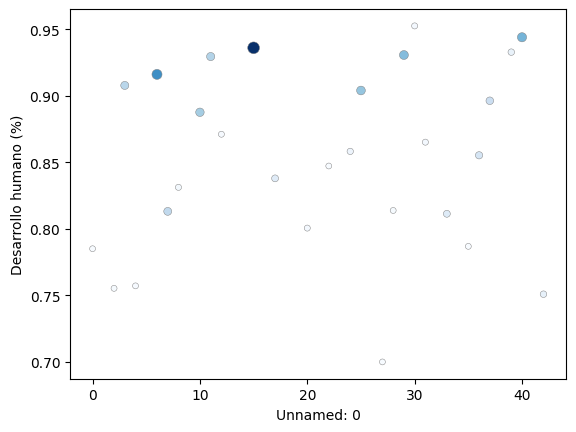

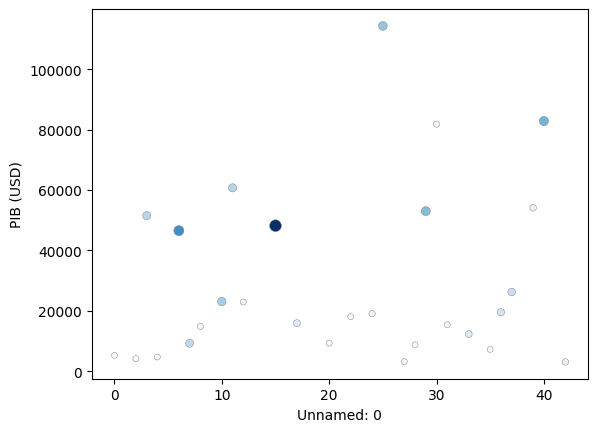

...

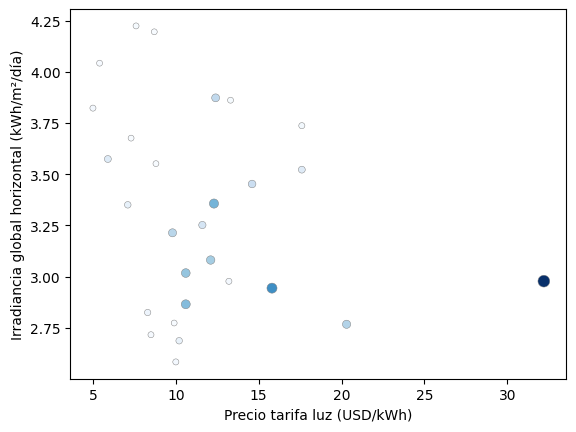

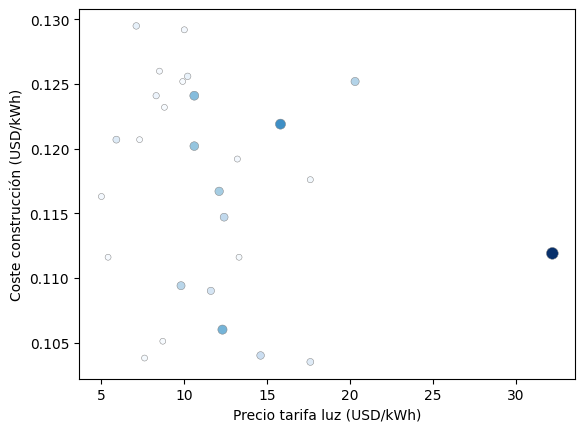

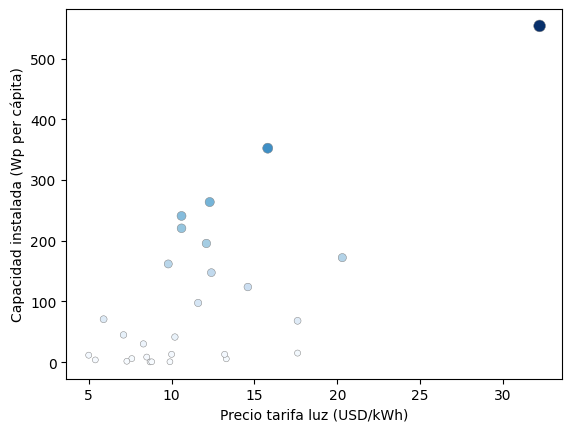

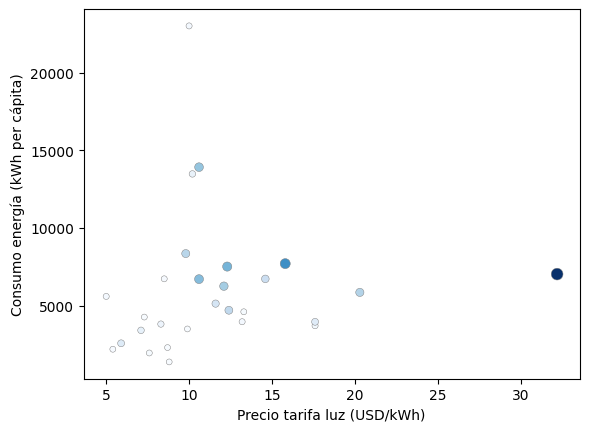

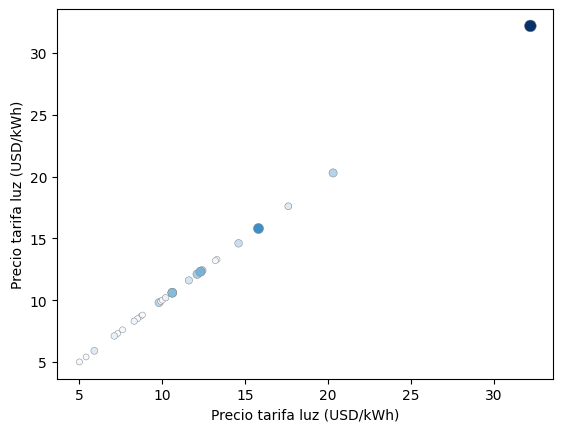

In [108]:
for elemento in df_eu_coste.columns:
    dispersion_4_var(df_eu_coste,elemento,"Capacidad instalada (Wp per cápita)", "Capacidad instalada (Wp per cápita)" )

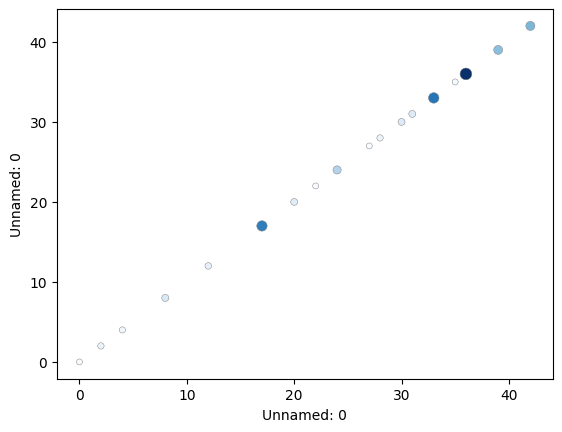

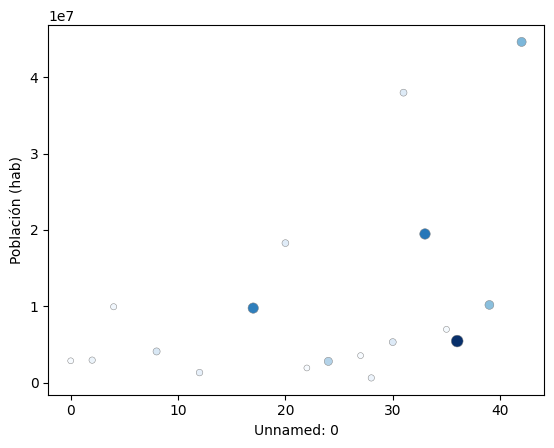

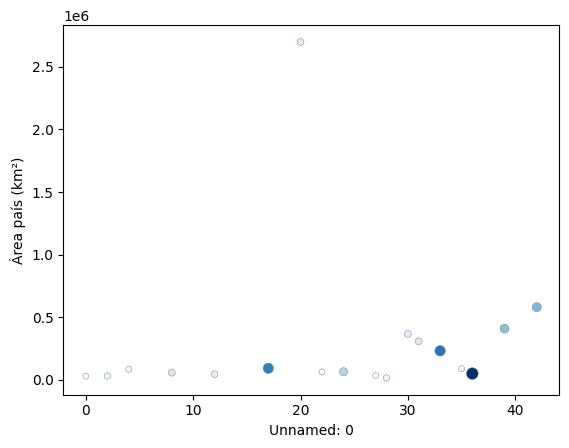

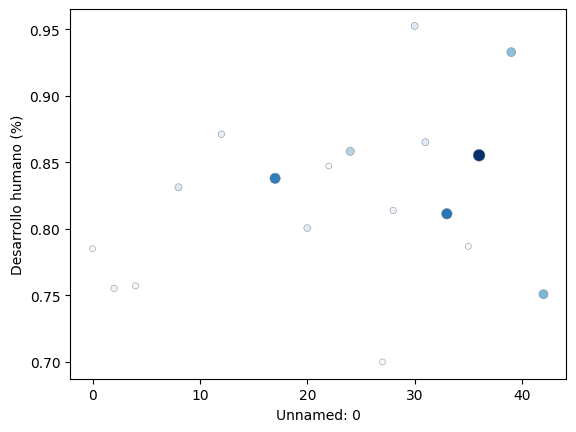

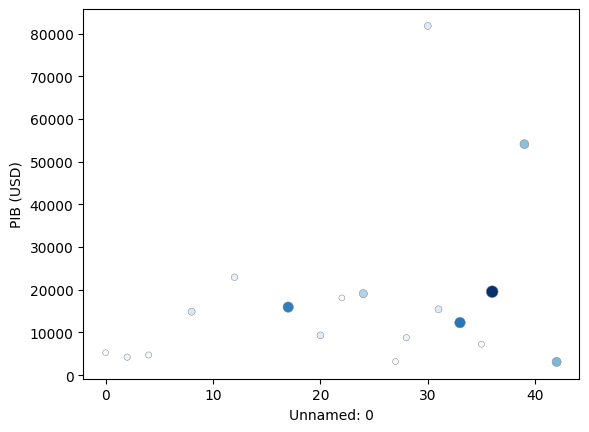

...

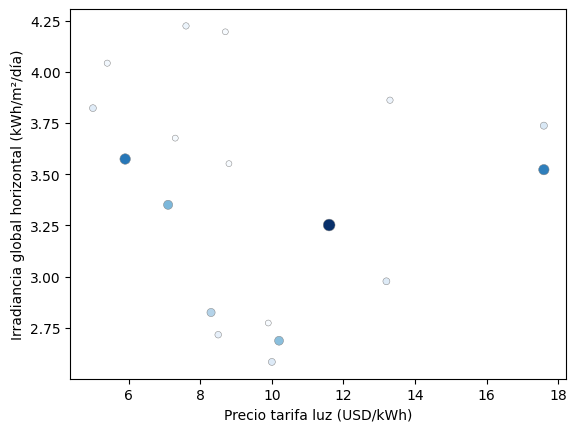

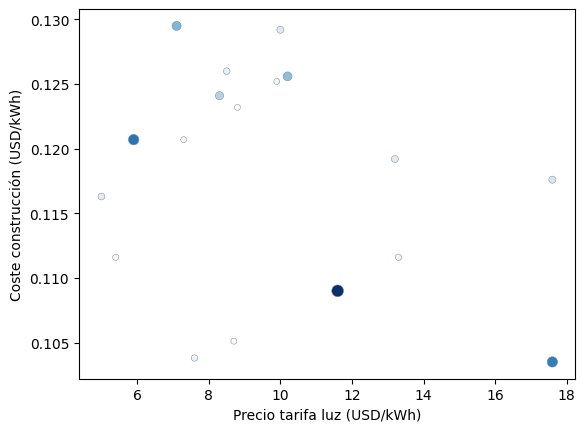

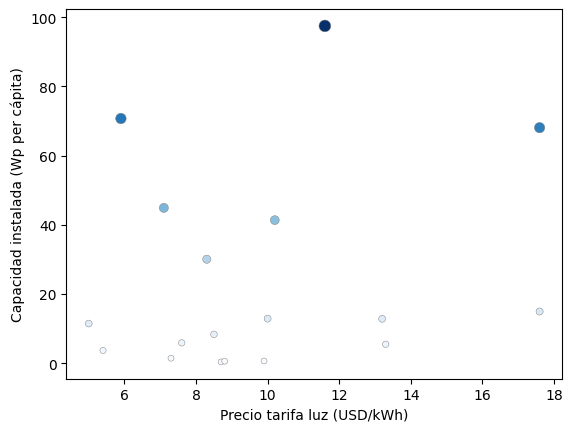

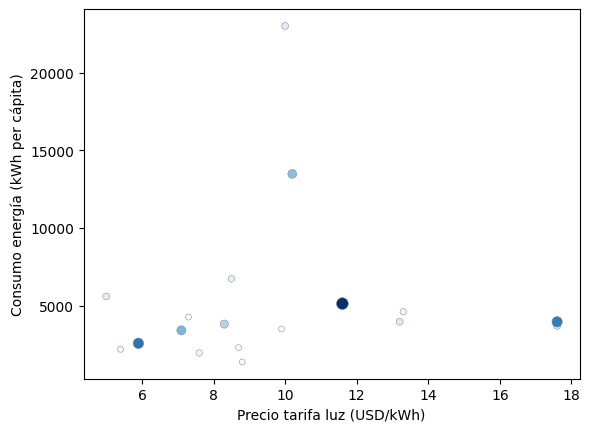

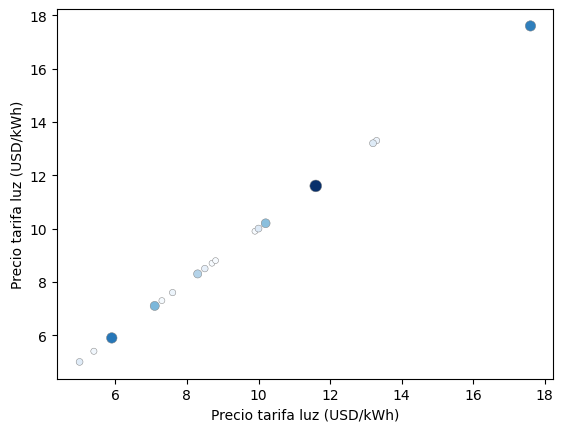

In [109]:
for elemento in df_eu_coste.columns:
    dispersion_4_var(df_eu_coste_no_inversion,elemento,"Capacidad instalada (Wp per cápita)", "Capacidad instalada (Wp per cápita)" )

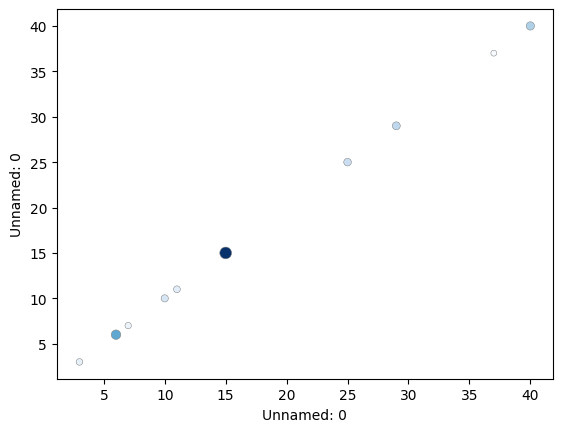

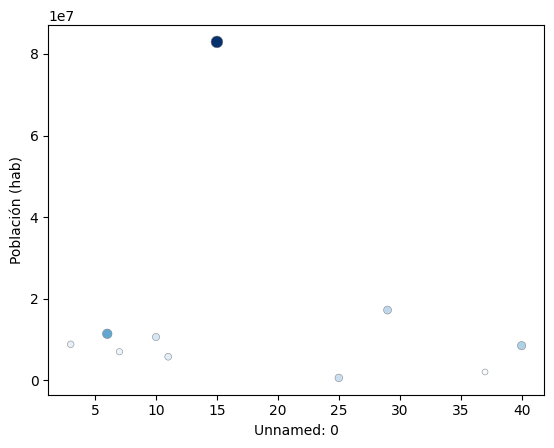

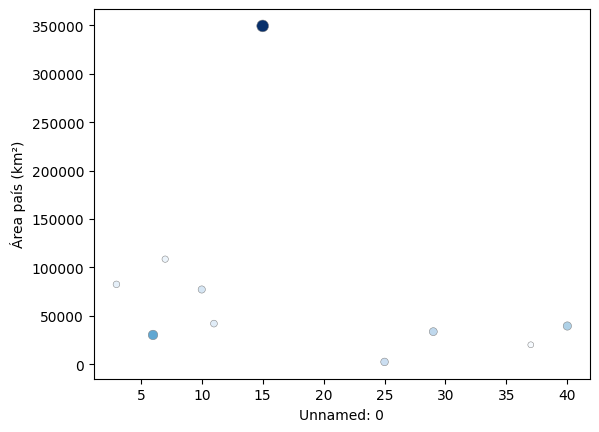

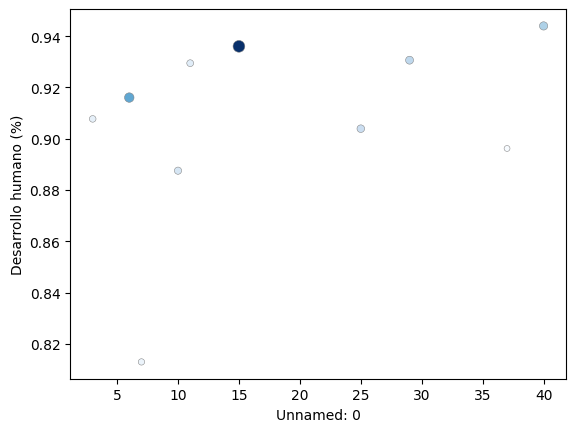

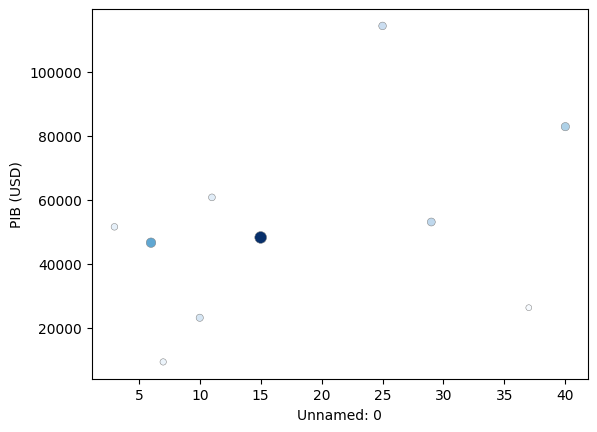

...

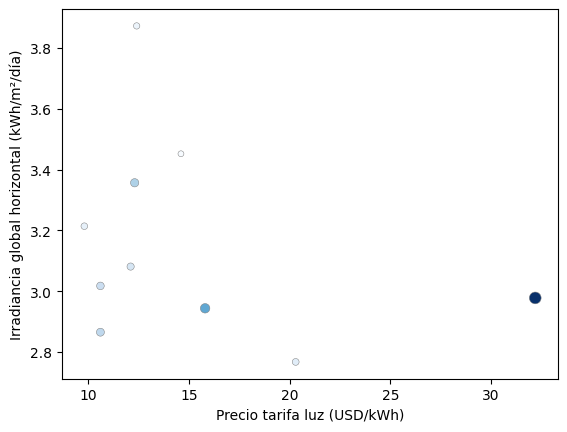

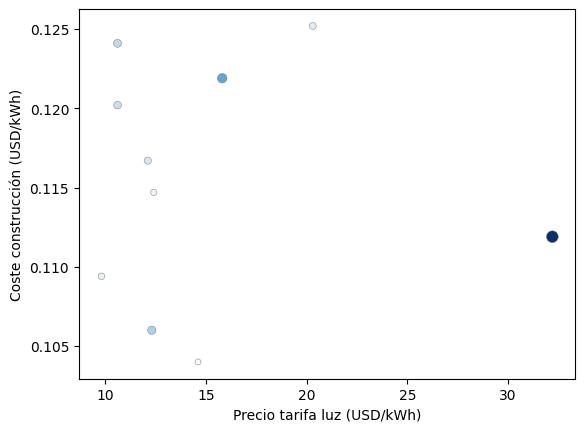

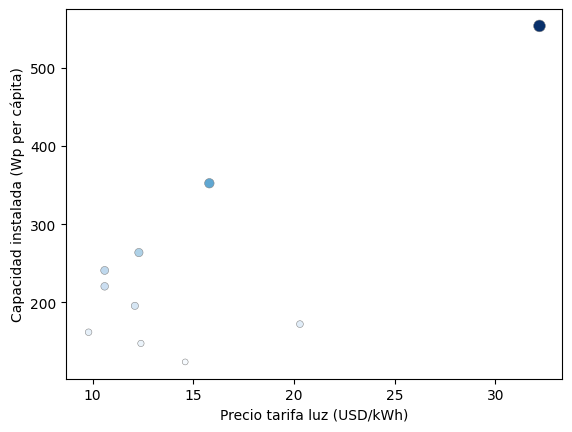

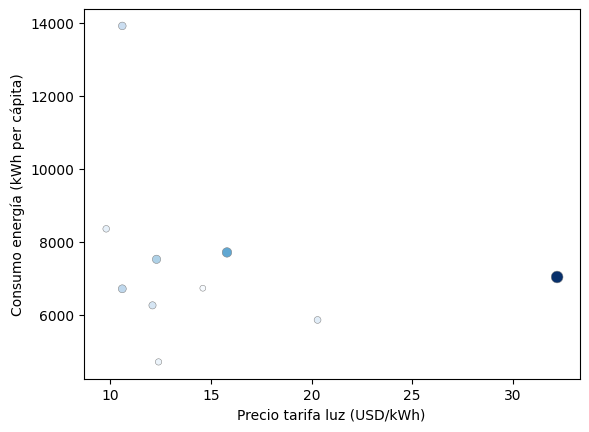

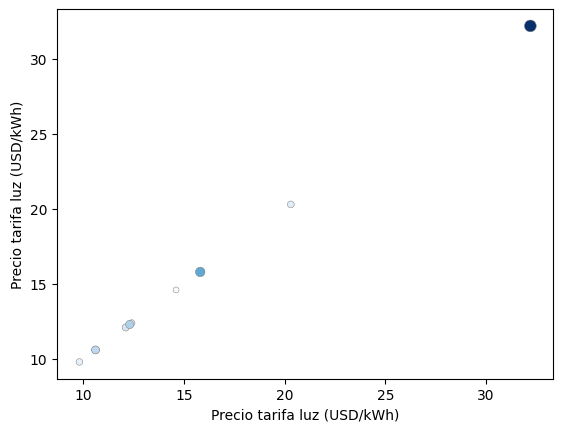

In [110]:
for elemento in df_eu_coste.columns:
    dispersion_4_var(df_eu_coste_si_inversion,elemento,"Capacidad instalada (Wp per cápita)", "Capacidad instalada (Wp per cápita)" )

In [111]:
df_eu_coste_no_inversion_no_index = df_eu_coste_no_inversion.reset_index()
df_eu_coste_no_inversion_no_index = df_eu_coste_no_inversion_no_index.rename(columns={"index" : "País"})
df_eu_coste_si_inversion_no_index = df_eu_coste_si_inversion.reset_index()
df_eu_coste_si_inversion_no_index = df_eu_coste_si_inversion_no_index.rename(columns={"index" : "País"})
df_eu_coste_no_index = df_eu_coste.reset_index()
df_eu_coste_no_index = df_eu_coste_no_index.rename(columns={"index" : "País"})

In [112]:

def mapa_europa_inv(df,dato):
    
    # Cargar el shapefile del mundo
    gdf_mundo = gpd.read_file("./data/ne_110m_admin_0_countries.shp")

    # Renombrar la columna para que coincida
    gdf_mundo.rename(columns={"NAME": "País"}, inplace=True)

    # Filtrar para mantener solo los países de Europa
    gdf_eu = gdf_mundo[gdf_mundo['CONTINENT'] == 'Europe']

    #Comprobar que esté columna pais 
    if 'País' not in df.columns:
        raise ValueError("La columna 'País' no existe en el DataFrame de datos.")

    # Establecer el índice para poder unirlos
    gdf_eu.set_index("País", inplace=True)

    # Unir el GeoDataFrame con el DataFrame de datos
    gdf_eu_final = gdf_eu.join(df.set_index("País"))

    # Filtrar para mantener solo los países presentes en df_eu
    gdf_eu_final = gdf_eu_final[gdf_eu_final.index.isin(df["País"])]

    # Verificar si la columna 'dato' existe en el DataFrame unido
    if dato not in gdf_eu_final.columns:
        raise ValueError(f"La columna '{dato}' no existe en el DataFrame.")
        
    # Crear la visualización
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Dibujar el mapa de Europa con colores basados en 'dato'
    gdf_eu_final.plot(column=dato,
                        ax=ax,
                        legend=True,
                        legend_kwds={'label': dato,
                                     'orientation': "vertical"},
                        cmap ="Blues",
                        edgecolor='grey',
                        linewidth = 0.5)

    # Ajustar los detalles del mapa
    ax.set_title(dato)
    ax.set_xlabel('Longitud')
    ax.set_ylabel('Latitud')

    # Mostrar el mapa

    return plt.show()

mapa_europa_inv(df_eu_coste_no_inversion,"PIB (USD)")

ValueError: La columna 'País' no existe en el DataFrame de datos.

In [ ]:
df_eu_coste_si_inversion_no_index.columns

Index(['País', 'País', 'Unnamed: 0', 'Población (hab)', 'Área país (km²)',
       'Desarrollo humano (%)', 'PIB (USD)', 'Precipitación media (mm)',
       'Irradiancia global horizontal (kWh/m²/día)',
       'Coste construcción (USD/kWh)', 'Capacidad instalada (Wp per cápita)',
       'Consumo energía (kWh per cápita)', 'Precio tarifa luz (USD/kWh)'],
      dtype='object')

IndexError: index 0 is out of bounds for axis 0 with size 0

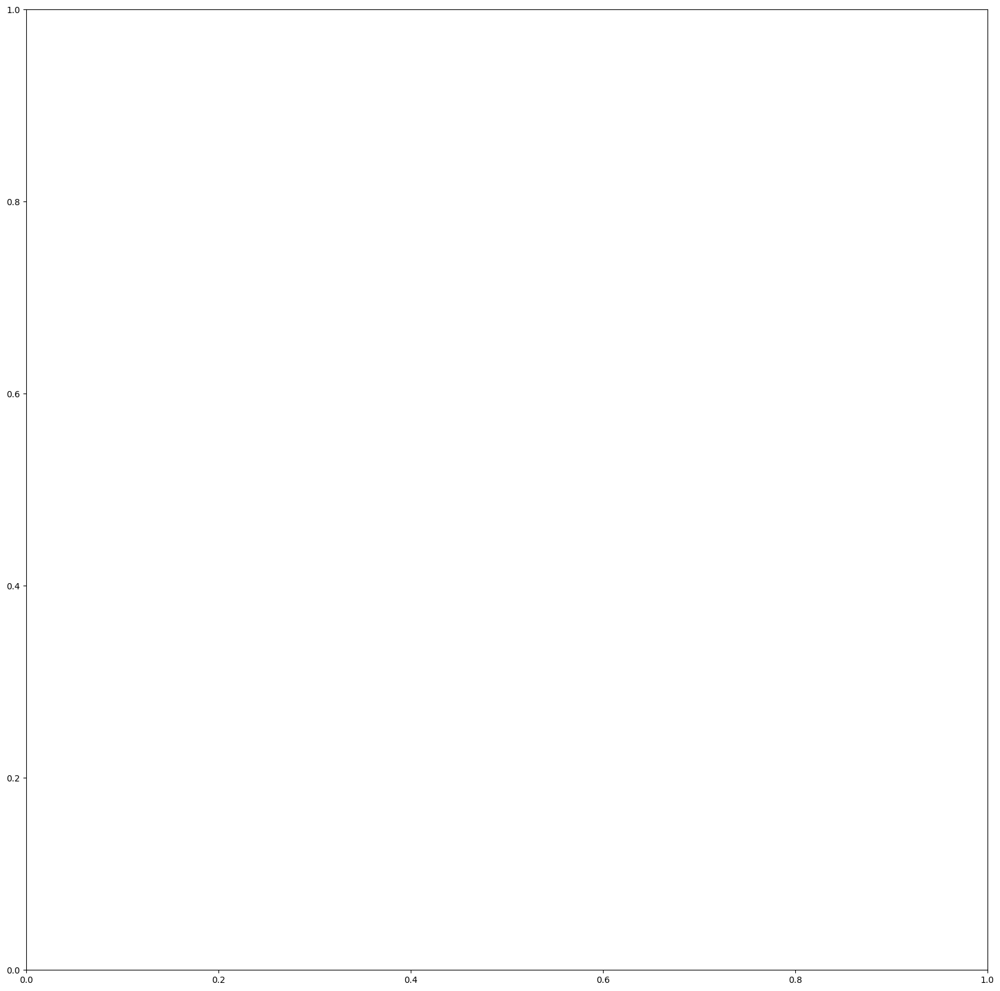

In [ ]:
for elemento in df_eu_coste_no_inversion.columns:
    mapa_europa_inv(df_eu_coste_no_inversion,elemento)

7. Concluye con tu análisis si estabas o no en lo cierto acerca de tu planteamiento y tu hipótesis.

8. (Bonus track). Crea un dashboard para representar tu análisis exploratorio.

9. Documenta tu proyecto y súbelo a GitHub.